# Grundlagen Bild- und Signalverarbeitung

# Minichallenge Teil 2

# 3 Mustersuche in Bild und Signal LE3

# んにちは！ 日本へようこそ

Hallo! Wilkommen in Japan.

## 3.0 Einleitung

Wir befinden uns noch immer in Japan. Japan ist ein Inselstaat, der im Wesentlichen aus einer Inselkette besteht, die sich entlang der Ostküste Asiens erstreckt. Das Land ist bekannt für ihre ausgezeichnete Kulinarik (Sushi, Ramen etc.) oder für ihre fortschrittliche Techniken (Züge, Toiletten etc.) sowie ihre exotische Kultur (Anime, Mangas Etc.) bekannt. Aus diesen Gründen, finde ich dieses Land so spannend und habe mich für die GBSV Minichallenge für Japan entschieden.

## 3.1 Korrelation in Signalen

*Aufgabenstellung: Suche 1 1D Signal, welches wiederkehrende Muster enthält. Analyisere dann mittels Auto-Korrelation die wiederkehrenden Muster innerhalb deines 1D Signals. Kann die Periodizität deines Musters via Auto-Korrelogramm sichtbar gemacht werden? Diskutiere deine Methoden- und Parameterwahl sowie die Resultate in ca. 150 Wörtern.
Schneide nun ein Stück deines Signals aus und versuche es via Kreuzkorrelation im Ursprungssignal zu finden. Woran erkennst du, dass die Stelle passt? Beschreibe in 1-2 Sätzen. Verändere nun dein ausgeschnittenes Stück etwas und schaue, ob es immer noch via Kreuzkorrelation gefunden werden kann. Welche Arten von Veränderungen werden toleriert? Welche nicht? Diskutiere die Resultate in ca. 150 Wörtern.*

### 3.1.1 Wahl des Signals

Um ein geeignetes Datenbeispiel zu finden um die Periodizität mittels Autokorrelation zu demonstrieren bitetet es sich an Klima oder Temperaturdaten zu verwenden. Die Temperatur an den meisten Orten ändert sich über das Jahr hinweg periodisch in Zyklen. Im Winter ist sie tief und im Sommer ist sie meistens hoch. Dies ist also ein gutes Beispiel für diese Aufgabe, weshalb ich mich für den Datensatz Japanese_City_Temps.csv entschieden habe.

#### 3.1.1.1 Szenario:

Wir wollen einen Ausflug nach Osaka, der dritt grössten Stadt von Japan machen. Osaka ist eine große Hafenstadt und ein Wirtschaftszentrum auf der japanischen Insel Honshu. Sie ist für ihre moderne Architektur, das Nachtleben und ihre vielfältigen Imbissstände bekannt.
*Quelle: https://de.wikipedia.org/wiki/Osaka*

Um uns ein besseres Bild über das Klima in Osaka zu verschaffen, nehmen wir den Datensatz "Japanese_City_Temps.csv". Darin sind die täglichen Temperaturen von 1955 - 2020 gespeichert für einige Japanische Städte gespeichert. Wir wollen nun nur die Stadt Osaka anschauen, da dies unser nächstes Ausflugsziel ist. Ich habe mich dazu entschieden nur die Daten von 2000 - 2020 zu verwenden, da man die Periodität in dem Plot sonst nur schwer erkennen würde und da 20 Jahre ausreichen um das Experiment durchzuführen.

In [1]:
import cv2 as cv
from enum import Enum
from ipywidgets import interact, widgets
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from skimage import morphology
from scipy import signal
from scipy import datasets
import statsmodels.api as sm
import statsmodels 
from PIL import Image
from skimage import measure
from math import sqrt
import matplotlib.patches as mpatches
from skimage.measure import regionprops
from skimage.color import label2rgb

In [2]:
data = pd.read_csv('Japanese_City_Temps.csv')

# Display the first few rows of the dataset to understand its structure
data.head()

,Date,Wakkanai,Kitamiesashi,Haboro,Omu,Rumoi,Asahikawa,Abashiri,Otaru,Sapporo,...,Ishigakijima,Miyakojima,Kumejima,Naha,Nago,Okinoerabu,Minamidaito,Torishima,Chichijima,Minamitori.I
0,1955-01-01,-4.7,-5.3,-3.9,-5.5,-2.2,-6.2,-5.5,-3.9,-5.4,...,23.1,21.8,NaN,18.4,NaN,NaN,19.8,NaN,NaN,20.4
1,1955-01-02,-6.9,-6.7,-9.5,-7.4,-8.4,-10.0,-7.4,-5.9,-8.5,...,19.1,18.4,NaN,16.6,NaN,NaN,18.7,NaN,NaN,21.2
2,1955-01-03,-7.7,-10.3,-9.1,-9.3,-9.0,-15.1,-8.4,-5.6,-8.1,...,18.0,17.5,NaN,15.6,NaN,NaN,17.5,NaN,NaN,22.7
3,1955-01-04,-6.7,-8.2,-8.1,-9.2,-8.0,-12.6,-8.8,-5.5,-7.4,...,21.5,20.5,NaN,17.8,NaN,NaN,16.9,NaN,NaN,21.8
4,1955-01-05,-6.9,-7.1,-6.1,-6.6,-7.0,-8.9,-6.1,-4.3,-5.5,...,15.8,16.0,NaN,16.4,NaN,NaN,20.0,NaN,NaN,20.4


In dem Dataframe sehen wir die verschiedenen Temperaturen von ca. 170 japanischen Städten. Ich habe mich für diesen Temperaturen Datensatz entschieden, da man anhand von Temperaturen ein klar wiederkehrendes Muster sehen kann, dank den Saisonalitäten. (Sommer-Winder)

In [3]:
# Convert 'Date' column to datetime format
data['Date'] = pd.to_datetime(data['Date'])

# Filter the data for Osaka between 2000 and 2020
filtered_data = data[(data['Date'] >= '2000-01-01') & (data['Date'] <= '2020-12-31')]

# Set 'Date' as index and select 'Osaka' column to keep it as a pandas Series
osaka_temp = filtered_data.set_index('Date')['Osaka']

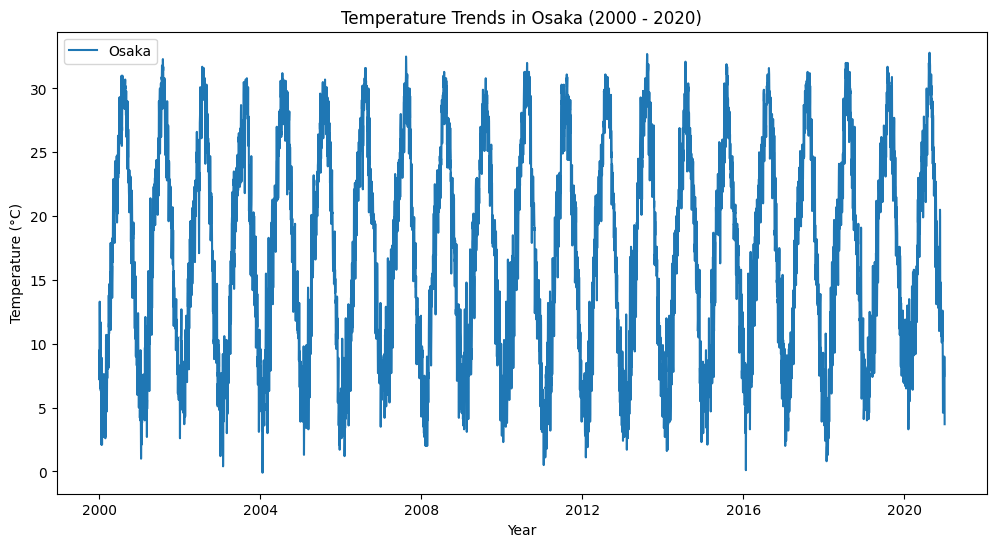

In [4]:
# Konvertieren der 'Date'-Spalte in das Datetime-Format
data['Date'] = pd.to_datetime(data['Date'])

# Filtern der Daten für Osaka von 2000 bis 2020
osaka_temp = data[(data['Date'] >= '2000-01-01') & (data['Date'] <= '2020-12-31')]['Osaka']

# Setzen des Datums als Index
osaka_temp.index = data[(data['Date'] >= '2000-01-01') & (data['Date'] <= '2020-12-31')]['Date']

# Plotten der Temperaturdaten für Osaka von 2000 bis 2020
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp.index, osaka_temp, label='Osaka')
plt.title('Temperature Trends in Osaka (2000 - 2020)')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

#### Erkenntnisse im Plot:
In der Grafik sieht man den Temperatur-Trend von den Jahren 2000 - 2022. Man erkennt saisonale Schwankungen. Beispielsweise sind die Temperaturen jeweils im Sommer hoch und im Winter tief, was ja auch zu erwarten ist. Langzeitveränderungen in der Temperatur ist nicht von blossem Auge zu erkennen, ob beispielsweise das durchschnitts Klima wärmer oder kälter geworden ist in den 20 Jahren.

### 3.1.2 Was ist Auto-Korrelation?
Auto-korrelation ist die Korrelation zwischen zwei Werten in einem Signal. Zum Beispiel kann die Korrelation eines Signals mit sich selbst analysiert werden. Die lineare Beziehung wird zwischen verzögerten Werten einer Reihe y gemessen, um mögliche Beziehungen zu finden.

Im Kontext der Berechnung von Korrelationen ist ein Lag (Verzögerung) ein fester Zeitraum, um den ein Signal verschoben wird. Diese Verschiebung eines Musters, als lagged (verzögert) bezeichnet, bedeutet im Wesentlichen, das Signal um eine bestimmte Anzahl von Zeitschritten zu verzögern. Dabei kann die Korrelation zwischen dem Signal und seinen eigenen vergangenen Werten gemessen werden. Bei der Berechnung der Auto-Korrelation wird der 'Lag' als das Intervall zwischen dem Signal und einer verzögerten Version desselben definiert. Oft wird dieser Prozess für mehrere Lags wiederholt, um ein tieferes Verständnis der zeitlichen Abhängigkeiten innerhalb des Signals zu erhalten.

**[Auto-Correlation-Formula](https://real-statistics.com/time-series-analysis/stochastic-processes/autocorrelation-function/)**

Mittelwert von der Serie $y_1, ..., y_n$:
$$\bar{y} = \frac{1}{n} \sum_{i=1}^{n} y_i $$

Die **auto-kovarianz funktion** am lag $k$, für $k >= 0$, in der Time Series
$$c_k = \frac{1}{n} \sum_{t=k+1}^{n} (y_{t} - \bar{y})(y_{t-k}-\bar{y})$$
Die **auto-kovarianz funktion(ACF)** beim Lag $k$, für $k>=0$, von der Time Series
$$r_k = \frac{c_k}{c_0}$$ 

Eine Autokorrelation von **+1** bedeutet eine perfekte positive Korrelaton und **-1** eine perfekte negative Korrelation.  

*Quelle: Deep Dive 2 GBSV*

#### 3.1.2.1 Autokorrelation für Osaka Temperaturdaten

#### Ziel des Experiments: 
Ziel in diesem Experiment ist es zu erkennen, ob in den Temperaturdaten wiederkehrende Muster wie Trends oder Saisonalität zu erkennen sind. Dies kann man mit der Autokorrelation gut prüfen, da sie das Signal mit sich selbst vergleicht und wir somit (hoffentlich) ein Muster in den Daten erkennen können.

Für den ersten Schritt verwende ich die 20 Jahre zwischen 2000 und 2020. Die Lags setze ich auf die komplette Länge (20Jahre) um die Veränderungen über die gesammte Zeit zu beobachten.

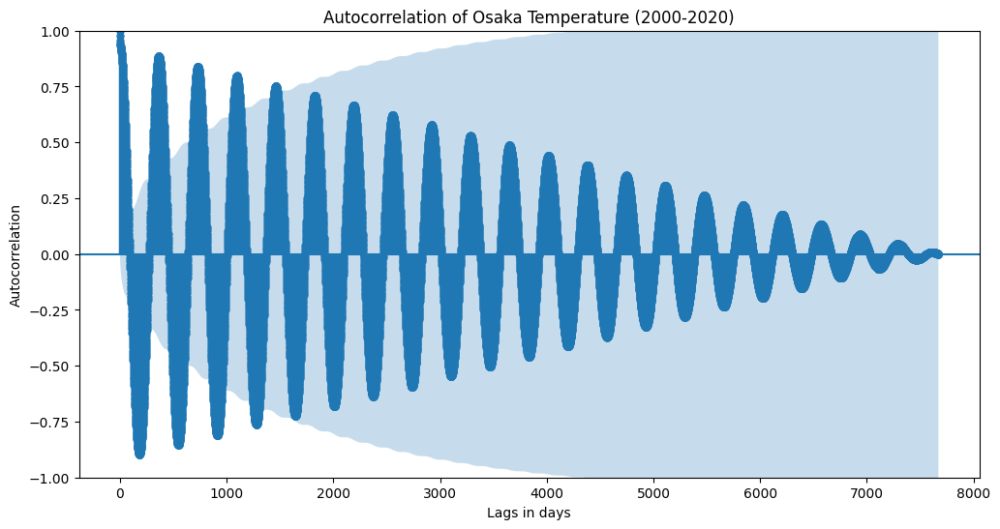

In [5]:
# lags setzen
lags = len(osaka_temp)-1

fig, ax = plt.subplots(figsize=(12, 6))
sm.graphics.tsa.plot_acf(osaka_temp, lags=lags, ax=ax)

# Einstellen der Beschriftungen und Titel
ax.set_xlabel("Lags in days")
ax.set_ylabel("Autocorrelation")
ax.set_title("Autocorrelation of Osaka Temperature (2000-2020)")

plt.show()

#### Erkentnisse im Plot: 
In dem Autokorrelogram sehen wir ein wiederkehrendes Muster. Dies lässt sich auf die Jahreszeiten zurück führen.
 Leider sehen wir das in diesem Plot nicht so gut, da wir die kompletten 20 Jahre geplottet haben. Daher werde ich nun die Autokorrelation für vier Jahre machen, um die Schwankungen in der Autokorrelation besser aufzuzeigen. Die Korrelation nimmt allerdings mit zunehmenden Lags kontinuierlich ab, was darauf schliessen lässt, dass sich das Klima über die vielen Jahre verändert hat.

 Um die Jahreszeiten gut sichtbar zu machen, habe ich die Lags auf 4 Jahre, also 365 Tage * 4 gesetzt. Auch habe ich die X-Achse so angepasst, dass man nun halbe Jahre erkennen kann.

Auffällig ist, dass das Konfidenzintervall für die Autokorrelationswerte mit zunehmenden Lags immmer grösser wird. Dies bedeutet, dass die Unsicherheit bezüglich der Autokorrelationswerte zunimmt je mehr Lags wir haben.

#### 3.1.2.2 Autokorrelation für vier Jahre Ausschnitt

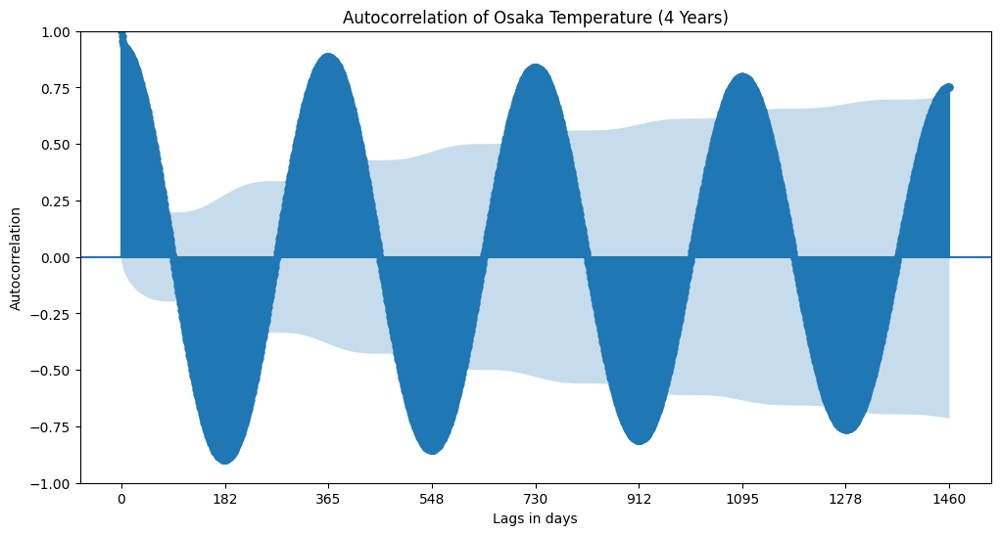

In [6]:
lags_4year = 365 * 4

fig, ax = plt.subplots(figsize=(12, 6))
sm.graphics.tsa.plot_acf(osaka_temp, lags=lags_4year, ax = ax)
plt.xticks(np.arange(0, lags_4year+1, 365/2))
plt.xlabel("Lags in days")  
plt.ylabel("Autocorrelation")
plt.title("Autocorrelation of Osaka Temperature (4 Years)")
plt.show()

### Erkenntnisse im Auto-Korrelogramm

**Lag 0:** Die Autokorrelation bei Lag 0 ist immer 1, da jede Serie bei null Verzögerung perfekt mit sich selbst korreliert.
Ein Lag ist jeweils ein Tag, also sind 365 Lags genau ein Jahr. 

**Periodisches Muster:** Die periodischen Peaks in der Autokorrelation deuten auf ein saisonales Muster hin, da sich die Temperaturen in Osaka jährlich wiederholen. Dies erkennt man an der grossen Korrelation bei den Lags 0, 365, 730, 1095 und 1460. 

**Abnahme der Korrelation:** Das allmähliche abflachen der Korrelationswerte mit zunehmenden Lags zeigt, dass die Temperaturen weniger ähnlich werden, je größer der Zeitabstand wird.

**Kann die Periodizität deines Musters via Auto-Korrelogramm sichtbar gemacht werden?**
Ja, die Periodizität kann klar ersichtlich gemacht werden dank dem Korrelogramm. Die Korrelation nimmt regelmässig zu und ab, wie bereits weiter oben erklärt. 

#### 3.1.2.3 Autokorrelation für 180 Tage Ausschnitt

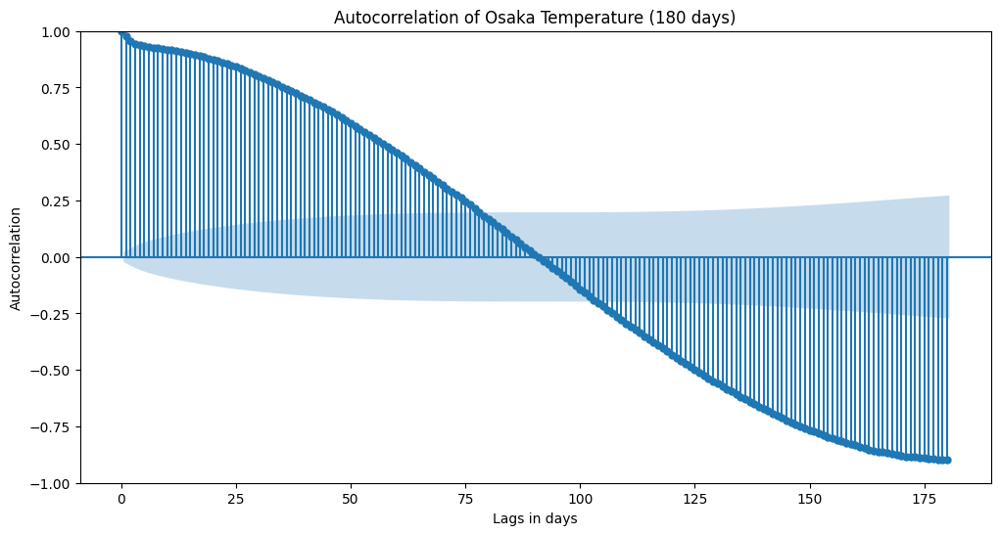

In [7]:
lags_180 = 180

fig, ax = plt.subplots(figsize=(12, 6))
sm.graphics.tsa.plot_acf(osaka_temp, lags=lags_180, ax = ax)
plt.xlabel("Lags in days")  
plt.ylabel("Autocorrelation")
plt.title("Autocorrelation of Osaka Temperature (180 days)")
plt.show()

#### Erkenntnisse im Plot

Hier in dem Plot sehen wir schön die Jahreszeiten, respektive die Periodizität für ein halbes Jahr. Es ist spannend zu sehen, wie die Autokorrelation permanent abnimmt im Verlaufe der 180 Tage. Danach nimmt sie wieder zu, was wir in diesem Plot aber nichtmehr beachten können.

### 3.1.2 Kreuzkorrelation im Signal

Schneide nun ein Stück deines Signals aus und versuche es via Kreuzkorrelation im Ursprungssignal zu finden. Woran erkennst du, dass die Stelle passt? Beschreibe in 1-2 Sätzen. Verändere nun dein ausgeschnittenes Stück etwas und schaue, ob es immer noch via Kreuzkorrelation gefunden werden kann. Welche Arten von Veränderungen werden toleriert? Welche nicht? Diskutiere die Resultate in ca. 150 Wörtern. 

Im Gegensatz zur Autokorrelation, vergleicht die Kreuzkorrelation nicht ein Signal mit sich selber, sondern zwei verschieden Signale miteinander. Ich möchte nun ein Teil der Temperaturdaten herausschneiden und mittels Kreuzkorrelation prüfen, ob ich diesen Ausschnitt im Originalsignal finden kann. 

#### 3.1.2.1 Szenario
Die Zahl 4  wird im Japanischen "shi" ausgesprochen und ist damit phonetisch gleichbedeutend mit dem Wort für **TOD**. 

# 死 (shi)

gilt daher in Japan allgemein als Unglückszahl. Wie in der westlichen Welt mit der 13, wird in Japan die Zahl 4 mit Unglück in Verbindung gebracht. Deswegen gibt es in Japan viele Hotels oder Spitäler, bei denen das vierte Stockwerk fehlt oder auch in Flugzeugen wird auf die Reihe Nr. 4 verzichtet. 

Da ich jedoch nicht abergläubisch bin, habe ich mich dazu entschieden den Ausschnitt vom Signal auf genau VIER Jahre zu setzen. Damit das Signal nicht am Ende oder am Anfang der 20 Jahre liegt, und somit die Kreuzkorrelation eventuell ein leichtes Spiel hat, nehme ich die Jahre 2010 - 2013. Dazu habe ich herausgefunden, dass in diesen vier Jahren 3x der Deutsche Formel 1 Pilot "Sebastian Vettel" den Grossen Preis von Japan gewonnen hat. Eventuell hatte es ja etwas mit den Temperaturen in dem Zeitraum zu tun gehabt. 

#### Ziel des Experiments: 
In dem Experiment der Kreuzkorrelation möchte ich herausfinden, ob ein Ausschnitt von vier Jahren reicht, um das gekürze Signal in dem ursprünglichen Signal wieder zu finden. Falls ja, ab wann reicht es denn nicht mehr aus? Ich werde versuchen ein Ausschnitt von 4 Jahren, 2 Jahern und von 6 Monaten mittels Kreuzkorrelation im Originalsignal zu erkennen. 

Auch möchte ich danach die Robustheit der Kreuzkorrelation testen, in dem ich eine Noise über den 4 Jahres Ausschnitt lege und mittels verschiedenstarker Noise den Ausschnitt im ursprünglichen Signal zu finden. 

Zu guter letzt will ich prüfen, ob ich das Signal noch finden kann, wenn ich einen Rolling Mean über die Daten laufen lasse. Dazu werde ich die 20 Jahre mit einem Rolling Mean von 3, 7, 14 und 30 Tagen glätten.   

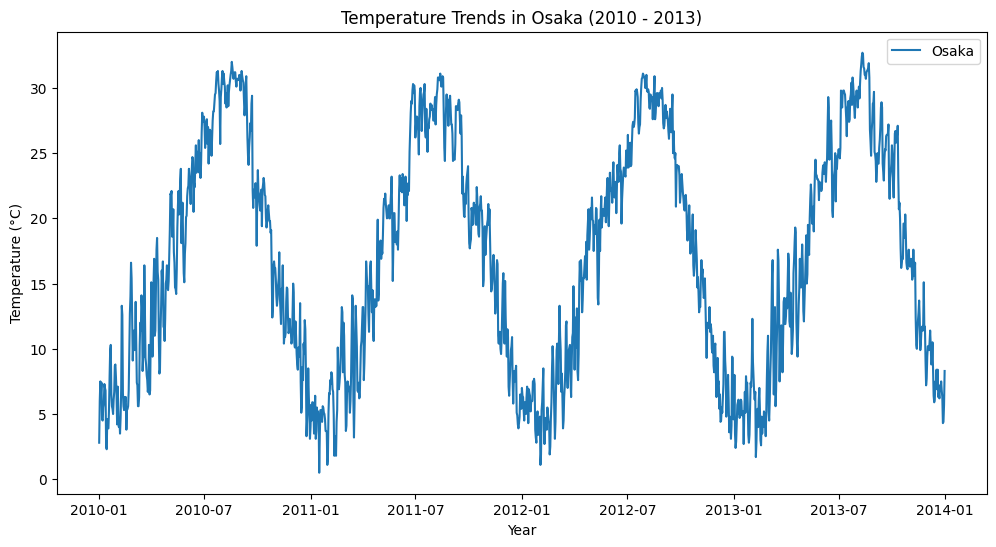

In [8]:
# schneide ein stück (4jahre) des signals aus und versuche via kreuzkorrelation im ursprungssignal zu finden
osaka_temp_4year = osaka_temp['2010-01-01':'2013-12-31']
osaka_temp_4year.index = pd.date_range(start='2010-01-01', end='2013-12-31', freq='D')

# Plotten der Temperaturdaten für Osaka von 2010 bis 2013
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp_4year.index, osaka_temp_4year, label='Osaka')
plt.title('Temperature Trends in Osaka (2010 - 2013)')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

Ich habe das Ursprungssignal so zugeschnitten, dass ich nun vier Jahre (2010-2013) habe, welche ich nun versuchen kann mittels Kreuzkorrelation in dem ursprünglichen Signal zu finden.

In diesem Plot sehen wir schön, wie die Temperatur auf den Sommer hin steigt und auf den Winter wieder fällt. Diese Periodizität haben wir aber auch vorhin schon beobachten können.

In [9]:
cross_corr = signal.correlate(osaka_temp, osaka_temp_4year, mode='valid', method='auto')
index_cor = np.argmax(cross_corr)

#### 3.1.2.2 Wahl der Parameter für die Autokrorrelation:
Hierbei, und für alle folgenden Experimente, habe ich mich dafür entschieden, den **mode:** **"valid"** zu verwenden, da ich nur analysieren möchte, wo das vierjährige Signal vollständig innerhalb des ursprünglichen Signals hinpasst, ohne dabei über die Ränder hinaus zu gehen. Mit der **mode Valid** wird der Index für die Korrelation am Anfang der Korrelation (siehe rote Linie im Plot unten) gesetzt, was es mir vereinfacht zu prüfen, ob die Korrelation am richtigen Ort gefunden wurde.

Bei dem Parameter **method**, habe ich mich für **"auto"** entschieden. Dieser lässt die Funktion die effizienteste Methode zur Berechnung der Korrelation automatisch wählen. Die Auswahl basiert auf den Eigenschaften der Eingabedaten und der Größe der Signale.

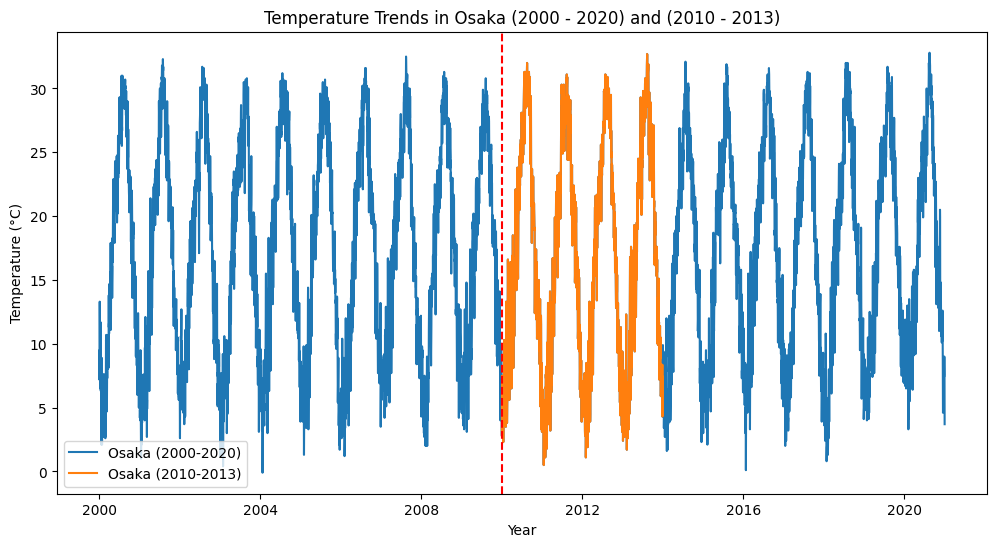

In [10]:
# plot osaka_temp and osaka_temp_4year with the same x-axis
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp.index, osaka_temp, label='Osaka (2000-2020)')
plt.plot(osaka_temp_4year.index, osaka_temp_4year, label='Osaka (2010-2013)')
plt.axvline(x=osaka_temp.index[index_cor], color='r', linestyle='--')
plt.title('Temperature Trends in Osaka (2000 - 2020) and (2010 - 2013)')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

#### Erkenntnisse im Plot: 

Die vier Jahre konnten in dem Ursprünglichen Signal gut gefunden werden. Dies kann daran liegen, dass es ein grosser Ausschnitt (4 Jahre) ist, was es der Kreuzkorrelation vereinfacht, den passenden Zeitausschnitt zu finden. In dem Fall war also wie vermutet, die Zahl **shi**, also vier keine Unglückszahl. ;)

### 3.1.2.3 Kreuzkorrelation mit Ausschnitt von Zwei Jahren

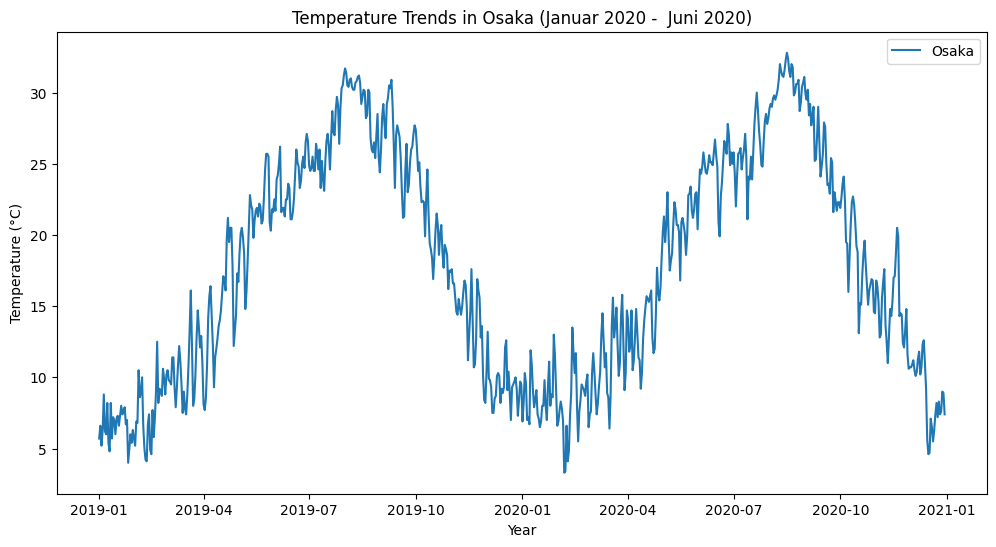

In [11]:
# Halbes Jahr
osaka_temp_two_year = osaka_temp['2019-01-01':'2020-12-30']
osaka_temp_two_year.index = pd.date_range(start='2019-01-01', end='2020-12-30', freq='D')

# Plotten der Temperaturdaten für Osaka von Jan - jun 2020
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp_two_year.index, osaka_temp_two_year, label='Osaka')
plt.title('Temperature Trends in Osaka (Januar 2020 -  Juni 2020)')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

In [12]:
cross_corr = signal.correlate(osaka_temp, osaka_temp_two_year, mode='valid', method='auto')
index_cor = np.argmax(cross_corr)

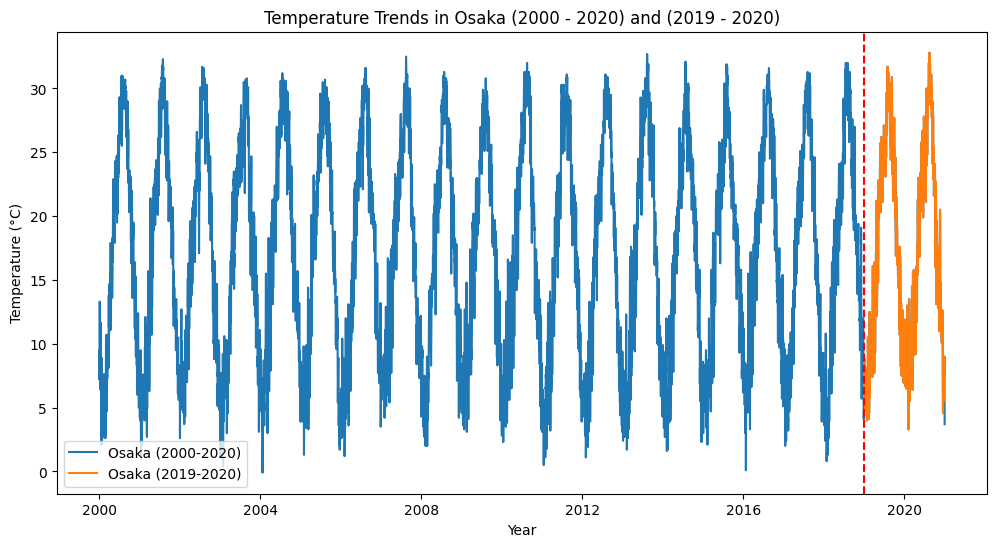

In [13]:
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp.index, osaka_temp, label='Osaka (2000-2020)')
plt.plot(osaka_temp_two_year.index, osaka_temp_two_year, label='Osaka (2019-2020)')
plt.axvline(x=osaka_temp.index[index_cor], color='r', linestyle='--')
plt.title('Temperature Trends in Osaka (2000 - 2020) and (2019 - 2020)')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

#### Erkenntnisse im Plot

Auch mit einem Ausschnitt von zwei Jahren ist es immernoch möglich, den Ausschnitt im Ursprungssignal zu finden. Die rote Linie, welche den Start der höchsten Korrelation anzeigt, stimmt mit dem Zeitpunkt des ausgeschnittenen Signales überein. 

Nun will ich noch prüfen, ob auch ein halbes Jahr an Daten ausreicht für die Kreuzkorrelation. 

#### 3.1.2.4 Kreuzkorrelation mit Ausschnitt von einem halben Jahr

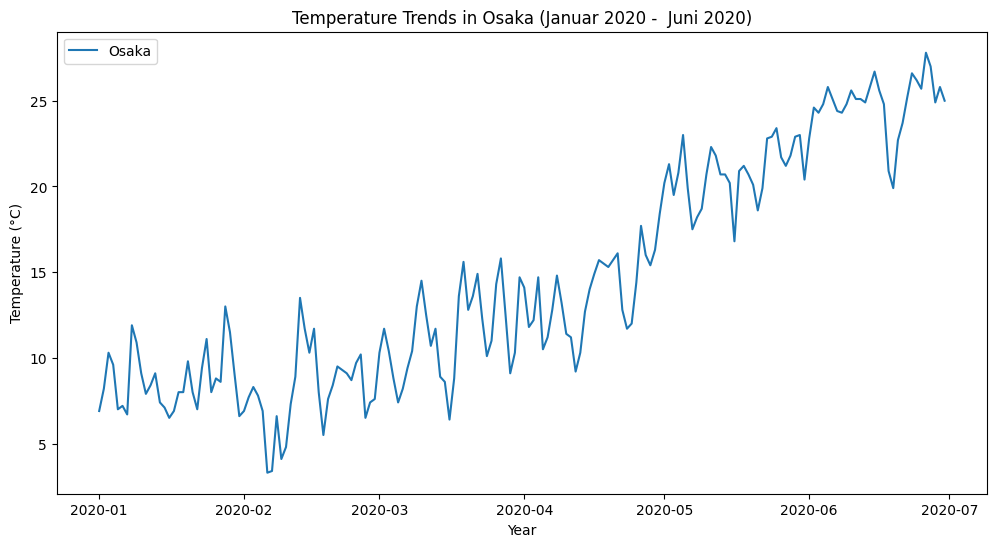

In [14]:
# Halbes Jahr
osaka_temp_halfyear = osaka_temp['2020-01-01':'2020-06-30']
osaka_temp_halfyear.index = pd.date_range(start='2020-01-01', end='2020-06-30', freq='D')

# Plotten der Temperaturdaten für Osaka von Jan - jun 2020
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp_halfyear.index, osaka_temp_halfyear, label='Osaka')
plt.title('Temperature Trends in Osaka (Januar 2020 -  Juni 2020)')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

#### Erkenntnisse im Plot: 

In einem halben Jahr, sieht man keine Periodizität mehr. Die Temperaturen werden über die Zeit immer höher, da wir im Winter anfangen und im Sommer aufhöhren. Jedoch schwanken die Temperaturen von Tag zu Tag stark, auch wenn sie über die Monate im Durschnitt zunimmt. 

In [15]:
cross_corr = signal.correlate(osaka_temp, osaka_temp_halfyear, mode='valid', method='auto')
index_cor = np.argmax(cross_corr)

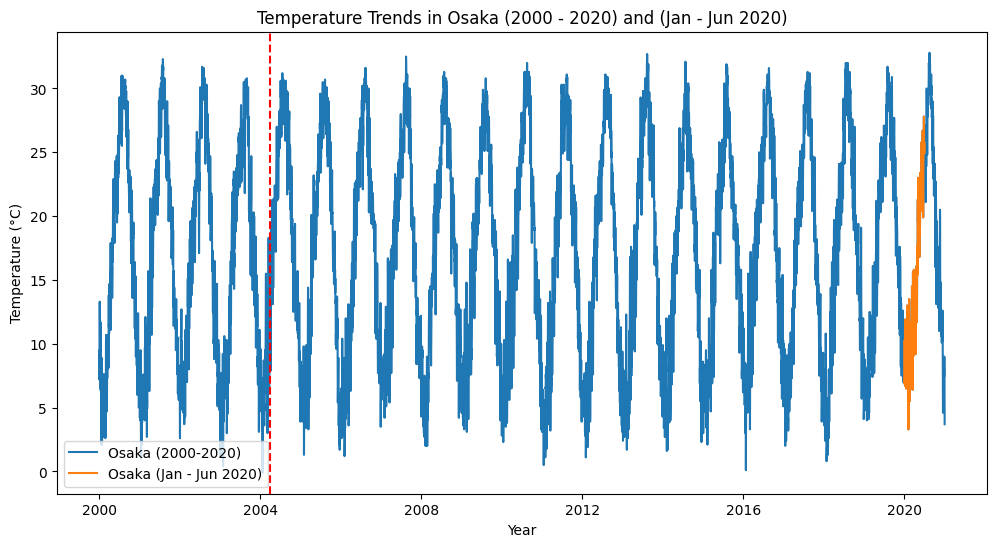

In [16]:
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp.index, osaka_temp, label='Osaka (2000-2020)')
plt.plot(osaka_temp_halfyear.index, osaka_temp_halfyear, label='Osaka (Jan - Jun 2020)')
plt.axvline(x=osaka_temp.index[index_cor], color='r', linestyle='--')
plt.title('Temperature Trends in Osaka (2000 - 2020) and (Jan - Jun 2020)')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

#### Erkenntnisse im Plot

Bei einem Ausschnitt von einem Halben Jahr, war es mir leider nicht mehr möglich den Ausschnitt im Originalsignal zu finden. Dies bedeutet, dass die Dauer von dem Ausschnitt mindestens irgendwo zwischen 0.5 und 2 Jahren liegen um es im Ursprungssignal wieder zu finden.


#### Weshalb findet die Kreuzkorrelation das kurze Signal nicht?

Dafür kann es mehrere Gründe haben, ein paar möchte ich hier gerne auflisten. 

1. Informationsgehalt: Ein kurzes Signal hat weniger Datenpunkte und somit weniger charakteristische Informatinen, welche eine eindeutige Identifizierung im längeren Signal verschweren. 

2. Periodizität fehlt: Das längere Signal weist eine eindeutige Periodizität auf über den Verlauf der Jahre. Dies ist bei 6 Monaten leider nicht der Fall, was eine zuverlässige Korrelation nicht möglich macht. 

3. Variabilität: Das kurze Signal ist anfälliger für Rauschen und andere Störungen im Signal. 

### 3.1.3 Robustheit der Kreuzkorrelation testen


Um zu prüfen, ob die Kreuzkorrelation wirklich robust ist, baue ich eine noise ins Signal ein um zu prüfen, ob es danach den Ausschnitt immernoch finden kann.

In einem zweiten Experiment verwende ich einen Rolling Mean für die Originaldaten. Ich werde die Daten mit einem Mittelwert aus 3, 7, 14 und 30 Tagen smoothen und dann versuchen, das herausgeschnittene Sampel in den gesmoothten Daten zu finden.

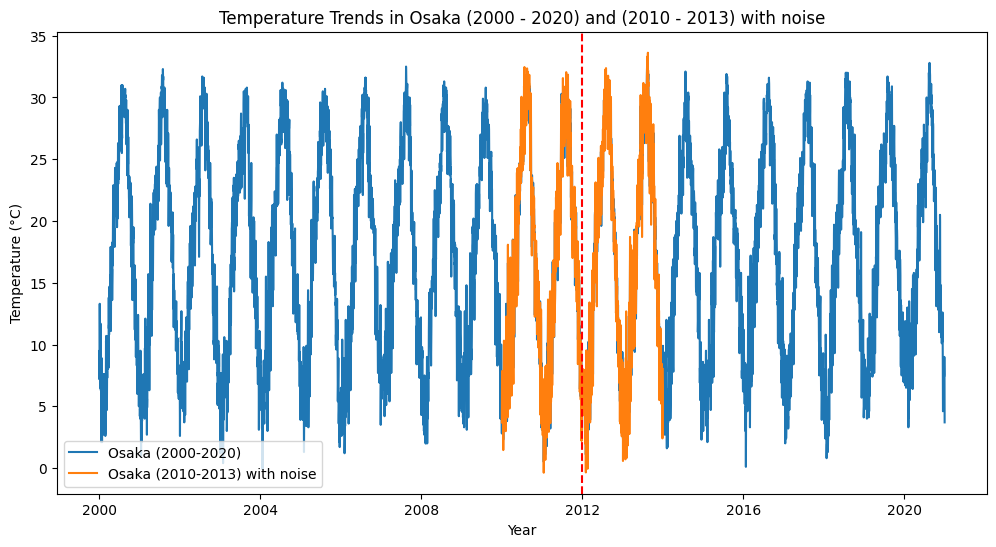

In [17]:
# random seed
np.random.seed(20)

# add noise to osaka_temp_4year
noise = np.random.normal(0, 1, len(osaka_temp_4year))
osaka_temp_4year_noisy = osaka_temp_4year + noise

cross_corr = signal.correlate(osaka_temp, osaka_temp_4year_noisy, mode='same', method='auto')
index_cor = np.argmax(cross_corr)

# plot osaka_temp and osaka_temp_4year with the same x-axis
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp.index, osaka_temp, label='Osaka (2000-2020)')
plt.plot(osaka_temp_4year.index, osaka_temp_4year_noisy, label='Osaka (2010-2013) with noise')
plt.axvline(x=osaka_temp.index[index_cor], color='r', linestyle='--')
plt.title('Temperature Trends in Osaka (2000 - 2020) and (2010 - 2013) with noise')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

#### 3.1.3.1 mean = 0, std abw = 10

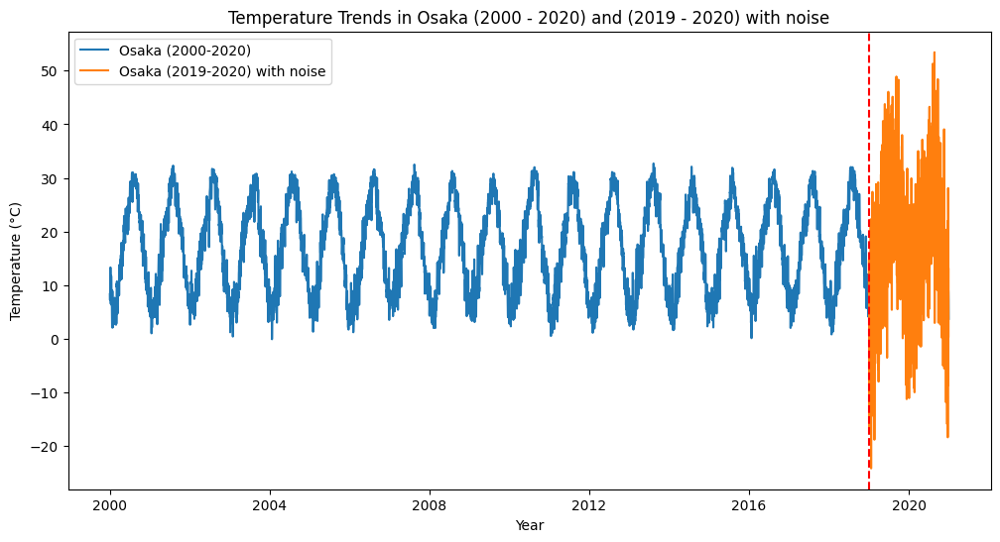

In [18]:
# random seed
np.random.seed(20)

# Angenommen, osaka_temp und osaka_temp_two_year sind definiert und haben dieselbe Länge
noise_0_10 = np.random.normal(0, 10, len(osaka_temp_two_year))
osaka_temp_two_year_noisy_0_10 = osaka_temp_two_year + noise_0_10

# Berechne die Kreuzkorrelation
cross_corr_0_10 = signal.correlate(osaka_temp, osaka_temp_two_year_noisy_0_10, mode='valid', method='auto')

# Finde den Index des maximalen Werts der Kreuzkorrelation
index_cor_0_10 = np.argmax(cross_corr_0_10)

# Plotte osaka_temp und osaka_temp_two_year_noisy mit demselben x-Achsenwert
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp.index, osaka_temp, label='Osaka (2000-2020)')
plt.plot(osaka_temp_two_year_noisy_0_10.index, osaka_temp_two_year_noisy_0_10, label='Osaka (2019-2020) with noise')
plt.axvline(x=osaka_temp.index[index_cor_0_10], color='r', linestyle='--')
plt.title('Temperature Trends in Osaka (2000 - 2020) and (2019 - 2020) with noise')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

#### 3.1.3.2 mean = 1, std abw = 20

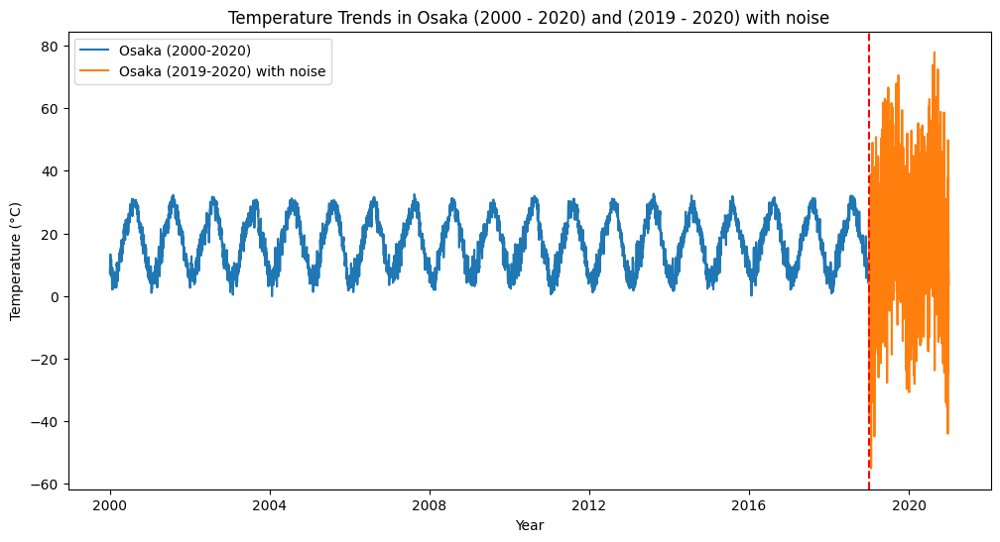

In [19]:
# random seed
np.random.seed(20)

# Angenommen, osaka_temp und osaka_temp_two_year sind definiert und haben dieselbe Länge
noise_1_20 = np.random.normal(1, 20, len(osaka_temp_two_year))
osaka_temp_two_year_noisy_1_20 = osaka_temp_two_year + noise_1_20

# Berechne die Kreuzkorrelation
cross_corr_1_20 = signal.correlate(osaka_temp, osaka_temp_two_year_noisy_1_20, mode='valid', method='auto')

# Finde den Index des maximalen Werts der Kreuzkorrelation
index_cor_1_20 = np.argmax(cross_corr_1_20)

# Plotte osaka_temp und osaka_temp_two_year_noisy mit demselben x-Achsenwert
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp.index, osaka_temp, label='Osaka (2000-2020)')
plt.plot(osaka_temp_two_year_noisy_1_20.index, osaka_temp_two_year_noisy_1_20, label='Osaka (2019-2020) with noise')
plt.axvline(x=osaka_temp.index[index_cor_1_20], color='r', linestyle='--')
plt.title('Temperature Trends in Osaka (2000 - 2020) and (2019 - 2020) with noise')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

#### 3.1.3.3 mean = 10, std abw = 70

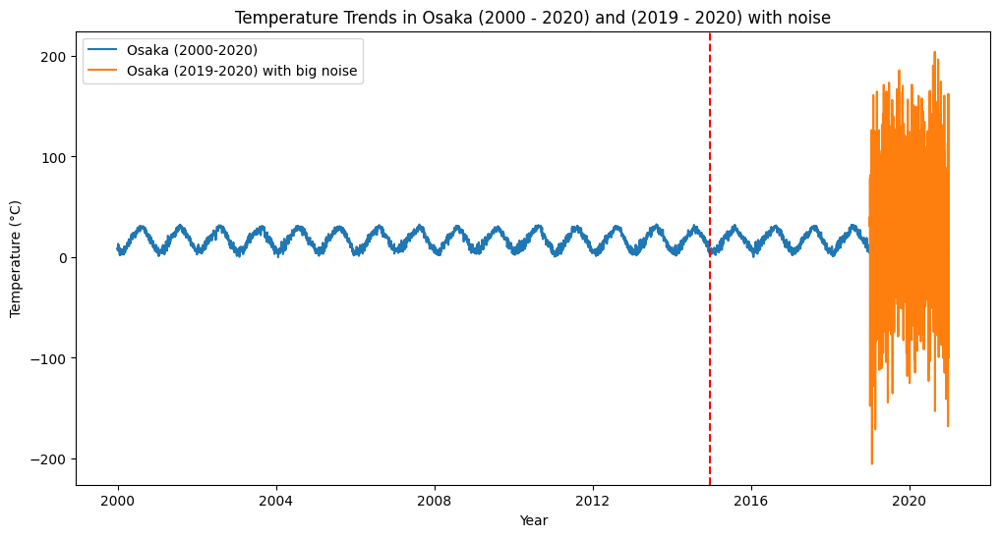

In [20]:
# random seed
np.random.seed(20)

# Angenommen, osaka_temp und osaka_temp_two_year sind definiert und haben dieselbe Länge
noise_3_20  = np.random.normal(10, 70, len(osaka_temp_two_year))
osaka_temp_two_year_noisy_3_20 = osaka_temp_two_year + noise_3_20

# Berechne die Kreuzkorrelation
cross_corr_3_20 = signal.correlate(osaka_temp, osaka_temp_two_year_noisy_3_20, mode='valid', method='auto')

# Finde den Index des maximalen Werts der Kreuzkorrelation
index_cor_3_20 = np.argmax(cross_corr_3_20)

# Plotte osaka_temp und osaka_temp_two_year_noisy mit demselben x-Achsenwert
plt.figure(figsize=(12, 6))
plt.plot(osaka_temp.index, osaka_temp, label='Osaka (2000-2020)')
plt.plot(osaka_temp_two_year_noisy_3_20.index, osaka_temp_two_year_noisy_3_20, label='Osaka (2019-2020) with big noise')
plt.axvline(x=osaka_temp.index[index_cor_3_20], color='r', linestyle='--')
plt.title('Temperature Trends in Osaka (2000 - 2020) and (2019 - 2020) with noise')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.show()

### Erkentnisse im Plot: 

Man sieht, wie der Ausschnitt der vier Jahre genau über den entsprechenden Vier Jahren im Ursprungsdatensatz geplottet wurde. Die rote Linie, welche bei ca. 2015 liegt, ist komplett daneben. Dies liegt daran, dass die Noise zu gross ist für die Kreuzkorrelation, um das Signal noch in den Originaldaten finden zu können.

#### 3.1.3.4 Robustheit mittels Rolling Mean prüfen

Mittels Rolling Mean werde ich die Daten glätten. Dabei wird jeweils der durchschnitt der letzten 3, 7, 14 und 30 Tagen genommen, um so die Temperaturdaten zu smoothen. Dies soll der Kreuzkorrelation erschweren, das Muster in den ursprünglichen Daten wieder zu finden. Falls es doch klappen würde, wäre das ein Zeichen für eine sehr robuste Kreuzkorrelation.

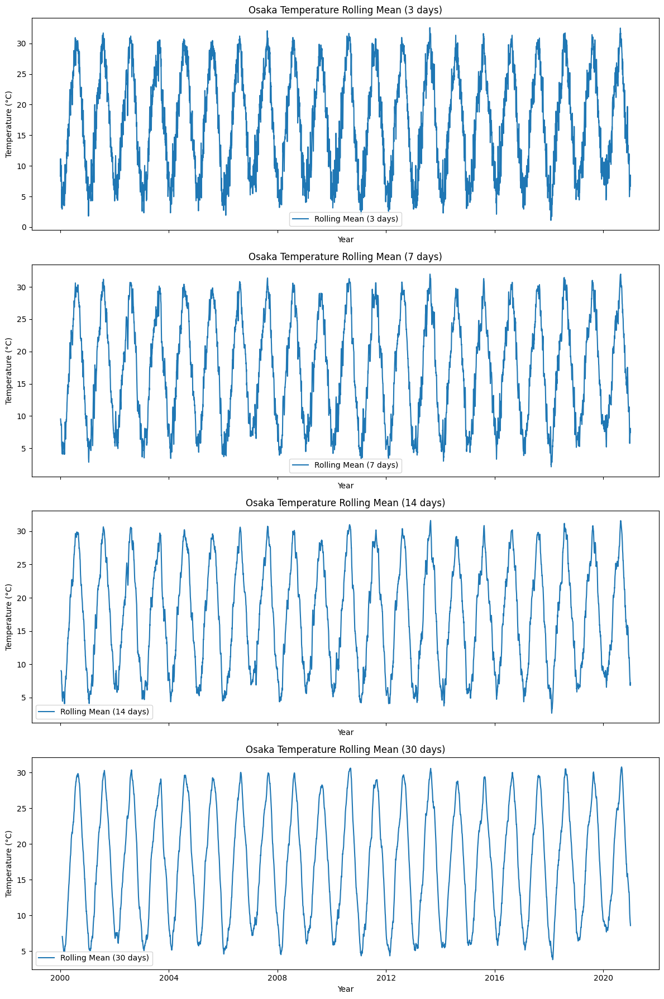

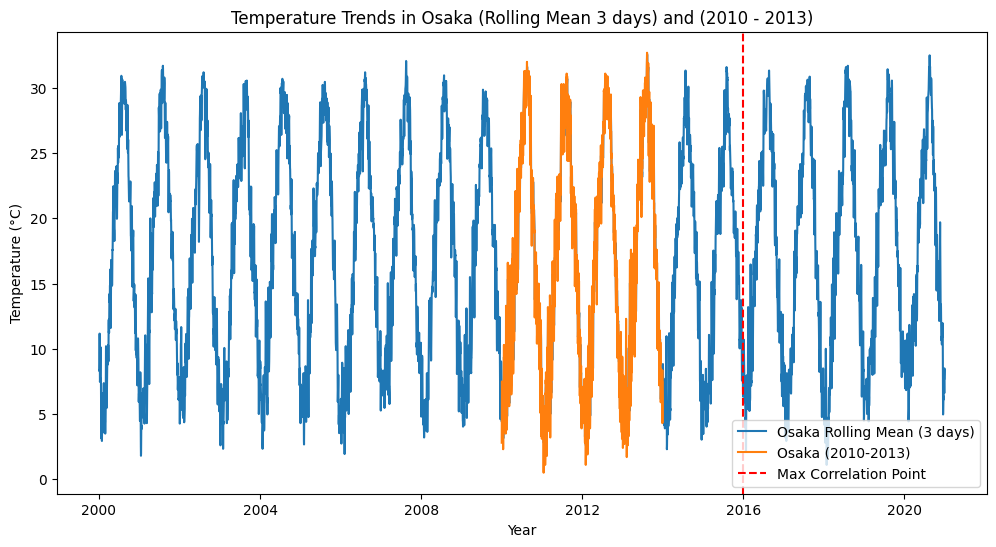

Max correlation for 3 days at index: 2016-01-01 00:00:00


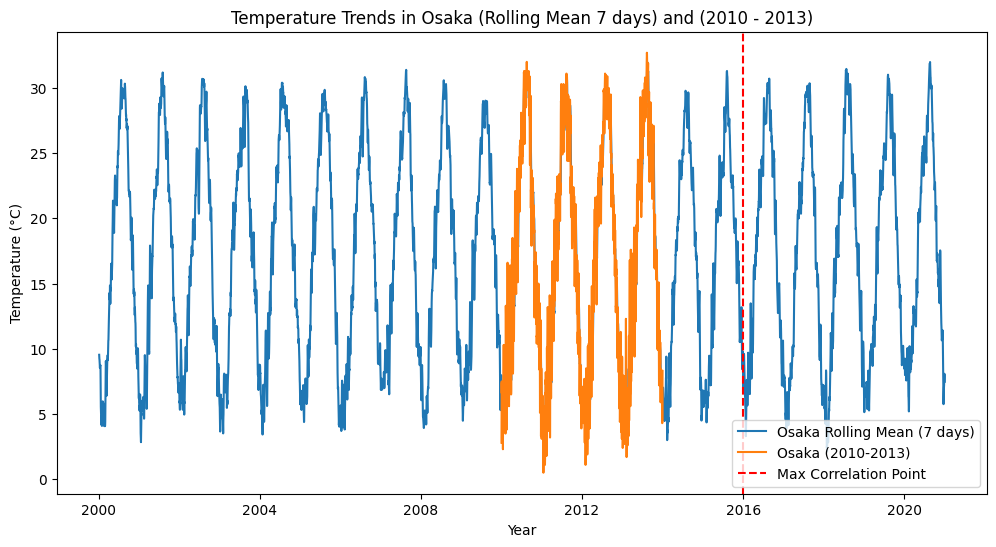

Max correlation for 7 days at index: 2016-01-03 00:00:00


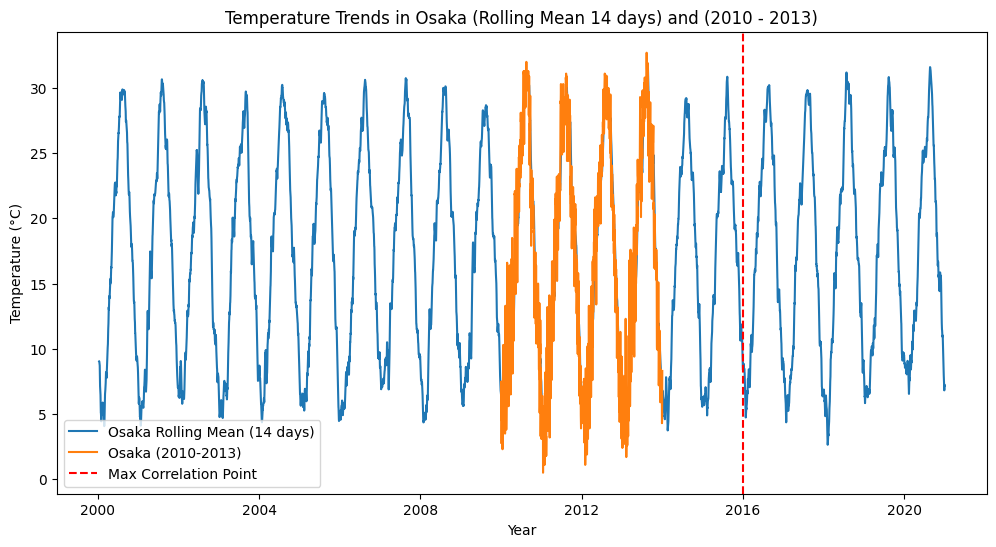

Max correlation for 14 days at index: 2016-01-04 00:00:00


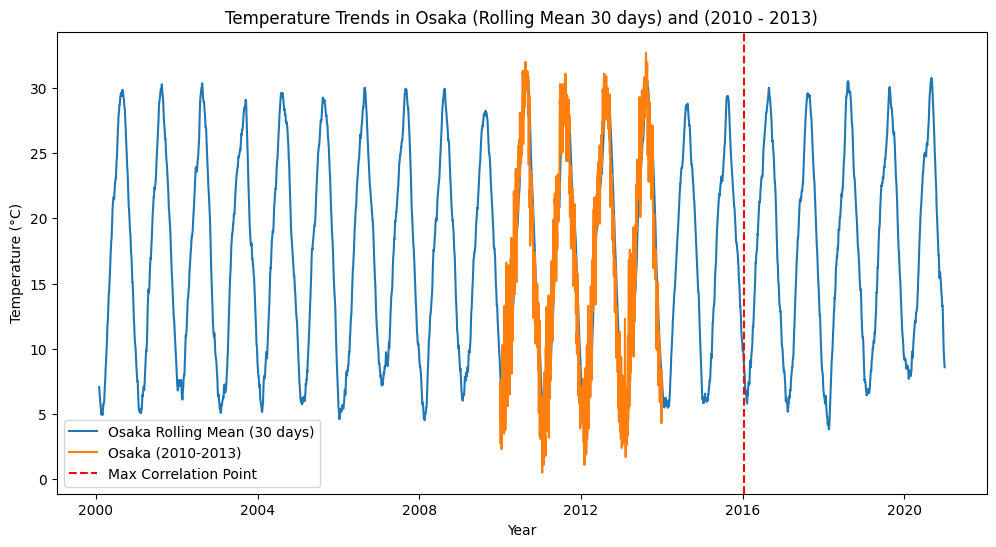

Max correlation for 30 days at index: 2016-01-13 00:00:00


In [21]:
# Anwendung des gleitenden Durchschnitts
rolling_means = {
    '3 days': osaka_temp.rolling(window=3).mean(),
    '7 days': osaka_temp.rolling(window=7).mean(),
    '14 days': osaka_temp.rolling(window=14).mean(),
    '30 days': osaka_temp.rolling(window=30).mean()
}

# Plotten der geglätteten Daten in Subplots
fig, axs = plt.subplots(4, 1, figsize=(12, 18), sharex=True)
for i, (label, data) in enumerate(rolling_means.items()):
    axs[i].plot(osaka_temp.index, data, label=f'Rolling Mean ({label})')
    axs[i].set_title(f'Osaka Temperature Rolling Mean ({label})')
    axs[i].set_xlabel('Year')
    axs[i].set_ylabel('Temperature (°C)')
    axs[i].legend()

plt.tight_layout()
plt.show()

# Kreuzkorrelation zwischen den geglätteten Daten und dem 4-Jahres-Ausschnitt
for label, data in rolling_means.items():
    # Entfernen von NaN-Werten und Indexausrichtung
    valid_idx = ~np.isnan(data)
    valid_data = data[valid_idx]
    valid_index = osaka_temp.index[valid_idx]
    
    # Berechnung der Kreuzkorrelation
    cross_corr = signal.correlate(valid_data, osaka_temp_4year.dropna(), mode='valid', method='auto')
    lag = np.argmax(cross_corr)
    
    # Plot der geglätteten Daten und des 4-Jahres-Ausschnitts mit Markierung des Korrelationsmaximums
    plt.figure(figsize=(12, 6))
    plt.plot(valid_index, valid_data, label=f'Osaka Rolling Mean ({label})')
    plt.plot(osaka_temp_4year.index, osaka_temp_4year, label='Osaka (2010-2013)')
    max_cor_index = valid_index[lag]
    plt.axvline(x=max_cor_index, color='r', linestyle='--', label='Max Correlation Point')
    plt.title(f'Temperature Trends in Osaka (Rolling Mean {label}) and (2010 - 2013)')
    plt.xlabel('Year')
    plt.ylabel('Temperature (°C)')
    plt.legend()
    plt.show()

    print(f'Max correlation for {label} at index:', max_cor_index)

#### 3.1.3.5 Erkentnisse in den Plots mit rolling mean

Man sieht, wie mit zunehmender Anzahl Tage für die Glättung die Linie immer stärker geglättet wird. Bei einer Glättung mit dem Mittelwert von 30 Tagen ist die Linie nicht mehr so kantig, sondern viel stabieler (glätter). Die rote Linie, für die Maximale Korrelation wurde leider in allen Plots nicht korrekt gesetzt.  

#### Diskussion: 
Leider konnte ich mit dem Ursprünglichen Signal der vier Jahre den genauen Ort im geglätteten Signal nicht wieder finden. Dies kann daran liegen, dass die Kreuzkorrelation doch nicht so sehr robust ist wie erhoft. Einige Effekte könnten dabei einen Einfluss auf die schlechte Performance der Kreuzkorrelation haben. 

1. Glättung: Durch die Glättung der Daten, kann es sein, dass die charakteristischen Muster und Merkmale im Signal verringert werden. Diese waren vorher evnentuell wichtig für die Identifizierung der Abschnitte im Gesamtdatensatz. 

2. Verlust von Details: Kurzfristige Veränderungen von den Temperaturen werden durch die glättung mittels Rolling Mean entsprechend entfernt. 

Durch diese "extreme" Änderung in den Daten, war es für die Kreuzkorrelation zu schwer um das vierjährige Signal in den geglätteten Daten zu finden. Eventuell könnte man das ausgeschnittene Signal, also die 4 Jahre, auch glätten um den Problemen entgegen zu wirken. 

## 3.2 Segmentierung, morphologische Operationen, Objekteigenschaften in Bildern

*Aufgabenstellung: Suche 1 Bild, welches mehrere ähnliche Objekte enthält. Diese Objekte sollen mittels geeigneter Methoden segmentiert werden. Die Resultate sollen als gelabelte Bilder (binär oder pro Klasse 1 Label) gespeichert werden. Zeige dabei, wie du die Labelmasken mittels morphologischer Operationen verbessert hast. Erkläre hier für jede angewendete Operation in 1-2 Sätzen, warum du diese Operation anwendest. Zeige auch in Einzelbildern die Zwischenresultate deiner angewendeten Operationen und dass du nur minimal die Objekte verändert hast (z.B. keine Verschiebungen, Verkleinerungen oder Vergrösserungen). Extrahiere am Ende deine einzelnen Objekte, zähle und vermesse 2-3 Eigenschaften deiner extrahierten Objekte mittels geeigneten Methoden. Erkläre pro Eigenschaft in 1-2 Sätzen, warum du diese gewählt hast und ob die Resultate brauchbar sind. Erstelle dann ein möglichst minimales aber repräsentatives Skeleton eines deiner Objekte und gebe die Anzahl Pixel des Skeletons aus. Diskutiere deine Erkenntnisse und Resultate in ca. 150 Wörtern.*

### 3.2.1 Wahl des Bildes

Ich habe mich dafür entschieden, für diese Aufgabenstellung das Bild von einem Seerosenteich zu verwenden. Der Teich ist ein gutes Beispiel für die Aufgabe, da man die Blüten anhand ihrer rosanen Farbe gut vom grünen Hintergrund unterscheiden kann. Die tiefe im Bild und die Überlappungen einzelner Rosenblüten erwiesen sich hingegen als eine grosse Herausforderung. Es ist schwer anhand der tiefe im Bild die grösse von den Blüten weiter hinten im Bild zu erahnen. Die Überlappung der Blüten rechts im Bild macht es schwierig, diese einzel zu erkennen. 

### 3.2.2 Ziel des Experiments
In dem Experiment möchte ich die einzelnen Seerosen auf dem Teich Segmentieren und deren Anzahl zählen. In einem zweiten Schritt werde ich versuchen die Grösse der Seerosen zu bestimmen. Dies könnte dabei helfen die grösse von verschiedenen Seerosen miteinander zu vergleichen. 

#### Szenario:

Wir wollten mit einer Freundin an einen gemütlichen Seerosenteich ausserhalb von Osaka gehen. Dort machst du ein Foto vom Teich und denkst dir folgendes: 

"Ist es möglich, anhand dieses Bildes die Anzahl Seerosen zu zählen und deren Grösse zu bestimmen?"

In dem Experiment möchte ich mittels verschiedenen Methoden die Fische segmentieren. Dies soll ermöglicht werden durch Konvertierung in den Graustufenbereich um danach einen Threshold zu setzen. Da die Hintergrundfarbe sich von den Fischen unterscheidet, sollte ich sie so segmentieren können.

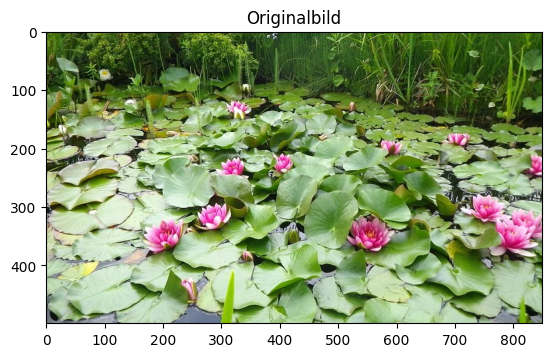

In [22]:
image = Image.open("roses.webp")
image_np = np.array(image)

# Bild anzeigen
plt.imshow(image_np)
plt.title("Originalbild")
plt.show()

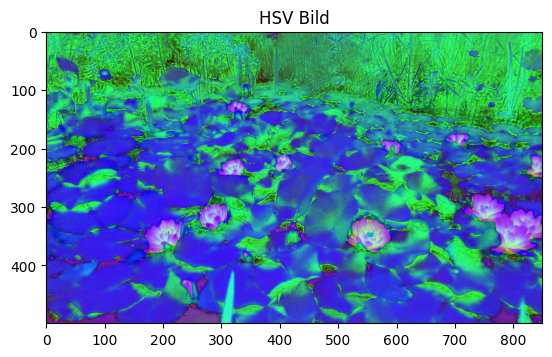

In [23]:
# Konvertiere das Bild in den HSV-Farbraum
image_hsv = cv.cvtColor(image_np, cv.COLOR_RGB2HSV)

# Bild anzeigen im HSV-Farbraum
plt.imshow(image_hsv)
plt.title("HSV Bild")
plt.show()

#### Warum HSV?
Der HSV-Farbraum (Hue, Saturation, Value) trennt Luminanz (oder Helligkeit) von Farbe, was ihn ideal für die Farbsegmentierung in Bildern macht. Dies ist besonders nützlich, wenn die Farben von Objekten unabhängig von der Beleuchtung erkannt werden sollen.

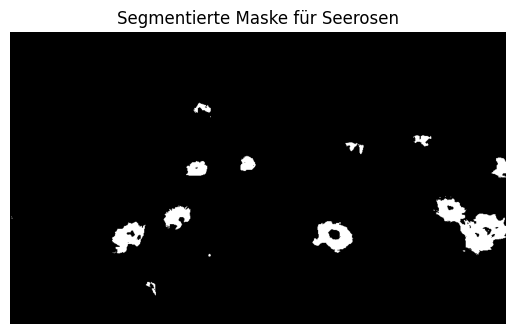

In [24]:
# Definieren der Schwellenwerte für die Segmentierung der rosa Seerosen
lower_pink = np.array([140, 50, 50])
upper_pink = np.array([170, 255, 255])

# Anwenden der Schwellenwerte für rosa Seerosen
mask_pink = cv.inRange(image_hsv, lower_pink, upper_pink)

# Anzeigen der segmentierten Maske
plt.imshow(mask_pink, cmap='gray')
plt.title("Segmentierte Maske für Seerosen")
plt.axis('off')
plt.show()

Parameter: lower_pink = np.array([140, 50, 50]), upper_pink = np.array([170, 255, 255])

#### Warum diese Werte?
Diese Schwellenwerte definieren den Bereich im HSV-Farbraum, der rosa Farbtöne repräsentiert. Der Hue-Wert (Farbton) für Rosa liegt ungefähr zwischen 140 und 170. Die Sättigung und der Wert (Helligkeit) sind breit gewählt (50 bis 255), um verschiedene Schattierungen von Rosa zu erfassen, die von blass bis sehr gesättigt reichen.
*quelle ChatGPT*

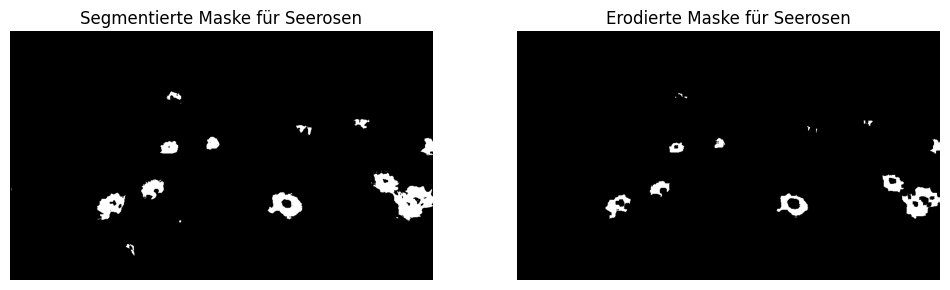

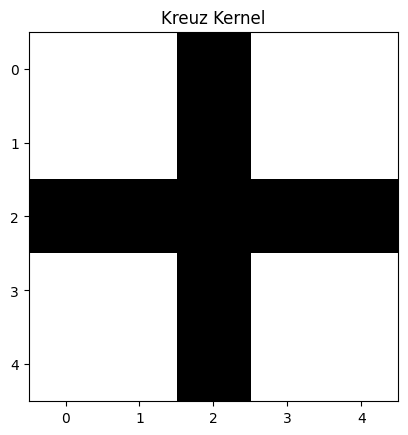

In [25]:
# Anwenden von Erosion und Dilatation
erode_kernel = np.ones((5,5), np.uint8)
# make cross kernel
erode_kernel[2, :] = 0
erode_kernel[:, 2] = 0

mask_eroded = cv.erode(mask_pink, erode_kernel, iterations=1)

# Anzeigen des erodierten Bildes
plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(mask_pink, cmap='gray')
plt.title("Segmentierte Maske für Seerosen")
plt.axis('off')
# Anzeigen des erodierten Bildes
plt.subplot(122)
plt.imshow(mask_eroded, cmap='gray')
plt.title("Erodierte Maske für Seerosen")
plt.axis('off')
plt.show()
# plot kernel
plt.imshow(erode_kernel, cmap="gray")
plt.title("Kreuz Kernel")
plt.show()

Parameter für Erosion: kernel = np.ones((5, 5), np.uint8), iterations=1

#### Warum Erosion? 
Erosion wird verwendet, um kleinere Rauschelemente aus der Maske zu entfernen. Der Kernel definiert, wie weit die Erosion angewendet wird - ein 5x5-Quadrat bedeutet, dass Punkte, die von weniger als 25 anderen Punkten umgeben sind, entfernt werden. *Quelle: ChatGPT*

#### Warum iterations=1?
Mit einer Iteration komme ich auf das beste Ergebniss. Wenn ich 2 Iterations verwende für die Erosion, dann sind die Seerosen kaum mehr zu erkennen. Danach könnte ich keine Erodierung mehr anwenden, weil es fast keine Rosen mehr erkennt.

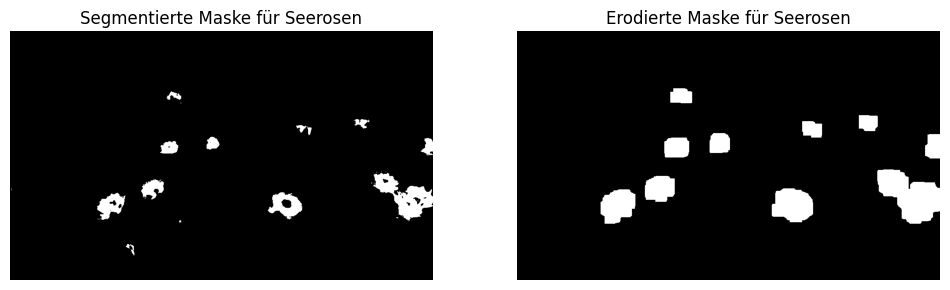

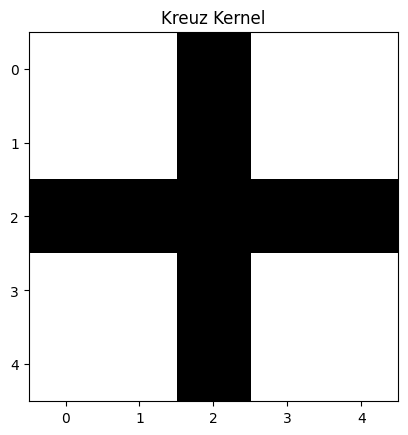

In [26]:
# Anwenden von Dilatation
mask_dilated = cv.dilate(mask_eroded, erode_kernel, iterations=5)

plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(mask_pink, cmap='gray')
plt.title("Segmentierte Maske für Seerosen")
plt.axis('off')
# Anzeigen des erodierten Bildes
plt.subplot(122)
plt.imshow(mask_dilated, cmap='gray')
plt.title("Erodierte Maske für Seerosen")
plt.axis('off')
plt.show()
# plot kernel
plt.imshow(erode_kernel, cmap="gray")
plt.title("Kreuz Kernel")
plt.show()

#### Wahl der Parameter

Parameter für Dilatation: KREUZ KERNEL = np.ones((5, 5), np.uint8), iterations=5

#### Warum Dilatation?
Nach der Erosion können wichtige Objektteile geschrumpft sein. Dilatation erweitert die Maskenbereiche, um ihre ursprüngliche Größe und Form näherungsweise wiederherzustellen. Auch hilft die Dilation dabei, die Löcher in den Seerosen wieder zu füllen. Dies gelingt mir gut mit fünf Iterrationen mit dem Kreuzkernel.

#### Warum iterations=5? 
Mehrere Iterationen helfen, die Struktur der Seerosen vollständiger wiederherzustellen, besonders nachdem sie durch Erosion verkleinert wurden.

#### Kreiskernel anwenden

Die Rosen sehen nun noch etwas spitzig aus. Um dem entgegenzuwirken versuche ich sie nochmals mit einem Kreis Kernel zu erodieren und dilatieren. 

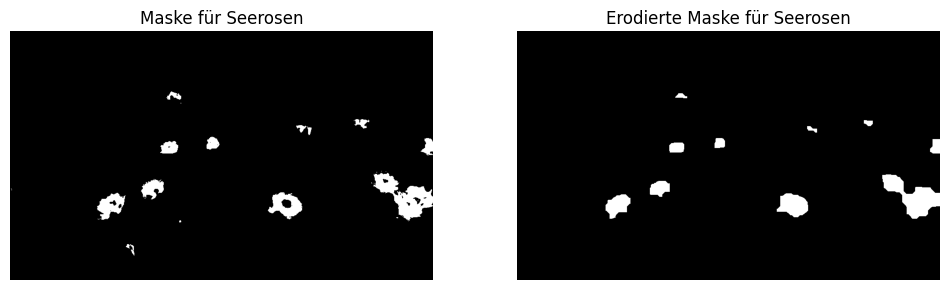

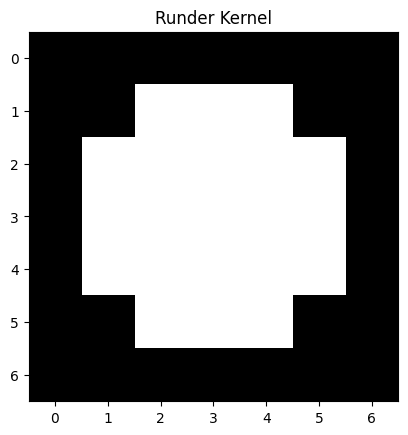

In [27]:
# nochmals dilatiert mit einem runden kernel
dilate_kernel = np.ones((7,7), np.uint8)
# make circle kernel
dilate_kernel[0, :] = 0
dilate_kernel[6, :] = 0
dilate_kernel[:, 0] = 0
dilate_kernel[:, 6] = 0
dilate_kernel[1, 1] = 0
dilate_kernel[1, 5] = 0
dilate_kernel[5, 1] = 0
dilate_kernel[5, 5] = 0

mask_dilated_round = cv.erode(mask_dilated, dilate_kernel, iterations=5)

plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(mask_pink, cmap='gray')
plt.title("Maske für Seerosen")
plt.axis('off')
# Anzeigen des erodierten Bildes
plt.subplot(122)
plt.imshow(mask_dilated_round, cmap='gray')
plt.title("Erodierte Maske für Seerosen")
plt.axis('off')
plt.show()
# plot kernel
plt.imshow(dilate_kernel, cmap="gray")
plt.title("Runder Kernel")
plt.show()

#### Wahl der Parameter

Parameter für Erodieren: KREIS KERNEL = np.ones((7,7), np.uint8), iterations=5

#### Warum nochmals erodieren?
Ich möchte die runde Form der Rosen mehr zur Geltung bringen. Daher habe ich einen 7x7 Kernel erstellt, mit dem ich einen mehr oder weniger "runden" Kernel erstellen kann. 

#### Warum iterations=5? 
Mehrere Iterationen helfen, die Struktur der Seerosen stärker zu ändern. Dies mache ich als Vorbereitung um danach noch mit dem Kreis Kernel zu Dilaten. 

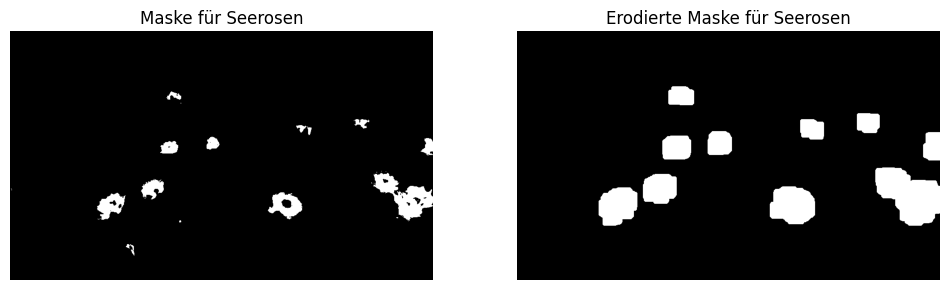

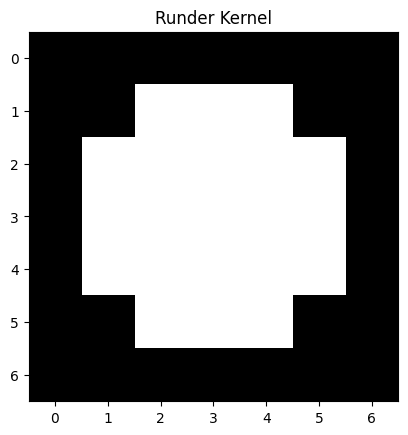

In [28]:
mask_dilated_round = cv.dilate(mask_dilated, dilate_kernel, iterations=2)

plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(mask_pink, cmap='gray')
plt.title("Maske für Seerosen")
plt.axis('off')
# Anzeigen des erodierten Bildes
plt.subplot(122)
plt.imshow(mask_dilated_round, cmap='gray')
plt.title("Erodierte Maske für Seerosen")
plt.axis('off')
plt.show()
# plot kernel
plt.imshow(dilate_kernel, cmap="gray")
plt.title("Runder Kernel")
plt.show()

#### Diskussion der Ergebnisse: 

Durch das mehrfache anwenden von morphologischer Operationen habe ich nun eine sehr gute Maske für das Erkennen der Seerosen erhalten. Die ganz kleinen Punkte, welche geschlossene, fast unsichtbare Seerosen aufgezeigt haben sind nun verschwunden. Dafür sind die grossen Seerosenblüten gut Segmentiert. Alleine die drei Seerosen rechts im Bild konnten nicht segmentiert werden. Dies liegt daran, dass die Seerosen sich überlappen. Dies konnte ich mit viel Zeit und viel Ausprobieren leider nicht beheben. 

Im grossen und Ganzen hat das Segmentieren aber sehr gut funktioniert.  

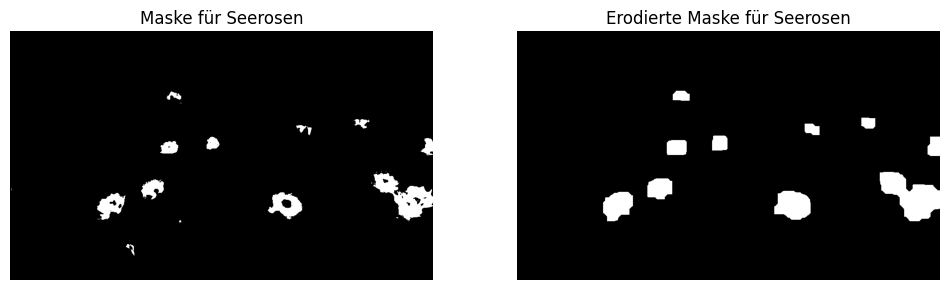

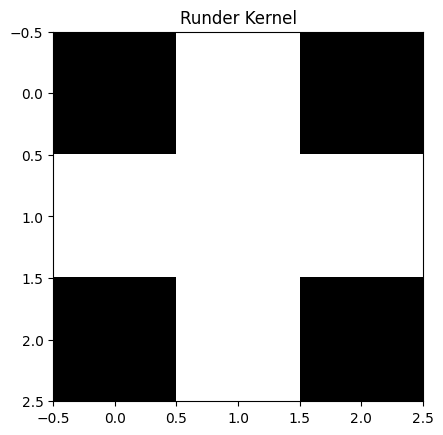

In [29]:
# nochmals dilatiert mit einem runden kernel
dilate_kernel = np.ones((3,3), np.uint8)

# make x kernel
dilate_kernel[0, 0] = 0
dilate_kernel[0, 2] = 0
dilate_kernel[2, 0] = 0
dilate_kernel[2, 2] = 0

mask_dilated_round = cv.erode(mask_dilated, dilate_kernel, iterations=5)

plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(mask_pink, cmap='gray')
plt.title("Maske für Seerosen")
plt.axis('off')
# Anzeigen des erodierten Bildes
plt.subplot(122)
plt.imshow(mask_dilated_round, cmap='gray')
plt.title("Erodierte Maske für Seerosen")
plt.axis('off')
plt.show()
# plot kernel
plt.imshow(dilate_kernel, cmap="gray")
plt.title("Runder Kernel")
plt.show()

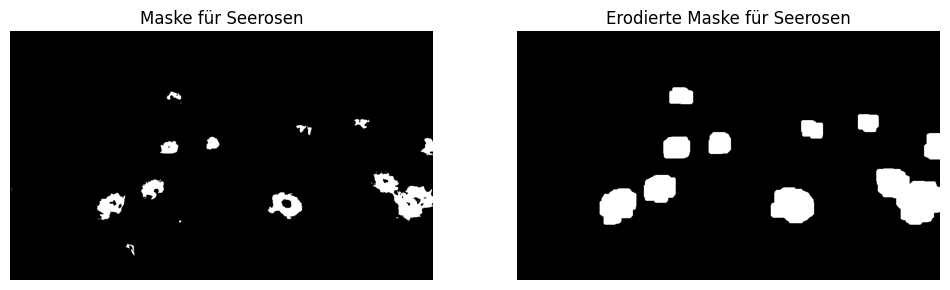

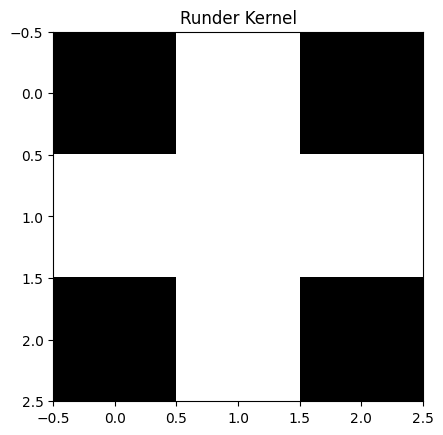

In [30]:
mask_dilated_round = cv.dilate(mask_dilated, dilate_kernel, iterations=2)

plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(mask_pink, cmap='gray')
plt.title("Maske für Seerosen")
plt.axis('off')
# Anzeigen des erodierten Bildes
plt.subplot(122)
plt.imshow(mask_dilated_round, cmap='gray')
plt.title("Erodierte Maske für Seerosen")
plt.axis('off')
plt.show()
# plot kernel
plt.imshow(dilate_kernel, cmap="gray")
plt.title("Runder Kernel")
plt.show()

#### Nun habe ich 6 Morphologische Operationen angewendet..
..und das Ergebniss dieht sehr gut aus. Um aber genau zu prüfen, ob die Maske akkurat ist, werde ich die Maske über das Originalbild des Seerosenteiches legen. 

In [31]:
# import label
from skimage.measure import label

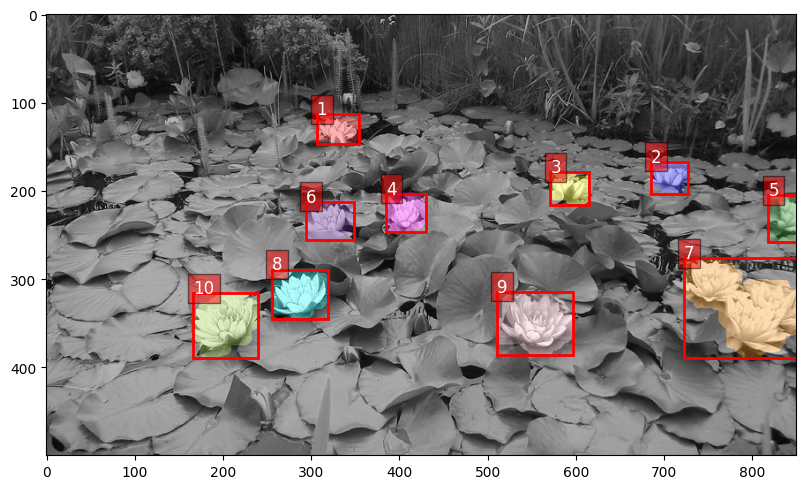

In [32]:
label_image = label(mask_dilated_round)
image_label_overlay = label2rgb(label_image, image=image_np) 

# Plot the image with labeled regions
fig, ax = plt.subplots(figsize=(15, 5))
ax.imshow(image_label_overlay)
properties = ["centroid", "area", "perimeter", "bbox", "feret_diameter_max"]
region_measurements = []
for i, region in enumerate(regionprops(label_image, intensity_image=image_np), start=1):
    # Draw rectangle around segmented regions
    minr, minc, maxr, maxc = region.bbox
    rect = mpatches.Rectangle(
        (minc, minr),
        maxc - minc,
        maxr - minr,
        fill=False,
        edgecolor='red',
        linewidth=2,
    )
    ax.add_patch(rect)
    ax.text(minc, minr, str(i), color='white', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))

    # Calculate the length and height of the bounding box
    bbox_length = maxc - minc
    bbox_height = maxr - minr
    
    measurement = {
        'Object': i,
        'width': bbox_length,
        'height': bbox_height,
        'area': region.area,
        'x coordinate': region.centroid[0],
        'y coordinate': region.centroid[1],
    }
    region_measurements.append(measurement)

df_rosen = pd.DataFrame(region_measurements)
plt.tight_layout()
plt.show()

#### Diskussion der Ergebnisse: 

Die Seerosen werden sehr gut segmentiert und von den roten Boxen umkreist. Die Labels wurden ebenfalls gut gesetzt. Dabei ist das Label 1 ganz oben im Bild und das Label 10 das unterste. Die Farben, welche die Seerosenblüten "ausgemalt" haben zeigen die Maske auf, welche ich durch verschiedene Morphologische Operationen erhalten habe. Dabei ist zu beachten, dass die roten Boxen nicht direkt die Fläche der Seerosen darstellen sondern die Farbigen Flächen innerhalb der Boxen. 

Um die Flächen der Seerosen zu entnehmen, habe ich die Daten in einem Dataframe gepseichert welchen ich hier ausgebe: 

In [33]:
df_rosen

,Object,width,height,area,x coordinate,y coordinate
0,1,48,34,1474.0,130.320217,329.362280
1,2,42,36,1376.0,183.696948,705.327035
2,3,44,37,1433.0,196.875087,592.561061
3,4,45,44,1808.0,225.103982,406.653208
4,5,32,53,1527.0,231.552718,834.925344
5,6,54,44,2206.0,233.844968,320.417951
6,7,128,113,9330.0,329.693891,789.177492
7,8,64,56,3062.0,316.088504,286.620183
8,9,87,72,5003.0,349.461323,553.463522
9,10,74,73,4222.0,350.688536,202.050450


#### Erkenntnisse im Data Frame:

Wir sehen die 10 Objekte (Seerosen) welche erkannt wurden. Die width und height sind die Breite und Höhe der Kästchen, welche die Seerosenblüten eingekreist haben. 

In der Spalte "area" sehen wir die Flächen der Seerosenblüten. Die mit Abstand grösste Blüte ist das Object Nr. 7. Dies ist nicht weiter verwunderlich, da es eigentlich drei Blüten sind, welche ich bei der Segmentierung nicht trennen konnte.

#### Statistik des Dataframes

In [34]:
# statistik aus dem df
df_rosen.describe()

,Object,width,height,area,x coordinate,y coordinate
count,10.00000,10.000000,10.000000,10.000000,10.000000,10.000000
mean,5.50000,61.800000,56.200000,3144.100000,254.732617,502.055852
std,3.02765,28.483133,24.348397,2516.897537,76.947505,224.530839
min,1.00000,32.000000,34.000000,1376.000000,130.320217,202.050450
25%,3.25000,44.250000,38.750000,1487.250000,203.932311,322.654033
50%,5.50000,51.000000,48.500000,2007.000000,232.698843,480.058365
75%,7.75000,71.500000,68.000000,3932.000000,326.292544,677.135541
max,10.00000,128.000000,113.000000,9330.000000,350.688536,834.925344


In [35]:
# median of the area
median_area = df_rosen['area'].median()
print(f'Median Area: {median_area}')

# mean of the area
mean_area = df_rosen['area'].mean()
print(f'Mean Area: {mean_area}')

# area of the largest object
largest_area = df_rosen['area'].max()
print(f'Largest Area: {largest_area}')

# area of the smallest object
smallest_area = df_rosen['area'].min()
print(f'Smallest Area: {smallest_area}')

Median Area: 2007.0
Mean Area: 3144.1
Largest Area: 9330.0
Smallest Area: 1376.0


In der Statistik ist spannend zu sehen, dass der Mittelwert der Fläche viel höher ist als der Median Wert. Dies liegt an der extrem grossen Fläche des Objekt Nummer 7. Auch spannend ist der Unterschied in der Grösse zwischen dem Grössten und dem kleinsten Seerosenblatt. 

### 3.2.3 skeletonisierung

#### Ziel:

In der Aufgabe will ich die Skelette der einzelnen Seerosenblüten finden. Diese sollten minimal sein aber trotzdem die grundlegenden Merkmale der Blüten wiedergeben.

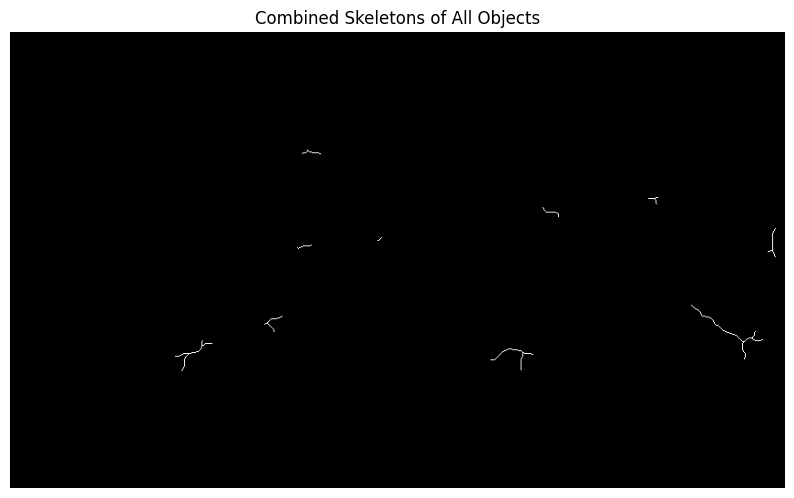

Skeleton of label 1 has 22 pixels.
Skeleton of label 2 has 17 pixels.
Skeleton of label 3 has 22 pixels.
Skeleton of label 4 has 5 pixels.
Skeleton of label 5 has 37 pixels.
Skeleton of label 6 has 16 pixels.
Skeleton of label 7 has 110 pixels.
Skeleton of label 8 has 30 pixels.
Skeleton of label 9 has 66 pixels.
Skeleton of label 10 has 68 pixels.


In [36]:
# Angenommen label_image ist bereits vordefiniert
skeletons_combined = np.zeros_like(label_image, dtype=bool)  # Initiales Bild als boolean array für bessere Darstellung

# Bereite ein Dictionary vor, um die Pixelanzahl für jedes Skelett zu speichern
skeleton_pixel_counts = {}

# Durchgehen der Regionen und Erstellen der Skelette
for region in regionprops(label_image):
    # Erstelle ein Maskenbild nur für die aktuelle Region
    single_region_mask = label_image == region.label

    # Erstelle das Skelett der Region
    skeleton = morphology.skeletonize(single_region_mask)

    # Zähle die Pixel im Skelett und speichere sie
    skeleton_pixel_counts[region.label] = np.sum(skeleton)

    # Kombiniere alle Skelette in einem Bild
    skeletons_combined = skeletons_combined | skeleton  # Verwende logisches OR, um Skelette hinzuzufügen

# Plot das kombinierte Skelett-Bild
fig, ax = plt.subplots(figsize=(10, 6))
ax.imshow(skeletons_combined, cmap='gray')
ax.set_title('Combined Skeletons of All Objects')
ax.axis('off')  # Achsen und Raster ausschalten

plt.show()

# Ausgabe der Pixelanzahlen für jedes Skelett
for label, count in skeleton_pixel_counts.items():
    print(f"Skeleton of label {label} has {count} pixels.")

#### Erkenntnisse in den Skeletons

Die Zahlen, die wir in der Ausgabe sehen (z. B. 22 Pixel für Label 1, 110 Pixel für Label 7), repräsentieren die Anzahl der Pixel, die das Skelett jedes Objekts bildet, also die **Länge des Skelets**. Ein größeres Skelett kann auf ein größeres oder komplexeres Objekt hinweisen, während ein kleineres Skelett ein einfacheres oder kleineres Objekt darstellen könnte.

Für was können Skelette nützlich sein? --> ChatGPT: 
Das Verständnis von Skeletten kann besonders nützlich sein in Bereichen wie Biologie (z. B. Neuronenverzweigungen), Materialwissenschaft (z. B. Rissnetzwerke) oder in der Bildverarbeitung, wo strukturelle Muster erkannt werden müssen.

# 4 Feature Deskriptoren in Bildern (LE4)

## 4.1 Keypoint Matching

*Aufgabe: Suche ein paar Bilder mit dem gleichen Sujet/Objekt aus, welche das Objekt von unterschiedlichen Blickwinkeln, aus anderer Perspektive, aus unterschiedlicher Distanz oder rotiert zeigen. Wende dann den dir zugeordneten Keypoint Deskriptor {'AKAZE'} an, um mindestens zwei deiner Bilder via Keypoints zu "matchen". Wähle dafür geeignete Parameter und eine geeignete Anzahl Keypoints. Erläuere deine Entscheidungen in 1-2 Sätzen. Zeige deine Resultate visu ell und stelle 2-3 Beobachtungen auf. 
Diskutiere in ca. 150 Wörtern wie robust der dir zugeordnete Algorithms {'AKAZE'} ist in Bezug auf Transformationen oder unterschiedlicher Aufnahmeverhältnisse (Licht, ...) und dessen rechnerische Effizienz. Zeige mindestens eine dieser Eigenschaften anhand deiner Beispieldaten. Diskutiere die Resultate und Erkenntnisse in 2-3 Sätzen.*

### 4.1.1 Wahl der Bilder

Für die Aufgabe mit dem Keypoint Matching habe ich verschiedene Bilder mit verschiedenen Beleuchtungen und Ausrichtungen der Karten gemacht und versuche diese mit dem AKAZE Algorithmus zu matchen. Pokémonkarten haben eine klare Struktur und sehen immer ähnlich aus, daher denke ich, dass sie sich gut für diese Aufgabe eignen werden. Sie sind sehr markant und haben beispielsweise einen gelben Rand, welcher vieleicht als wichtiges Feature erkennt werden wird.

### 4.1.2 Szenario
In Japan sind Pokémonkarten etwas sehr spezielles und haben dort noch einen viel grösseren Stellenwert als hier in Europa. Daher musste ich natürlich vor dem Rückflug in die Schweiz ein paar seltene Pokémonkarten kaufen. Diese habe ich dann an eine Gradingfirma gesendet, welche den Zustand der Karte prüft. Dabei gibt es ein Rating für die Karte von 1 (sehr schlecht) bis 10 (sehr Gut). Zwei von meinen drei Karten haben eine 10 erhalten, was bedeutet, dass diese keine Makel aufweisen. Die dritte Karte (Glurak) hat "nur" eine 9 erhalten. Dies ist jedoch auch ein sehr guter wert, allerdings ist die Karte nicht in ganz perfektem Zustand. 



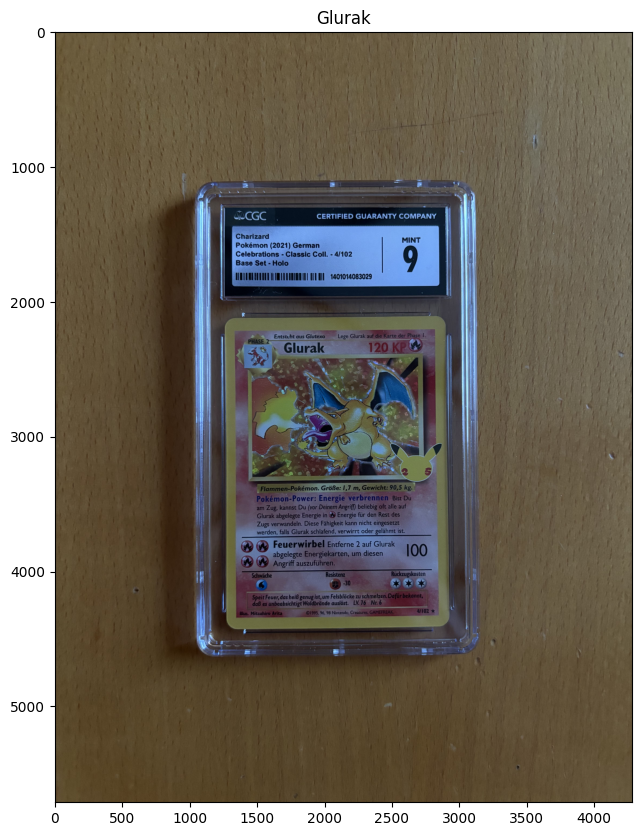

In [37]:
# read jpeg
glurak = cv.imread('glurak.jpg')

# convert to rgb
glurak = cv.cvtColor(glurak, cv.COLOR_BGR2RGB)

plt.figure(figsize=(10, 10))
plt.imshow(glurak)
plt.title("Glurak")
plt.show()

Das ist das Legendäre Starter Pokémon Glurak. Dies ist eines der beliebtesten Pokémon überhaupt und fast jeder hat schon mal etwas von diesem Pokémon gehört. Über der Karte sieht man das Grading "9". Dies wurde von der Gradingfirma CGC (Certified Guaranty Company) bewertet. Der Sinn vom Grading ist es, den Zustand einer Karte zu prüfen und die Echtheit der Karte zu bestätigen. Je höher das Grading ist, desto mehr Wert hat eine Karte. Diese Glurak Karte hat aktuell (29.05.2024) den Wert von ca. CHF 95.00. Wenn es eine 10 erhalten hätte, wäre der Wert noch höher. 

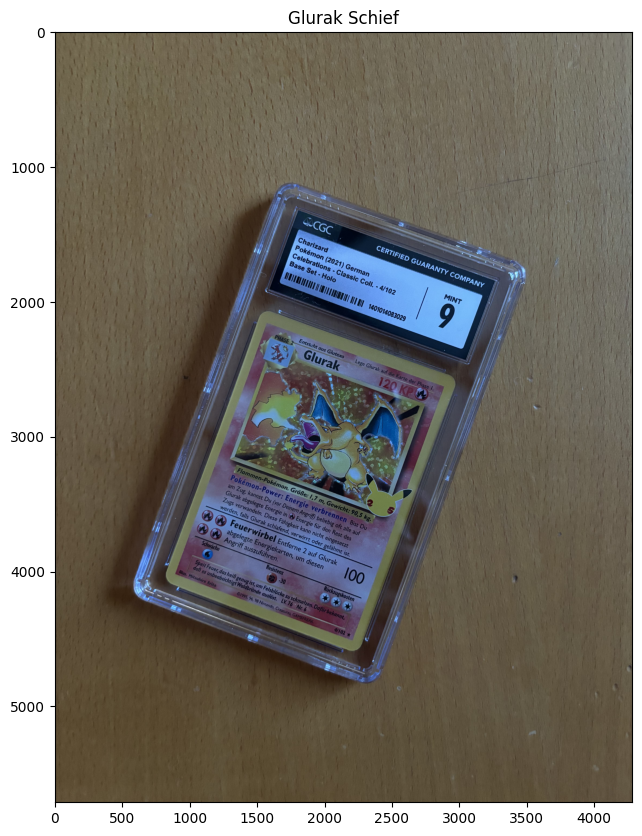

In [38]:
glurak_schief = cv.imread('glurak_schief.jpg')

# convert to rgb
glurak_schief = cv.cvtColor(glurak_schief, cv.COLOR_BGR2RGB)

plt.figure(figsize=(10, 10))
plt.imshow(glurak_schief)
plt.title("Glurak Schief")
plt.show()

### Umwandeln in Graustufen

Die Konvertierung in Graustufen ist ein üblicher Schritt in der Bildverarbeitung für Feature-Detection und Matching, da es die Komplexität der Daten reduziert und den Algorithmus schneller und weniger anfällig für Farbvarianzen macht.

#### Komplexität und Effizienz
Die Konvertierung in Graustufen reduziert die Datenmenge, die verarbeitet werden muss. Dies kann die Geschwindigkeit der Keypoint-Detektion und Deskriptor-Extraktion verbessern, da statt drei Farbkanälen nur ein einzelner Intensitätskanal bearbeitet wird. Durch die Reduzierung auf einen Kanal kann der Algorithmus schneller arbeiten, was besonders in Echtzeitanwendungen oder bei der Verarbeitung großer Bilddatenmengen wichtig ist.

#### Fokus auf Struktur
Die Konvertierung in Graustufen zwingt den Algorithmus dazu, sich auf strukturelle Informationen zu konzentrieren, die oft wichtiger für die Feature-Erkennung sind als Farbinformationen. Strukturen wie Kanten, Ecken und Texturen treten in Graustufenbildern klar hervor und sind oft entscheidend für erfolgreiche Bildvergleiche und Objekterkennung.

#### Konsistenz
Auch wenn AKAZE in der Lage ist, mit Farbinformationen umzugehen, kann die Verwendung von Graustufen die Konsistenz mit anderen Verarbeitungsschritten oder Algorithmen verbessern, die möglicherweise ausschließlich Graustufenbilder verwenden.

*Quelle: ChatGPT*

In [39]:
# glurak und glura_schief in graustufen konvertieren
glurak = cv.cvtColor(glurak, cv.COLOR_RGB2GRAY)
glurak_schief = cv.cvtColor(glurak_schief, cv.COLOR_RGB2GRAY)

### Erkennen der Keypoints und Berechnen der Deskriptoren mit Hilfe von AKAZE

In [40]:
# use AKAZE to detect Keypoints
akaze = cv.AKAZE_create()
keypoints_glurak, descriptors_glurak = akaze.detectAndCompute(glurak, None)
keypoints_glurak_schief, descriptors_glurak_schief = akaze.detectAndCompute(glurak_schief, None)

#### Verwendung von AKAZE

AKAZE bietet eine robuste Methode zur Erkennung lokaler Features in Bildern, die gut für Aufgaben wie das Matching von Bildern unter unterschiedlichen Sichtbedingungen geeignet ist. Dies ist besonders nützlich, wenn Bilder Verzerrungen oder verschiedene Perspektiven aufweisen, wie in dem Beispiel die rotierte Karte "Glurak schief" und "Glurak". 

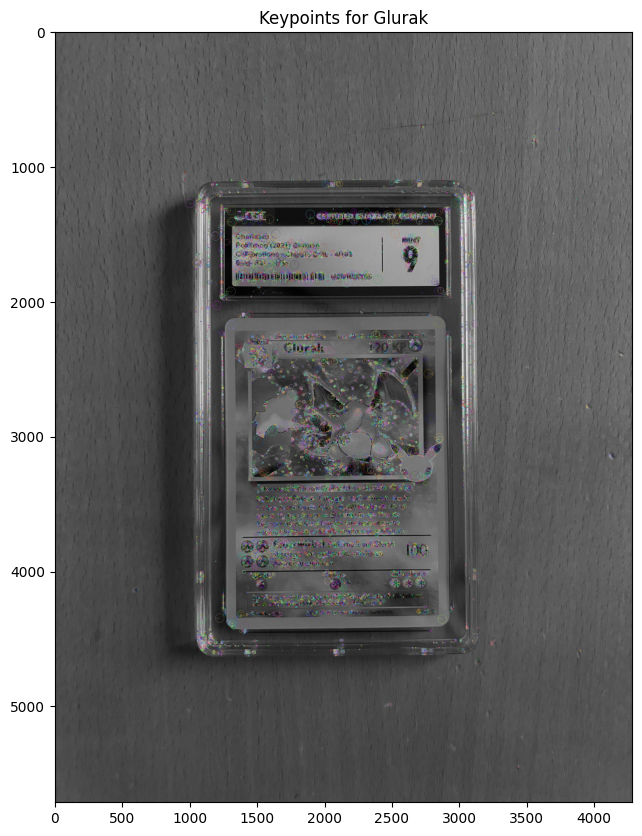

In [41]:
# Visualize the keypoints for Glurak
keypoints_img = cv.drawKeypoints(glurak, keypoints_glurak, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(10, 10))
plt.imshow(keypoints_img)
plt.title("Keypoints for Glurak")
plt.show()

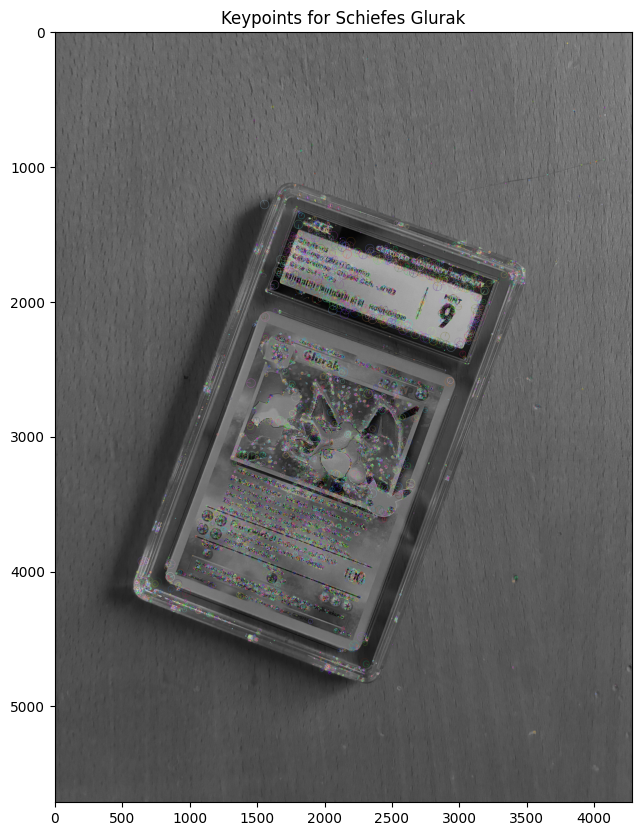

In [42]:
# Display the keypoints for Glurak Schief
keypoints_img_schief = cv.drawKeypoints(glurak_schief, keypoints_glurak_schief, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(10, 10))
plt.imshow(keypoints_img_schief)
plt.title("Keypoints for Schiefes Glurak")
plt.show()

In [43]:
matcher = cv.DescriptorMatcher_create(cv.DescriptorMatcher_BRUTEFORCE_HAMMING)
nn_matches = matcher.knnMatch(descriptors_glurak, descriptors_glurak_schief, 2)

#### Wahl der Parameter:
**Bruteforce Hamming** ist effektiv, wenn binäre Descriptoren wie die von AKAZE verwendet werden. Dieser Matcher ist schnell und effizient bei der Suche nach dem nächsten Deskriptor durch direkten Vergleich der Hamming-Distanz.

In [44]:
matched1 = []
matched2 = []
nn_match_ratio = 0.7 # Nearest neighbor matching ratio
for m, n in nn_matches:
 if m.distance < nn_match_ratio * n.distance:
    matched1.append(keypoints_glurak[m.queryIdx])
    matched2.append(keypoints_glurak_schief[m.trainIdx])

#### Wahl der Parameter: 
**nn_match_ratio = 0.7**
Ein höherer Wert wie 0.7 ermöglicht es, eine Balance zwischen der Qualität der Matches und der Anzahl der akzeptierten Matches zu finden. Der Ratio-Test hilft dabei, zuverlässige Matches zu identifizieren, indem er sicherstellt, dass die Distanz des besten Matches deutlich kleiner ist als das 0.7-Fache der Distanz des zweitbesten Matches. Je tiefer der Wert bei nn_match_ratio gesetzt wird, desto bessere Matches werden ausgewählt, dabei kann es aber sein, dass man zu wenige zuverlässige Matches erhält, wenn man die nn_match_ratio zu tief setzt. Mit 0.7 habe ich eine gute Balance gefunden, zwischen einem guten Matching und genügend Matches.

In [45]:
# Homographie berechnen, Punkte umwandeln
if len(matched1) >= 4 and len(matched2) >= 4:
    pts1 = np.float32([kp.pt for kp in matched1])
    pts2 = np.float32([kp.pt for kp in matched2])
    homography, mask = cv.findHomography(pts1, pts2, cv.RANSAC)

#### Wahl der Parameter: 
**cv.findHomography(pts1, pts2, cv.RANSAC)**
RANSAC ist eine robuste Methode zur Schätzung der Homographie, die Ausreißer effektiv ignoriert und somit eine präzisere geometrische Transformation zwischen den Bildern liefert. Dies ist essentiell, um die korrekten räumlichen Beziehungen zwischen den Bildern zu etablieren.

Quelle: ChatGPT

In [46]:
inliers1 = []
inliers2 = []
good_matches = []
inlier_threshold = 2.5 # Distance threshold to identify inliers with homography check
for i, m in enumerate(matched1):
 col = np.ones((3,1), dtype=np.float64)
 col[0:2,0] = m.pt
 
 col = np.dot(homography, col)
 col /= col[2,0]
 dist = sqrt(pow(col[0,0] - matched2[i].pt[0], 2) +\
 pow(col[1,0] - matched2[i].pt[1], 2))
 
 if dist < inlier_threshold:
    good_matches.append(cv.DMatch(len(inliers1), len(inliers2), 0))
    inliers1.append(matched1[i])
    inliers2.append(matched2[i])

#### Wahl der Parameter: 
**inlier_threshold auf 2.5.**

Ein Schwellenwert von 2.5 Pixeln für die Inlier-Bestimmung ermöglicht eine gewisse Toleranz gegenüber kleinen Fehlplatzierungen und Ungenauigkeiten in der Homographie-Schätzung, hilft jedoch gleichzeitig, wahre Korrespondenzen von Fehlmatches zu unterscheiden.

A-KAZE Matching Results
*******************************
# Keypoints 1: 	 18390
# Keypoints 2: 	 18251
# Matches: 	 5529
# Inliers: 	 4553
# Inliers Ratio: 	 0.8234762163139808


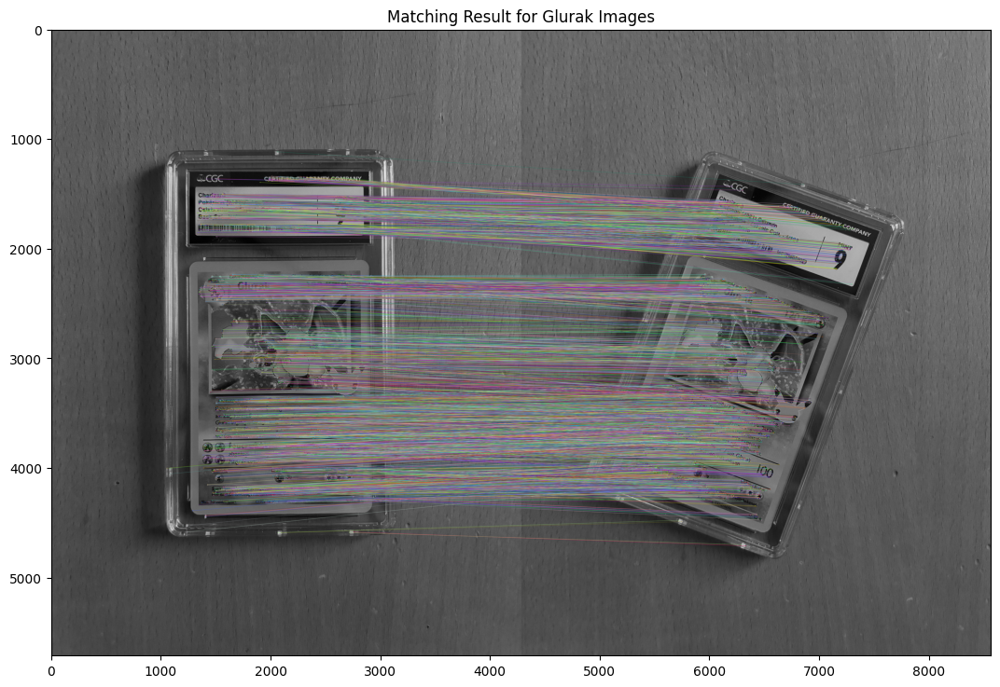

In [47]:
# Erstelle ein leeres Ergebnisbild der entsprechenden Größe
res = np.empty((max(glurak.shape[0], glurak_schief.shape[0]), glurak.shape[1] + glurak_schief.shape[1], 3), dtype=np.uint8)

# Zeichne die guten Matches auf das leere Bild 'res'
cv.drawMatches(glurak, inliers1, glurak_schief, inliers2, good_matches, res)

# Berechne das Verhältnis der Inlier-Matches zu den Gesamtmatches
inlier_ratio = len(inliers1) / float(len(matched1))

# Ausgabe der Ergebnisse
print('A-KAZE Matching Results')
print('*******************************')
print('# Keypoints 1: \t', len(keypoints_glurak))
print('# Keypoints 2: \t', len(keypoints_glurak_schief))
print('# Matches: \t', len(matched1))
print('# Inliers: \t', len(inliers1))
print('# Inliers Ratio: \t', inlier_ratio)

# Zeige das Bild im Notebook an
plt.figure(figsize=(13, 13))  # Größe des Bildes anpassen
plt.imshow(res)  # Keine Farbkonvertierung benötigt, da schon in RGB
plt.title('Matching Result for Glurak Images')
plt.show()

# code Quelle ChatGPT

### Diskussion der Ergebnisse: 

#### Keypoints 1 (18'390) und Keypoints 2 (18'251):

Diese Zahlen repräsentieren die Anzahl der erkannten Keypoints in den beiden Bildern. Ein Keypoint in diesem Kontext ist ein Punkt im Bild, den der AKAZE Algorithmus als besonders charakteristich erachtet, oft wegen markanter Texturen oder Kanten.

Die grosse Anzahl von Keypoints in beiden Bildern zeigt, dass die Bilder reich an Merkmalen sind, was typisch für Bilder mit hoher Textur oder vielen Details ist.

#### Matches (5'529):

Hier wird die Anzahl der gepaarten Keypoints zwischen den beiden Bildern angegeben, die aufgrund der Deskriptoren (die die lokale Umgebung jedes Keypoints beschreiben) als Übereinstimmungen (Matches) identifiziert wurden.

Die Zahl der Matches ist deutlich geringer als die Gesamtzahl der Keypoints in jedem Bild. Das ist üblich, da nicht alle Keypoints ein entsprechendes Gegenstück im anderen Bild haben, besonders wenn die Bilder unterschiedliche Perspektiven, Skalierungen oder teilweise Verdeckungen zeigen. 

#### Inliers (4'553):

Inliers sind die Matches, die nach einem zusätzlichen Verifizierungsschritt (oft durch ein geometrisches Modell wie eine Homographie) als konsistent und zuverlässig angesehen werden. Diese Matches passen gut zu einem bestimmten Modell der räumlichen Beziehung zwischen den beiden Bildern.

Die Anzahl der Inliers ist ein Indikator für die Qualität der Matches. Eine hohe Anzahl von Inliers deutet darauf hin, dass viele der initialen Matches tatsächlich korrekt sind und die beiden Bilder ähnliche Szenen oder Objekte enthalten.

#### Inliers Ratio 0.82:

Dies ist das Verhältnis der Inliers zur Gesamtzahl der Matches. Ein Wert von etwa 0.82 bedeutet, dass rund 82% der Matches als Inliers bestätigt wurden, was auf eine sehr hohe Qualität der Feature-Matching-Ergebnisse hinweist.

*Quelle: Chat GPT*

### Top 30 Matches

Um einen besseren Überblick zu gewinnen, welche Punkte im Bild als speziell wichtig anerkennt werden, habe ich ChatGPT gebeten, meinen Code so anzupassen, dass es nur die TOP 30 Keypoints ausgibt und matched. 

In [48]:
# Erstellen der nn_matches
nn_matches = matcher.knnMatch(descriptors_glurak, descriptors_glurak_schief, 2)
all_matches = []

# Filter für gute Matches basierend auf dem Nearest-Neighbor-Distance-Ratio-Test
for m, n in nn_matches:
    if m.distance < nn_match_ratio * n.distance:
        all_matches.append(m)

# Sortieren der Matches nach ihrer Distanz
all_matches = sorted(all_matches, key=lambda x: x.distance)

# Auswahl der besten 30 Matches
top_matches = all_matches[:30]  # Ändern Sie diese Zahl nach Bedarf

# code Quelle ChatGPT

#### Wahl der Parameter: 

**nn_match_ratio** Die Werte für den nn_match_ratio habe ich bereits oben definiert und für dieses Beispiel so übernommen. 

**Auswahl der TOP 30** : Das Sortieren nach Distanz hilft dabei, die Matches mit der geringsten Distanz, und damit der höchsten Ähnlichkeit, zu identifizieren. Die Beschränkung auf die besten 30 Matches gewährleistet eine Balance zwischen ausreichender Match-Anzahl und Vermeidung von Überladung der visuellen Darstellung.

Die verbindenden Linien im Plot vorher waren sehr dünn und schwer zu sehen. Daher habe ich mit Hilfe von ChatGPT einen neuen Codeblock erstellt, welcher die beiden Bilder nebeneinander plottet und die Linien sichtbar und in rot darstellt. Dieser Schritt ermöglicht es, die Qualität der Matches detailliert zu beurteilen und zu analysieren.

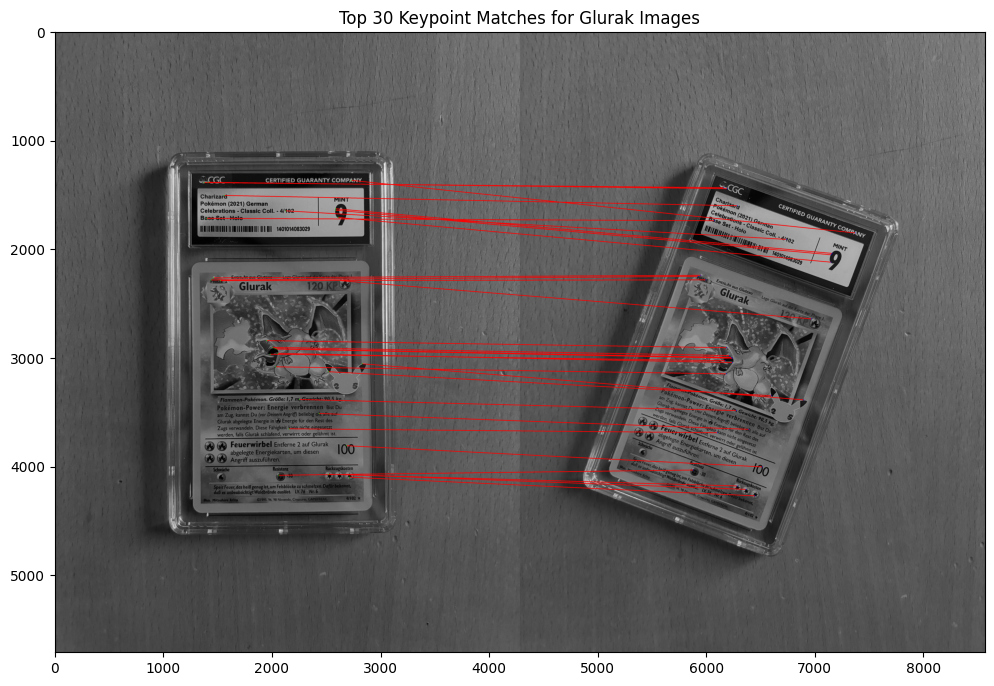

In [49]:
# Erstellen Sie ein leeres Ergebnisbild der entsprechenden Größe
height = max(glurak.shape[0], glurak_schief.shape[0])
width = glurak.shape[1] + glurak_schief.shape[1]
res = np.zeros((height, width, 3), dtype=np.uint8)

# Konvertiere Graustufenbilder zurück in BGR für die farbige Darstellung
glurak_color = cv.cvtColor(glurak, cv.COLOR_GRAY2BGR)
glurak_schief_color = cv.cvtColor(glurak_schief, cv.COLOR_GRAY2BGR)

# Setze die beiden Bilder nebeneinander im Ergebnisbild 'res'
res[:glurak.shape[0], :glurak.shape[1]] = glurak_color
res[:glurak_schief.shape[0], glurak.shape[1]:glurak.shape[1]+glurak_schief.shape[1]] = glurak_schief_color

# Zeichnen der Matches mit individueller Linienstärke
for m in top_matches:
    # Start- und Endpunkt für die Linie
    start_point = tuple(np.round(keypoints_glurak[m.queryIdx].pt).astype(int))
    end_point = tuple(np.round(keypoints_glurak_schief[m.trainIdx].pt + np.array([glurak.shape[1], 0])).astype(int))

    # Zeichne die Verbindungslinie
    cv.line(res, start_point, end_point, (255, 0, 0), thickness=5)  # Blaue Linie mit Dicke 5

    # Zeichne die Keypoints
    cv.circle(res, start_point, 4, (0, 255, 0), thickness=-1)  # Grüner Kreis
    cv.circle(res, end_point, 4, (0, 0, 255), thickness=-1)  # Roter Kreis

# Visualisierung des Ergebnisses
plt.figure(figsize=(12, 12))
plt.imshow(res)
plt.title('Top 30 Keypoint Matches for Glurak Images')
plt.show()

# code Quelle ChatGPT

#### Erkenntnisse im Plot: 

In diesem Plot erkennt man nun die 30 wichtigsten Keypoints in den zwei Bildern. Diese sind mit roten Linien verbunden. Es ist nun viel übersichtlicher und man erkennt, dass das Keypointmatchin sehr gut funktioniert hat. Beispielsweise die drei Sterne unten rechts in der Karte wurden perfekt erfasst und im zweiten Bild gematched. Auch die anderen Punkte sehen so aus, als hätte AKAZE sie perfekt erfassen können. 

Was mich dabei besonders überrascht hat, sind die meiner Meinung nach willkürlich gesetzten Keypoints in der mitte der Karte, unterhalb des Bildes von Glurak. Diese hätte ich niemals gedacht, dass sie wichtig sein werden für den Algorithmus. 

### Top 5 Keypoints für Glurak

Nun will ich noch sehen, welches die Top 5 Keypoints sind. Dies mache ich nochmals genau gleich wie bei den Top 30, einfach nur für die wichtigsten fünf Punkte. 

In [50]:
# Nachdem Sie die Matches mit der NN-Methode gefunden haben
nn_matches = matcher.knnMatch(descriptors_glurak, descriptors_glurak_schief, 2)
all_matches = []

# Filter für gute Matches basierend auf dem Nearest-Neighbor-Distance-Ratio-Test
for m, n in nn_matches:
    if m.distance < nn_match_ratio * n.distance:
        all_matches.append(m)

# Sortieren der Matches nach ihrer Distanz
all_matches = sorted(all_matches, key=lambda x: x.distance)

# Auswahl der besten 5 Matches
top_5_matches = all_matches[:5]  # Ändern Sie diese Zahl nach Bedarf

# code Quelle ChatGPT

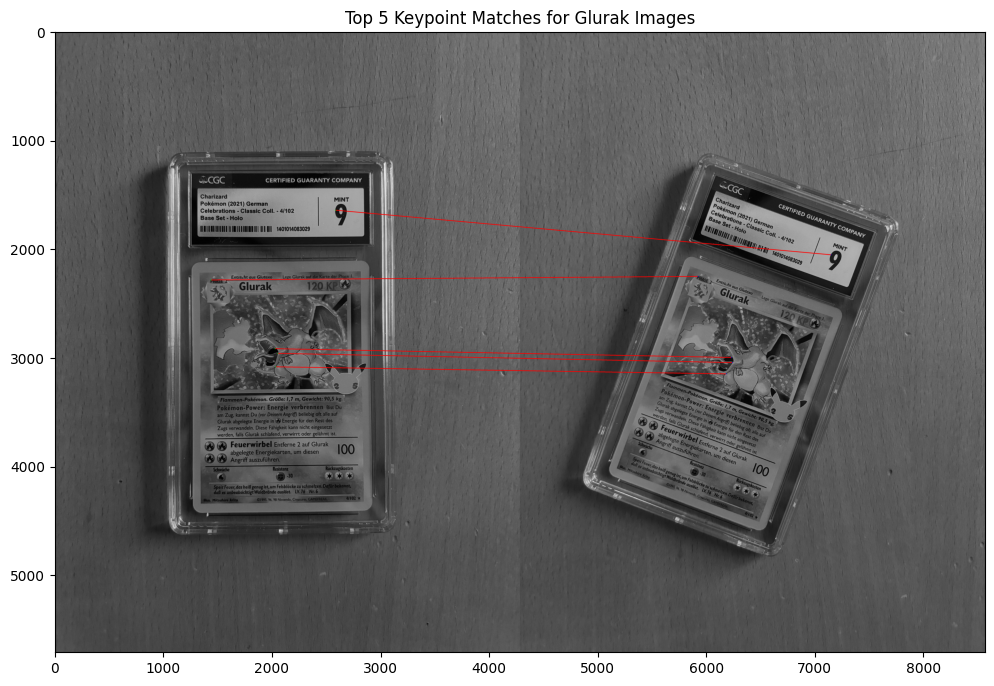

In [51]:
# Erstellen Sie ein leeres Ergebnisbild der entsprechenden Größe
height = max(glurak.shape[0], glurak_schief.shape[0])
width = glurak.shape[1] + glurak_schief.shape[1]
res = np.zeros((height, width, 3), dtype=np.uint8)

# Konvertiere Graustufenbilder zurück in BGR für die farbige Darstellung
glurak_color = cv.cvtColor(glurak, cv.COLOR_GRAY2BGR)
glurak_schief_color = cv.cvtColor(glurak_schief, cv.COLOR_GRAY2BGR)

# Setze die beiden Bilder nebeneinander im Ergebnisbild 'res'
res[:glurak.shape[0], :glurak.shape[1]] = glurak_color
res[:glurak_schief.shape[0], glurak.shape[1]:glurak.shape[1]+glurak_schief.shape[1]] = glurak_schief_color

# Zeichnen der Matches mit individueller Linienstärke
for m in top_5_matches:
    # Start- und Endpunkt für die Linie
    start_point = tuple(np.round(keypoints_glurak[m.queryIdx].pt).astype(int))
    end_point = tuple(np.round(keypoints_glurak_schief[m.trainIdx].pt + np.array([glurak.shape[1], 0])).astype(int))

    # Zeichne die Verbindungslinie
    cv.line(res, start_point, end_point, (255, 0, 0), thickness=5)  # Blaue Linie mit Dicke 2

    # Zeichne die Keypoints
    cv.circle(res, start_point, 4, (0, 255, 0), thickness=-1)  # Grüner Kreis
    cv.circle(res, end_point, 4, (0, 0, 255), thickness=-1)  # Roter Kreis

# Visualisierung des Ergebnisses
plt.figure(figsize=(12, 12))
plt.imshow(res)
plt.title('Top 5 Keypoint Matches for Glurak Images')
plt.show()

# code Quelle ChatGPT

#### Erkenntnisse im Plot

Die fünf wichtigsten Keypoints sind die 9 oben rechts im Bild, die Entwicklungsstufe, oben Links in der Karte und dann noch drei mal Merkmale beim Maul von Glurak. Dies finde ich sehr interessant, da ich gedacht hätte, die drei Sterne unten rechts auf der Karte seien ebenfals eines der wichtigsten Merkmale der Karte. 

Anhand dieser fünf Keypoints, welche gematched wurden, erkennt man gut wie der AKAZE Algorithmus funktinoiert. Diese fünf Punkte werden perfekt getroffen und man kann es gut nachvollziehen, wenn man den roten Linien folgt. 

### 4.e Prüfen der Robustheit mittels Transformationen und unterschiedlichen Bildern

Um die Robustheit des AKAZE Algorithmus zu prüfen, werde ich nun verschiedene Bilder und Transformationen verwenden. 

Am Anfang nehme ich zwei Bilder von Turtok, welche in stark unterschiedlichem Licht aufgenommen wurden.

### Experiment: Keypoints für Turtok

#### Schwierigeres Exampel

Um noch ein spannenderes und vorallem schwierigeres Beispiel zu verwenden, nehme ich das Bild von der Pokémonkarte "Turtok". Turtok ist ein Wasserpokémon aus der ersten Generation und ebenfalls sehr beliebt bei den Fans. 

**Licht** Die Karte habe ich einmal in normalen Lichtverhältnissen fotografiert und einmal in der prallen Sonne. In der Sonne sieht man den "Holo Effekt" der Karte, also das Glänzen besser. 

**Rotation** Die Karte in der Sonne ist auch noch zusätzlich um 90Grad gedreht. Der AKAZE Algorithmus sollte eigentlich gut mit Drehungen in den Bildern zurecht kommen. Dies möchte ich anhand dieses Beispieles herausfinden. 

**Hintergrund** Auch habe ich bei der Sonnigen Karte einen anderen Hintergrund gewählt. (Sofa) Dies könnte eventuell dem Algorithmus erschweren, die wichtigen Keypoints zu finden. 

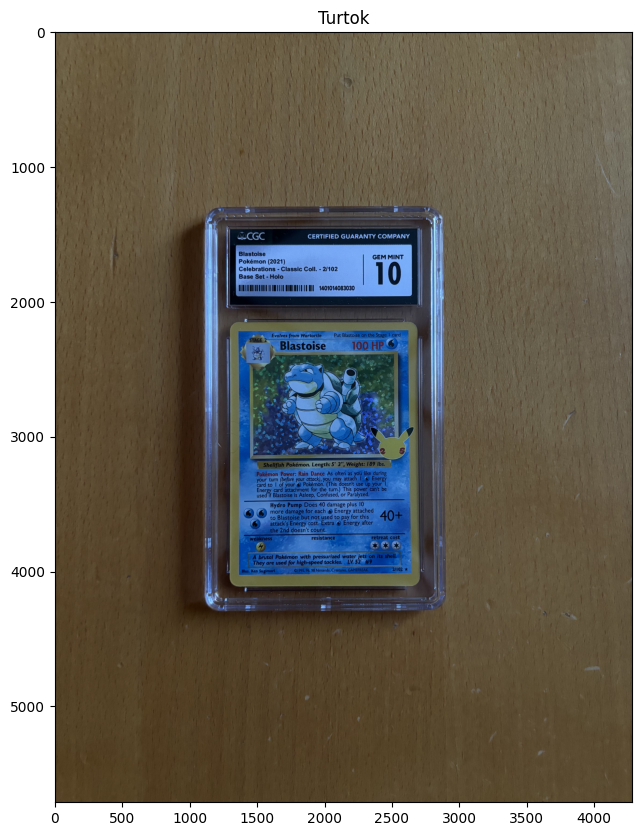

In [52]:
# read jpeg
turtok = cv.imread('turtok.jpg')

# convert to rgb
turtok = cv.cvtColor(turtok, cv.COLOR_BGR2RGB)

plt.figure(figsize=(10, 10))
plt.imshow(turtok)
plt.title("Turtok")
plt.show()

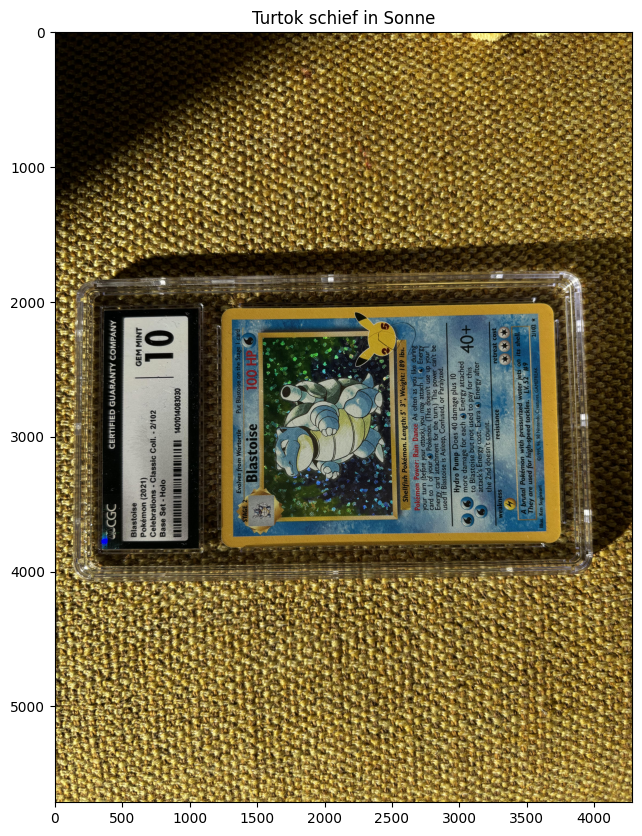

In [53]:
turtok_schief = cv.imread('turtok_sonne_90.jpg')

# convert to rgb
turtok_schief = cv.cvtColor(turtok_schief, cv.COLOR_BGR2RGB)

plt.figure(figsize=(10, 10))
plt.imshow(turtok_schief)
plt.title("Turtok schief in Sonne")
plt.show()

In [54]:
# glurak und glura_schief in graustufen konvertieren
turtok = cv.cvtColor(turtok, cv.COLOR_RGB2GRAY)
turtok_schief = cv.cvtColor(turtok_schief, cv.COLOR_RGB2GRAY)

In [55]:
# use AKAZE to detect Keypoints
akaze = cv.AKAZE_create()
keypoints_turtok, descriptors_turtok = akaze.detectAndCompute(turtok, None)
keypoints_turtok_schief, descriptors_turtok_schief = akaze.detectAndCompute(turtok_schief, None)

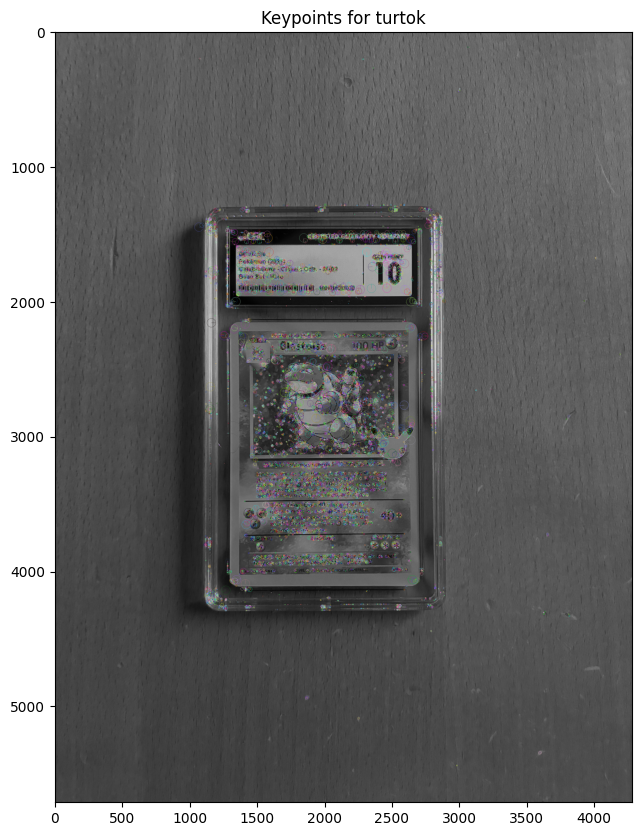

In [56]:
# Visualize the keypoints for Glurak
keypoints_img_tur = cv.drawKeypoints(turtok, keypoints_turtok, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(10, 10))
plt.imshow(keypoints_img_tur)
plt.title("Keypoints for turtok")
plt.show()

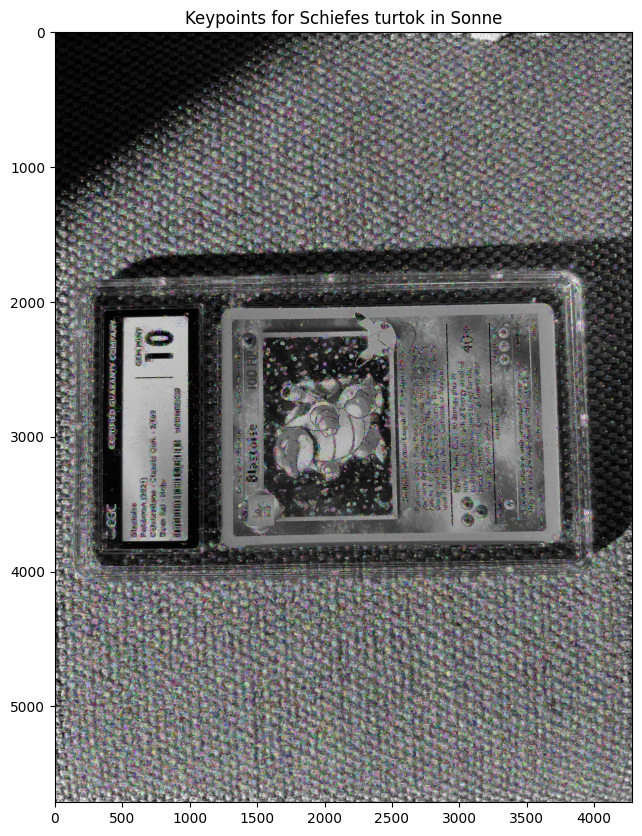

In [57]:
# Display the keypoints for Glurak Schief
keypoints_img_tur_schief = cv.drawKeypoints(turtok_schief, keypoints_turtok_schief, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(10, 10))
plt.imshow(keypoints_img_tur_schief)
plt.title("Keypoints for Schiefes turtok in Sonne")
plt.show()

In [58]:
matcher_tur = cv.DescriptorMatcher_create(cv.DescriptorMatcher_BRUTEFORCE_HAMMING)
nn_matches_tur = matcher.knnMatch(descriptors_turtok, descriptors_turtok_schief, 2)

In [59]:
matched1_tur = []
matched2_tur = []
nn_match_ratio_tur = 0.7 # Nearest neighbor matching ratio
for m, n in nn_matches_tur:
 if m.distance < nn_match_ratio_tur * n.distance:
    matched1_tur.append(keypoints_turtok[m.queryIdx])
    matched2_tur.append(keypoints_turtok_schief[m.trainIdx])

In [60]:
# Homographie berechnen, Punkte umwandeln
if len(matched1_tur) >= 4 and len(matched2_tur) >= 4:
    pts1 = np.float32([kp.pt for kp in matched1_tur])
    pts2 = np.float32([kp.pt for kp in matched2_tur])
    homography, mask = cv.findHomography(pts1, pts2, cv.RANSAC)

In [61]:
inliers1 = []
inliers2 = []
good_matches = []
inlier_threshold = 2.5 # Distance threshold to identify inliers with homography check
for i, m in enumerate(matched1_tur):
 col = np.ones((3,1), dtype=np.float64)
 col[0:2,0] = m.pt
 
 col = np.dot(homography, col)
 col /= col[2,0]
 dist = sqrt(pow(col[0,0] - matched2_tur[i].pt[0], 2) +\
 pow(col[1,0] - matched2_tur[i].pt[1], 2))
 
 if dist < inlier_threshold:
    good_matches.append(cv.DMatch(len(inliers1), len(inliers2), 0))
    inliers1.append(matched1_tur[i])
    inliers2.append(matched2_tur[i])

A-KAZE Matching Results
*******************************
# Keypoints 1: 	 16783
# Keypoints 2: 	 196447
# Matches: 	 2439
# Inliers: 	 1897
# Inliers Ratio: 	 0.7777777777777778


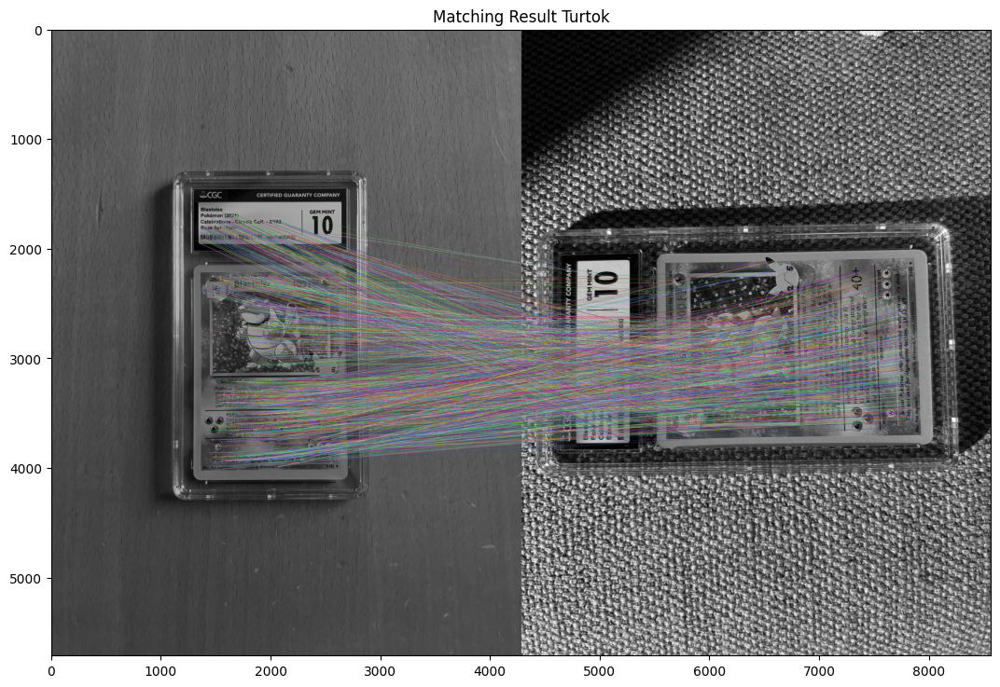

In [62]:
# Erstelle ein leeres Ergebnisbild der entsprechenden Größe
res = np.empty((max(turtok.shape[0], turtok_schief.shape[0]), turtok.shape[1] + turtok_schief.shape[1], 3), dtype=np.uint8)

# Zeichne die guten Matches auf das leere Bild 'res'
cv.drawMatches(turtok, inliers1, turtok_schief, inliers2, good_matches, res)

# Berechne das Verhältnis der Inlier-Matches zu den Gesamtmatches
inlier_ratio = len(inliers1) / float(len(matched1_tur))

# Ausgabe der Ergebnisse
print('A-KAZE Matching Results')
print('*******************************')
print('# Keypoints 1: \t', len(keypoints_turtok))
print('# Keypoints 2: \t', len(keypoints_turtok_schief))
print('# Matches: \t', len(matched1_tur))
print('# Inliers: \t', len(inliers1))
print('# Inliers Ratio: \t', inlier_ratio)

# Zeige das Bild im Notebook an
plt.figure(figsize=(13, 13))  # Größe des Bildes anpassen
plt.imshow(res)  # Keine Farbkonvertierung benötigt, da schon in RGB
plt.title('Matching Result Turtok')
plt.show()

# code Quelle ChatGPT

#### Diskussion der Ergebnisse

**Keypoints 1(16'783) und Keypoints 2 (196'447):**
Auffällig ist, dass das 2. Bild viel mehr Keypoints hat als das 1. Bild. Dies könnte damit zu tun haben, dass das Bild bei hellerem Licht aufgenommen wurde oder dass der Hintergrund im rechten Bild einen anderen Hintergrund (Sofa) hat. 

Die große Diskrepanz zwischen den Keypoints kann problematisch sein, da dies darauf hindeutet, dass die Bilder in Bezug auf Details, Skalierung oder Qualität stark variieren könnten. Mit mehr Zeit, hätte man eventuell noch anpassungen mittels Feature-Reduktion oder ausprobieren von verschiedensten Schwellenwerten. 

**Matches (2'439):**

Die Anzahl ist relativ niedrig im Vergleich zur Anzahl der Keypoints, was die Effektivität des Matchings in Frage stellt.

**Inliers (1897) und Inliers Ratio (0.778):**

Diese sind positiv, da eine hohe Inliers Ratio darauf hindeutet, dass die meisten Matches korrekt sind und die Match-Qualität gut ist.

Insgesamt sind die Ergebnisse gut aufgrund der hohen Inliers Ratio, die Zuverlässigkeit der Matches bestätigt. Die Effizienz könnte jedoch durch Optimierung des Keypoint-Detektionsprozesses verbessert werden.

In [63]:
# Nachdem Sie die Matches mit der NN-Methode gefunden haben
nn_matches = matcher.knnMatch(descriptors_turtok, descriptors_turtok_schief, 2)
all_matches = []

# Filter für gute Matches basierend auf dem Nearest-Neighbor-Distance-Ratio-Test
for m, n in nn_matches:
    if m.distance < nn_match_ratio * n.distance:
        all_matches.append(m)

# Sortieren der Matches nach ihrer Distanz
all_matches = sorted(all_matches, key=lambda x: x.distance)

# Auswahl der besten 5 Matches
top_5_matches = all_matches[:5]  # Ändern Sie diese Zahl nach Bedarf

# code Quelle ChatGPT

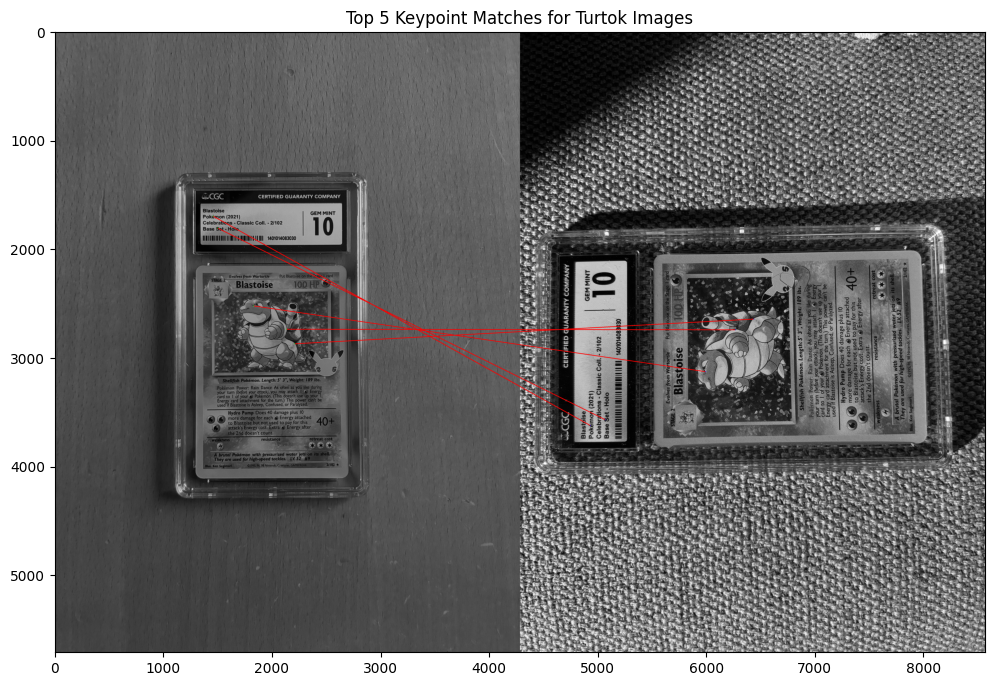

In [64]:
# Erstellen Sie ein leeres Ergebnisbild der entsprechenden Größe
height = max(turtok.shape[0], turtok_schief.shape[0])
width = turtok.shape[1] + turtok_schief.shape[1]
res = np.zeros((height, width, 3), dtype=np.uint8)

# Konvertiere Graustufenbilder zurück in BGR für die farbige Darstellung
turtok_color = cv.cvtColor(turtok, cv.COLOR_GRAY2BGR)
turtok_schief_color = cv.cvtColor(turtok_schief, cv.COLOR_GRAY2BGR)

# Setze die beiden Bilder nebeneinander im Ergebnisbild 'res'
res[:turtok.shape[0], :turtok.shape[1]] = turtok_color
res[:turtok_schief.shape[0], turtok.shape[1]:turtok.shape[1]+turtok_schief.shape[1]] = turtok_schief_color

# Zeichnen der Matches mit individueller Linienstärke
for m in top_5_matches:
    # Start- und Endpunkt für die Linie
    start_point = tuple(np.round(keypoints_turtok[m.queryIdx].pt).astype(int))
    end_point = tuple(np.round(keypoints_turtok_schief[m.trainIdx].pt + np.array([turtok.shape[1], 0])).astype(int))

    # Zeichne die Verbindungslinie
    cv.line(res, start_point, end_point, (255, 0, 0), thickness=5)  # Blaue Linie mit Dicke 2

    # Zeichne die Keypoints
    cv.circle(res, start_point, 4, (0, 255, 0), thickness=-1)  # Grüner Kreis
    cv.circle(res, end_point, 4, (0, 0, 255), thickness=-1)  # Roter Kreis

# Visualisierung des Ergebnisses
plt.figure(figsize=(12, 12))
plt.imshow(res)
plt.title('Top 5 Keypoint Matches for Turtok Images')
plt.show()

# code Quelle ChatGPT

### Erkenntnisse im Plot: 

Die fünf Top Keypoints in den Turtok Bildern besteht aus 2x dem Text in der Bewertung oben an der Karte und 1x aus dem Kopf, 1x Arm und 1x dem Bein von Turtok. Diese fünf Keypoints konnten durch den AKAZE Algorithmus sehr gut gematched werden. Wenn man den roten Verbingdungslinien folgt, sieht man 

### Experiment: Keypoints für alle drei Starterpokémon

Als letztes nimmt es mich wunder, wie der AKAZE Algorithmus damit umgehen kann, wenn ich ein Bild habe mit drei ähnlichen Objekten drin. Dabei habe ich ein Foto gemacht von den Pokemonkarten der drei Starterpokémon. Glurak, Bisaflor und Turtok. Die Bisaflor und Turtok Karte haben beide eine CGC Bewertung von 10 erhalten, was bedeutet, dass sie in perfektem Zustand sind. Die 10 auf der Hülle könnte den Algorithmus eventuell verwirren, da sie auf beiden Karten vor kommt. 

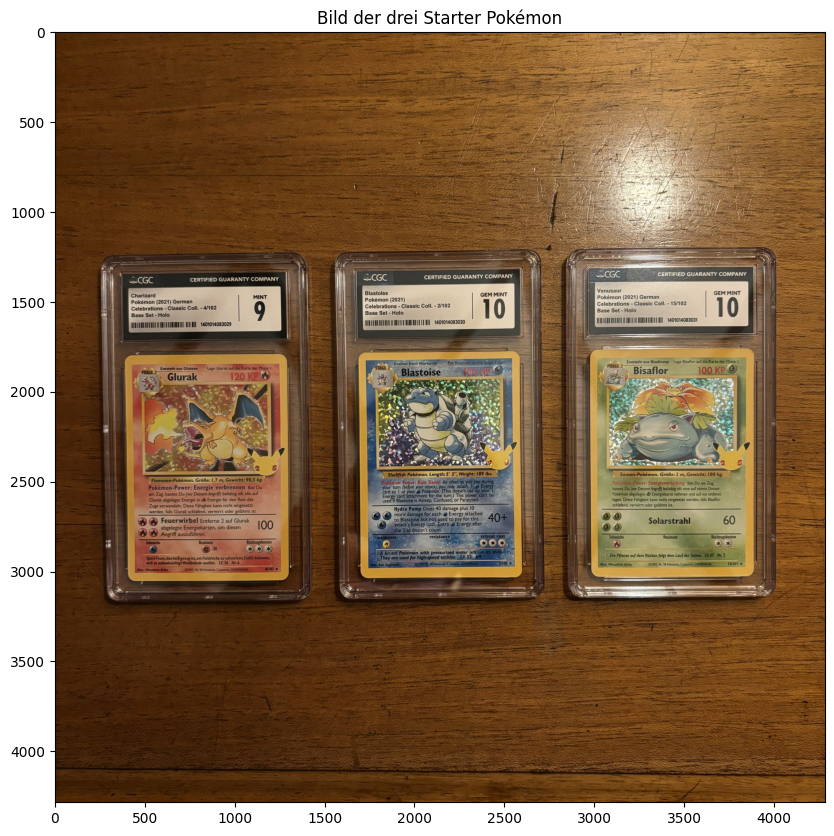

In [65]:
# read jpeg
starter = cv.imread('starter.jpg')

# convert to rgb
starter = cv.cvtColor(starter, cv.COLOR_BGR2RGB)

plt.figure(figsize=(10, 10))
plt.imshow(starter)
plt.title("Bild der drei Starter Pokémon")
plt.show()

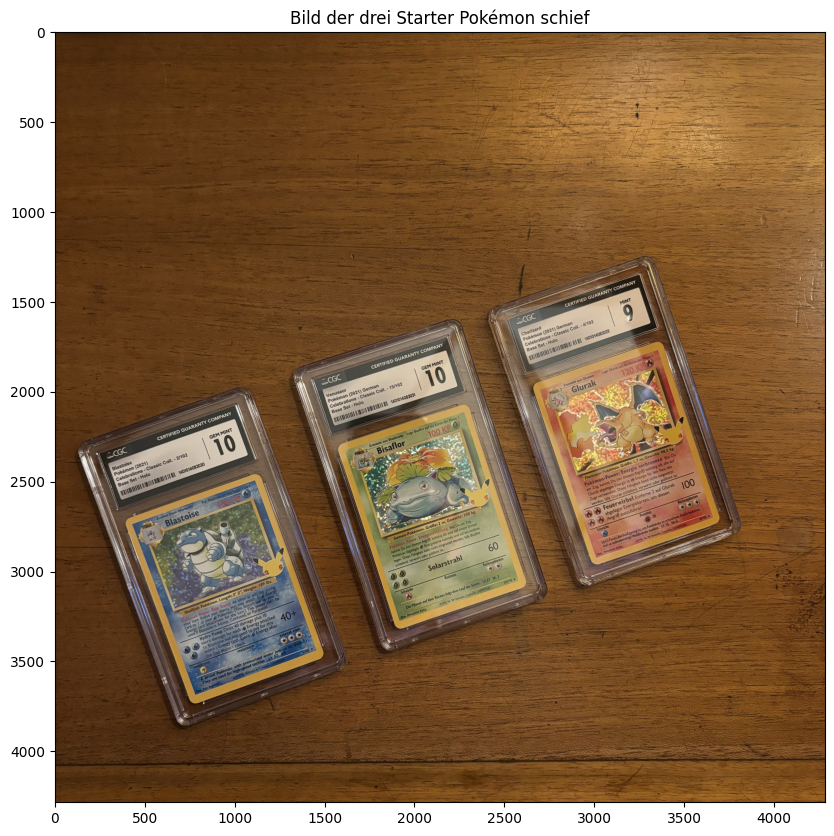

In [66]:
starter_schief = cv.imread('starter_schief.jpg')

# convert to rgb
starter_schief = cv.cvtColor(starter_schief, cv.COLOR_BGR2RGB)

plt.figure(figsize=(10, 10))
plt.imshow(starter_schief)
plt.title("Bild der drei Starter Pokémon schief")
plt.show()

In [67]:
# glurak und glura_schief in graustufen konvertieren
starter = cv.cvtColor(starter, cv.COLOR_RGB2GRAY)
starter_schief = cv.cvtColor(starter_schief, cv.COLOR_RGB2GRAY)

In [68]:
# use AKAZE to detect Keypoints
akaze = cv.AKAZE_create()
keypoints_starter, descriptors_starter = akaze.detectAndCompute(starter, None)
keypoints_starter_schief, descriptors_starter_schief = akaze.detectAndCompute(starter_schief, None)

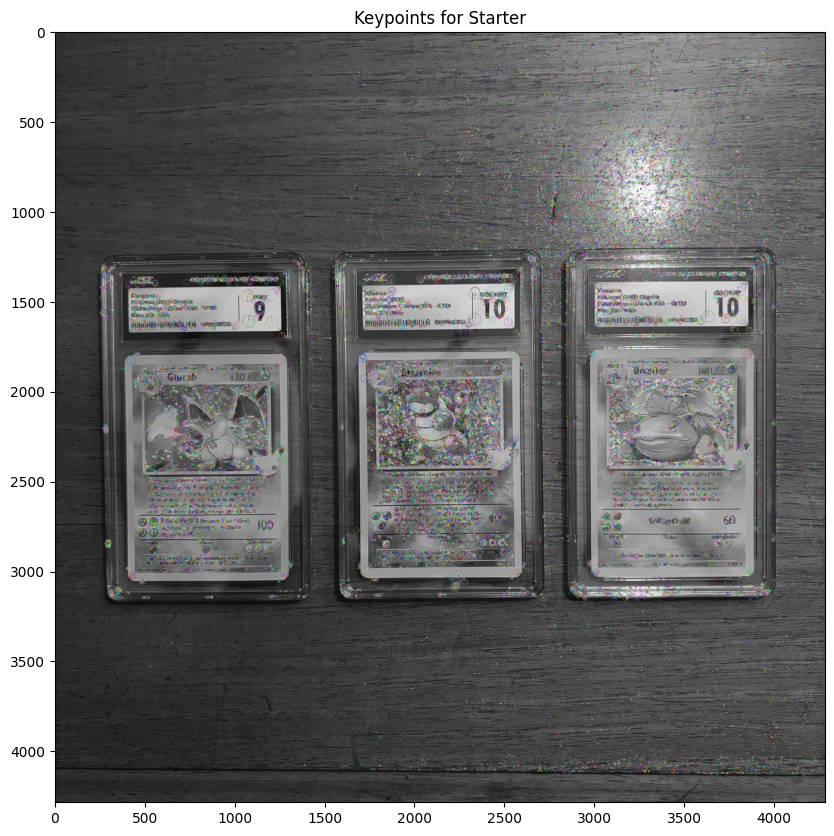

In [69]:
# Visualize the keypoints for Glurak
keypoints_img = cv.drawKeypoints(starter, keypoints_starter, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(10, 10))
plt.imshow(keypoints_img)
plt.title("Keypoints for Starter")
plt.show()

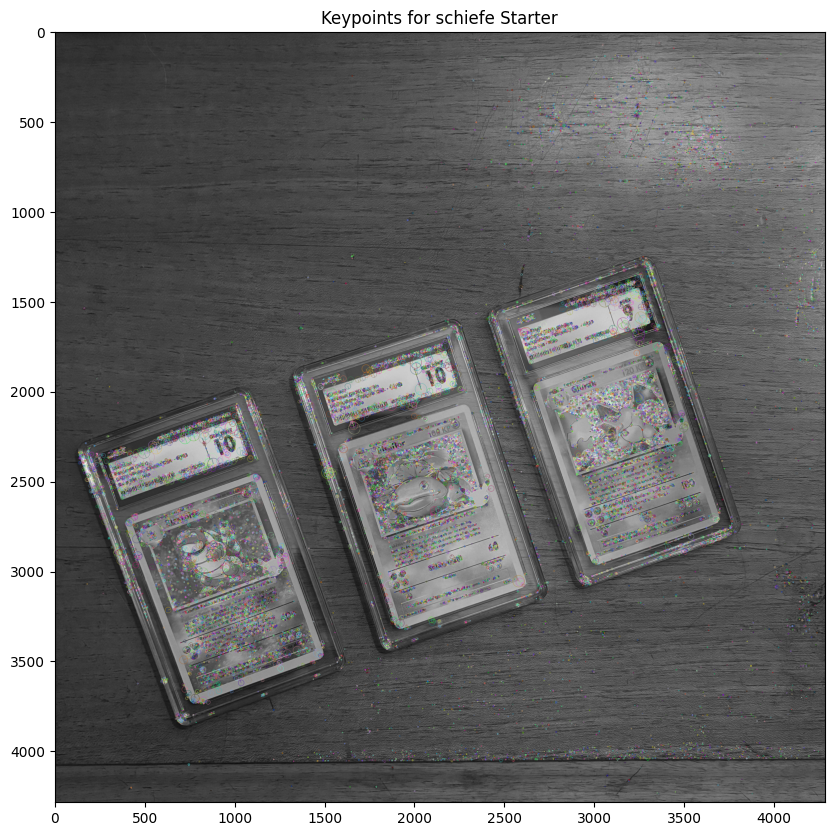

In [70]:
# Display the keypoints for Glurak Schief
keypoints_img_schief = cv.drawKeypoints(starter_schief, keypoints_starter_schief, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(10, 10))
plt.imshow(keypoints_img_schief)
plt.title("Keypoints for schiefe Starter")
plt.show()

In [71]:
matcher = cv.DescriptorMatcher_create(cv.DescriptorMatcher_BRUTEFORCE_HAMMING)
nn_matches = matcher.knnMatch(descriptors_starter, descriptors_starter_schief, 2)

In [72]:
matched1 = []
matched2 = []
nn_match_ratio = 0.4 # Nearest neighbor matching ratio
for m, n in nn_matches:
 if m.distance < nn_match_ratio * n.distance:
    matched1.append(keypoints_starter[m.queryIdx])
    matched2.append(keypoints_starter_schief[m.trainIdx])

#### Wahl der Parameter

Ich habe hier die **nn_match_ratio** auf 0.4 gesetzt. Dies ist tiefer als in den obigen Beispielen. Die tiefere nn_match_ratio bedeutet, dass die initiale Auswahl von Matches strenger wird, wodurch die Qualität der ausgewählten Matches steigt. Da diese Matches genauer sind, bestehen sie eher die weiteren Tests und tragen zu einer höheren Inliers-Ratio bei. Mit einer nn_match_ratio von 0.7 kam ich bei der Auswertung auf eine ziemlich schlechte Inliers Ratio, weshalb ich mich für einen tieferen Wert entschieden habe. 

In [73]:
# Homographie berechnen, Punkte umwandeln
if len(matched1) >= 4 and len(matched2) >= 4:
    pts1 = np.float32([kp.pt for kp in matched1])
    pts2 = np.float32([kp.pt for kp in matched2])
    homography, mask = cv.findHomography(pts1, pts2, cv.RANSAC)

In [74]:
inliers1 = []
inliers2 = []
good_matches = []
inlier_threshold = 2.5 # Distance threshold to identify inliers with homography check
for i, m in enumerate(matched1):
 col = np.ones((3,1), dtype=np.float64)
 col[0:2,0] = m.pt
 
 col = np.dot(homography, col)
 col /= col[2,0]
 dist = sqrt(pow(col[0,0] - matched2[i].pt[0], 2) +\
 pow(col[1,0] - matched2[i].pt[1], 2))
 
 if dist < inlier_threshold:
    good_matches.append(cv.DMatch(len(inliers1), len(inliers2), 0))
    inliers1.append(matched1[i])
    inliers2.append(matched2[i])

A-KAZE Matching Results
*******************************
# Keypoints 1: 	 42106
# Keypoints 2: 	 26421
# Matches: 	 40
# Inliers: 	 28
# Inliers Ratio: 	 0.7


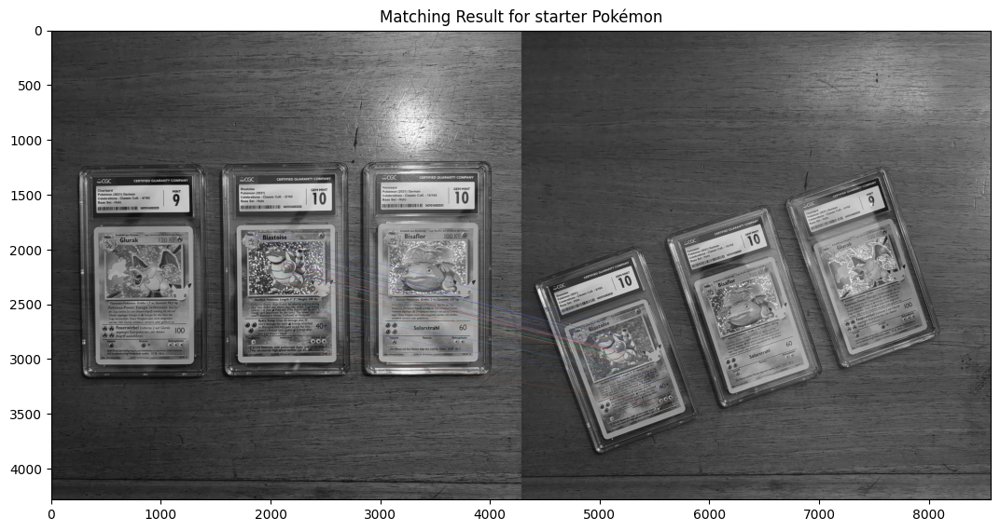

In [75]:
# Erstelle ein leeres Ergebnisbild der entsprechenden Größe
res = np.empty((max(starter.shape[0], starter_schief.shape[0]), starter.shape[1] + starter_schief.shape[1], 3), dtype=np.uint8)

# Zeichne die guten Matches auf das leere Bild 'res'
cv.drawMatches(starter, inliers1, starter_schief, inliers2, good_matches, res)

# Berechne das Verhältnis der Inlier-Matches zu den Gesamtmatches
inlier_ratio = len(inliers1) / float(len(matched1))

# Ausgabe der Ergebnisse
print('A-KAZE Matching Results')
print('*******************************')
print('# Keypoints 1: \t', len(keypoints_starter))
print('# Keypoints 2: \t', len(keypoints_starter_schief))
print('# Matches: \t', len(matched1))
print('# Inliers: \t', len(inliers1))
print('# Inliers Ratio: \t', inlier_ratio)

# Zeige das Bild im Notebook an
plt.figure(figsize=(13, 13))  # Größe des Bildes anpassen
plt.imshow(res)  # Keine Farbkonvertierung benötigt, da schon in RGB
plt.title('Matching Result for starter Pokémon')
plt.show()

# code Quelle ChatGPT

#### Diskussion der Ergebnisse:

**Keypoints 1 (42106) und Keypoints 2 (26421):**

Die Anzahl der Keypoints ist zwischen den beiden Bildern unterschiedlich, was auf Variationen in den Bildinhalten oder -qualitäten hinweisen könnte. Das erste Bild hat deutlich mehr detektierte Keypoints, was auf eine höhere Detaildichte oder Bildkomplexität hinweisen könnte.

Diese Diskrepanz könnte das Matching erschweren, da möglicherweise nicht für jeden Keypoint im ersten Bild ein entsprechendes Pendant im zweiten Bild gefunden wird.

**Matches (40):**

Trotz der hohen Anzahl von Keypoints in beiden Bildern ist die Anzahl der Matches relativ gering. Dies könnte darauf hinweisen, dass die Bilder sich stark unterscheiden oder dass die Einstellungen für den Matching-Prozess sehr restriktiv sind.
Bewertung: Eine geringe Anzahl von Matches könnte problematisch sein, da sie die Basis für nachfolgende Analysen wie Homographie oder Bildregistrierung schmälert, besonders wenn eine breitere Datenbasis wünschenswert wäre.

**Inliers (28) und Inliers Ratio (0.7):**

Von den 40 Matches sind 28 als Inliers klassifiziert, was eine Inliers Ratio von 0.7 ergibt. Dies zeigt, dass ein grosser Anteil der Matches geometrisch konsistent ist und die Homographiebestimmung bestanden hat.
Bewertung: Die Inliers Ratio von 70% ist positiv zu bewerten, da sie darauf hindeutet, dass die meisten gefundenen Matches zuverlässig sind. Dies ist ein Indikator für eine effektive Identifizierung und Validierung der Matches durch den verwendeten Algorithmus.

**Gesamtbewertung:**

Die Ergebnisse sind gemischt. Während die Inliers Ratio gut ist und auf qualitativ hochwertige Matches hinweist, könnte die niedrige Gesamtzahl der Matches ein Hinweis auf Probleme bei der initialen Keypoint-Erkennung oder beim Matching-Prozess sein. Es könnte sinnvoll sein, die Parameter der Keypoint-Detektion oder des Matchings zu überprüfen und gegebenenfalls anzupassen, um die Anzahl der Matches zu erhöhen und die Übereinstimmung zwischen den Bildern weiter zu verbessern.

Quelle ChatGPT

### Erkenntnisse im Plot: 

Es ist zu erkennen, dass der Algorithmus eigentlich nur, oder vor Allem die Turtok karte (im linken Bild in der Mitte und im rechten Bild links) als wichtig anerkannt hat. Die Vergindungen der Keypoints sehen aber ziemlich akkurat aus. 

In [76]:
# Nachdem Sie die Matches mit der NN-Methode gefunden haben
nn_matches = matcher.knnMatch(descriptors_starter, descriptors_starter_schief, 2)
all_matches = []

# Filter für gute Matches basierend auf dem Nearest-Neighbor-Distance-Ratio-Test
for m, n in nn_matches:
    if m.distance < nn_match_ratio * n.distance:
        all_matches.append(m)

# Sortieren der Matches nach ihrer Distanz
all_matches = sorted(all_matches, key=lambda x: x.distance)

# Auswahl der besten 5 Matches
top_5_matches = all_matches[:5]  # Ändern Sie diese Zahl nach Bedarf

# code Quelle ChatGPT

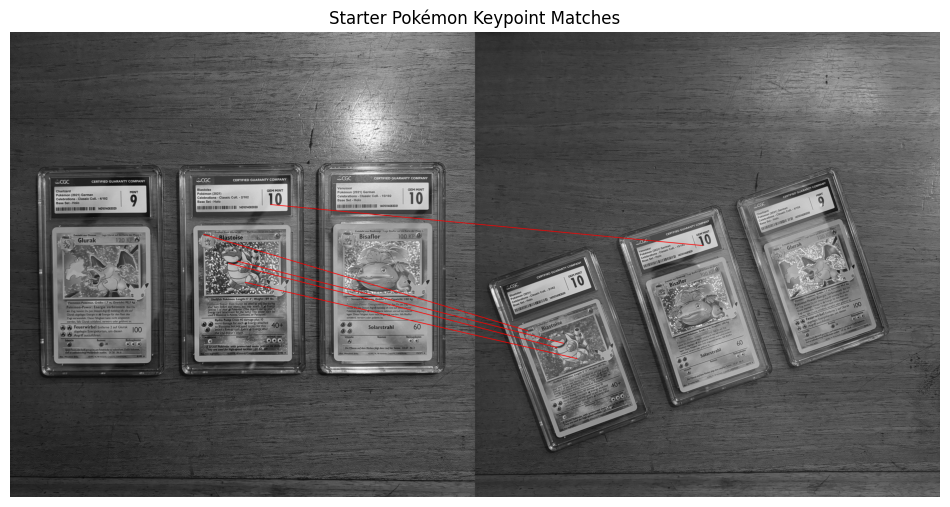

In [77]:
# Erstellen Sie ein leeres Ergebnisbild der entsprechenden Größe
height = max(starter.shape[0], starter_schief.shape[0])
width = starter.shape[1] + starter_schief.shape[1]
res = np.zeros((height, width, 3), dtype=np.uint8)

# Konvertiere Graustufenbilder zurück in BGR für die farbige Darstellung
starter_color = cv.cvtColor(starter, cv.COLOR_GRAY2BGR)
starter_schief_color = cv.cvtColor(starter_schief, cv.COLOR_GRAY2BGR)

# Setze die beiden Bilder nebeneinander im Ergebnisbild 'res'
res[:starter.shape[0], :starter.shape[1]] = starter_color
res[:starter_schief.shape[0], starter.shape[1]:starter.shape[1]+starter_schief.shape[1]] = starter_schief_color

# Zeichnen der Matches mit individueller Linienstärke
for m in top_5_matches:
    # Start- und Endpunkt für die Linie
    start_point = tuple(np.round(keypoints_starter[m.queryIdx].pt).astype(int))
    end_point = tuple(np.round(keypoints_starter_schief[m.trainIdx].pt + np.array([starter.shape[1], 0])).astype(int))

    # Zeichne die Verbindungslinie
    cv.line(res, start_point, end_point, (255, 0, 0), thickness=5)  # Blaue Linie mit Dicke 2

  
# Visualisierung des Ergebnisses
plt.figure(figsize=(12, 12))
plt.imshow(res)
plt.title('Starter Pokémon Keypoint Matches')
plt.axis('off')
plt.show()

# code Quelle ChatGPT

### Erkenntnisse aus dem Plot:

Wie gedacht, kam es bei dem Keypoint Matching zu Problemen, weil Bisaflor und Turtok mit einer 10 bewertet wurden. Wir erkennen gut, dass der Algorithmus im Bild links die 1 von der 10 oberhalb der Turtok Karte, mit der 1 von der Bisaflor Karte (im rechten Bild) gematched hat. 

Die restlichen Keypoints dafür wurden präzise und korrekt erkannt. Die wichtigsten Merkmale abgesehen von der 10 sind anscheinend alle in der Turtok Karte vorhanden. Diese wurden auch alle vier auf das schräge Turtok gematched.

### Experiment: Keypoints für 90 grad Rotierte Glurak Bilder

Um noch weiter zu prüfen, wie robust AKAZE Algorithmus ist, werde ich die Bilder von Glurak nochmals nehmen und diese Transformieren. Ich werde beide um 90 grad drehen und den Algorithmus danach nochmals anwenden und schauen, ob er immernoch zuverlässig die Keypoints erkennen und matchen kann. 

Eigentlich sollte der Akaze Algorithmus dazu im Stande sein. Der Algorithmus wurde entwickelt, um eine verbesserte Leistung bei der Erkennung von Schlüsselpunkten und der Deskriptorextraktion in Bildern zu bieten, besonders bei **Variationen in Rotation,** Skalierung und Rauschen.

In [78]:
glurak = cv.imread('glurak.jpg')
glurak_schief = cv.imread('glurak_schief.jpg')

# bildoperation, welche die bilder dreht um 90 Grad
def rotate_image(image, angle):
    # Bildhöhe und -breite
    height, width = image.shape[:2]
    # Rotationsmatrix berechnen
    rotation_matrix = cv.getRotationMatrix2D((width / 2, height / 2), angle, 1)
    # Bild rotieren
    rotated_image = cv.warpAffine(image, rotation_matrix, (width, height))
    return rotated_image

# Bild um 90 Grad drehen
glurak_90 = rotate_image(glurak, 90)
glurak_schief_90 = rotate_image(glurak_schief, 90)

# bilder in graustufen konvertieren
glurak_90 = cv.cvtColor(glurak_90, cv.COLOR_RGB2GRAY)
glurak_schief_90 = cv.cvtColor(glurak_schief_90, cv.COLOR_RGB2GRAY)

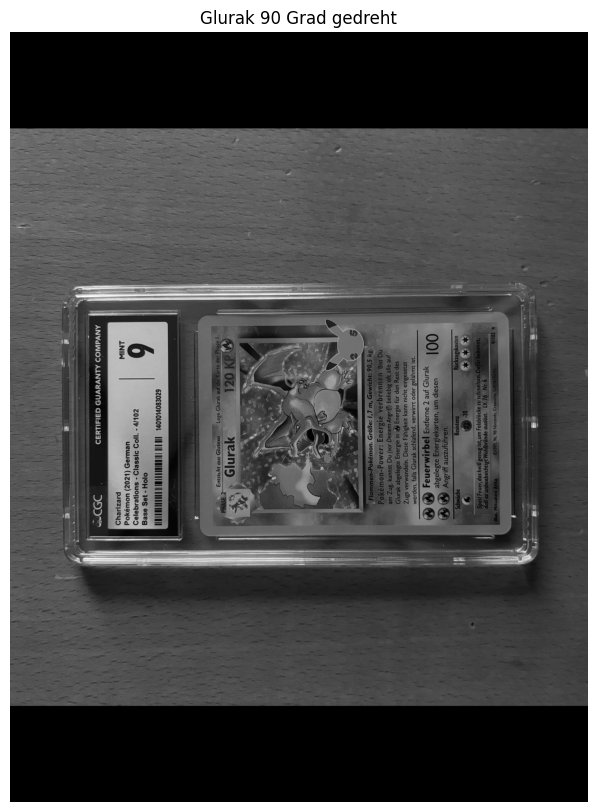

In [79]:
plt.figure(figsize=(10, 10))
plt.imshow(glurak_90, cmap='gray')
plt.title("Glurak 90 Grad gedreht")
plt.axis('off')
plt.show()

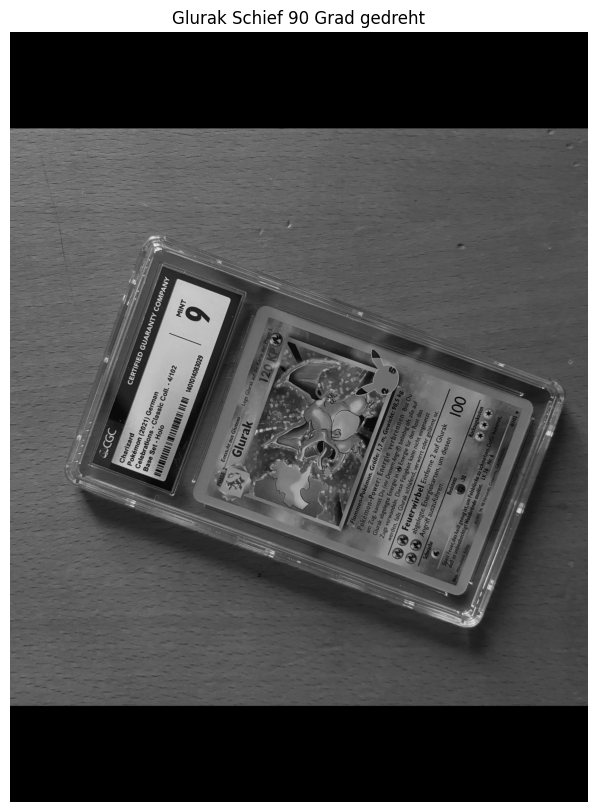

In [80]:
# plot glurak schief 90
plt.figure(figsize=(10, 10))
plt.imshow(glurak_schief_90, cmap='gray')
plt.title("Glurak Schief 90 Grad gedreht")
plt.axis('off')
plt.show()

In [81]:
# use AKAZE to detect Keypoints
akaze = cv.AKAZE_create()
keypoints_glurak, descriptors_glurak = akaze.detectAndCompute(glurak_90, None)
keypoints_glurak_schief, descriptors_glurak_schief = akaze.detectAndCompute(glurak_schief_90, None)


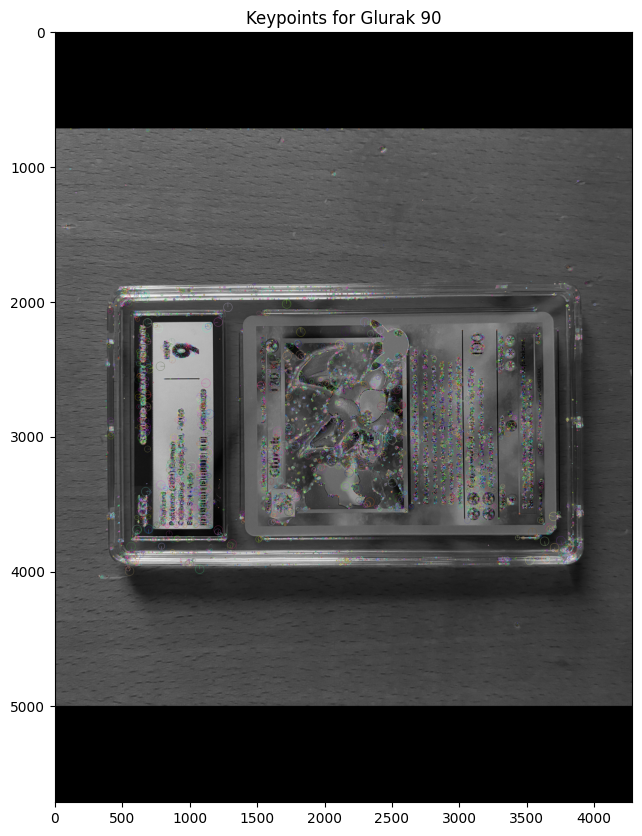

In [82]:
# Visualize the keypoints for Glurak
keypoints_img = cv.drawKeypoints(glurak_90, keypoints_glurak, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(10, 10))
plt.imshow(keypoints_img)
plt.title("Keypoints for Glurak 90")
plt.show()

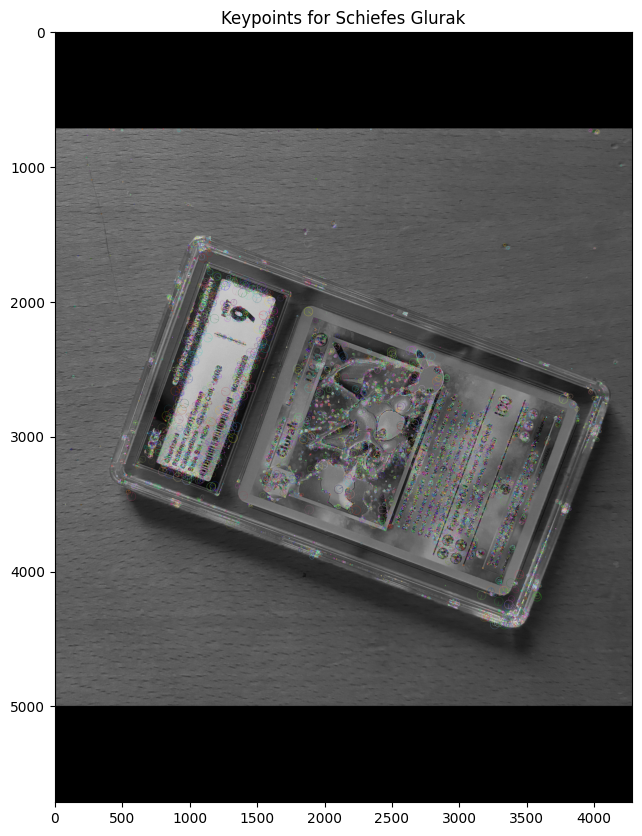

In [83]:
# Display the keypoints for Glurak Schief
keypoints_img_schief = cv.drawKeypoints(glurak_schief_90, keypoints_glurak_schief, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(10, 10))
plt.imshow(keypoints_img_schief)
plt.title("Keypoints for Schiefes Glurak")
plt.show()

In [84]:
matcher = cv.DescriptorMatcher_create(cv.DescriptorMatcher_BRUTEFORCE_HAMMING)
nn_matches = matcher.knnMatch(descriptors_glurak, descriptors_glurak_schief, 2)

In [85]:
matched1 = []
matched2 = []
nn_match_ratio = 0.7 # Nearest neighbor matching ratio
for m, n in nn_matches:
 if m.distance < nn_match_ratio * n.distance:
    matched1.append(keypoints_glurak[m.queryIdx])
    matched2.append(keypoints_glurak_schief[m.trainIdx])

# Homographie berechnen, Punkte umwandeln
if len(matched1) >= 4 and len(matched2) >= 4:
    pts1 = np.float32([kp.pt for kp in matched1])
    pts2 = np.float32([kp.pt for kp in matched2])
    homography, mask = cv.findHomography(pts1, pts2, cv.RANSAC)

inliers1 = []
inliers2 = []
good_matches = []
inlier_threshold = 2.5 # Distance threshold to identify inliers with homography check
for i, m in enumerate(matched1):
 col = np.ones((3,1), dtype=np.float64)
 col[0:2,0] = m.pt
 
 col = np.dot(homography, col)
 col /= col[2,0]
 dist = sqrt(pow(col[0,0] - matched2[i].pt[0], 2) +\
 pow(col[1,0] - matched2[i].pt[1], 2))
 
 if dist < inlier_threshold:
    good_matches.append(cv.DMatch(len(inliers1), len(inliers2), 0))
    inliers1.append(matched1[i])
    inliers2.append(matched2[i])



A-KAZE Matching Results
*******************************
# Keypoints 1: 	 18976
# Keypoints 2: 	 19456
# Matches: 	 5663
# Inliers: 	 4738
# Inliers Ratio: 	 0.8366590146565425


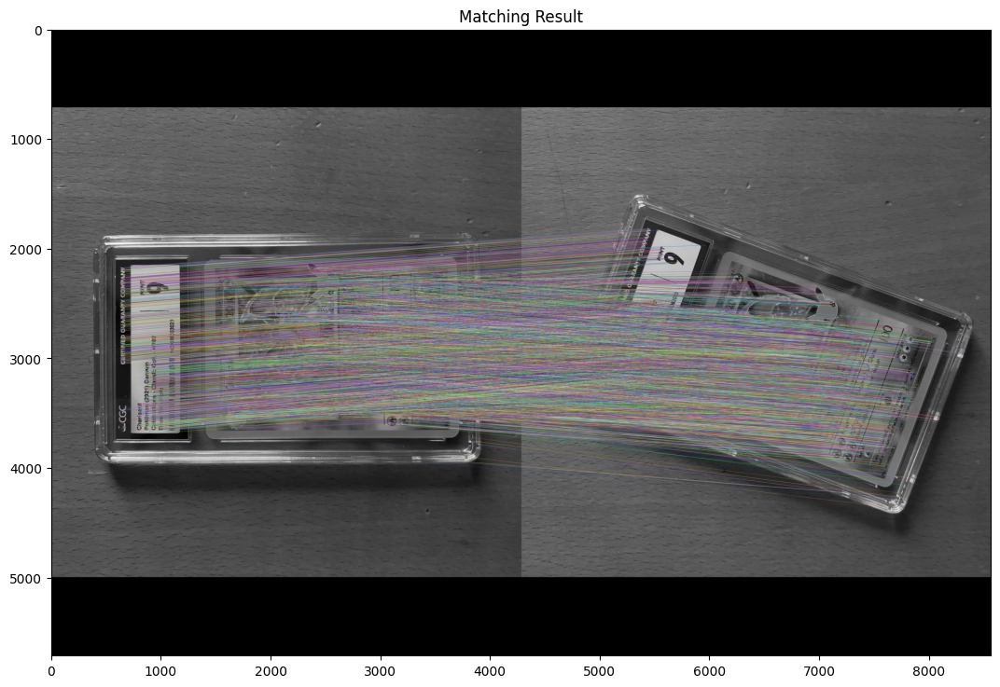

In [86]:
# Erstelle ein leeres Ergebnisbild der entsprechenden Größe
res = np.empty((max(glurak_90.shape[0], glurak_schief_90.shape[0]), glurak_90.shape[1] + glurak_schief_90.shape[1], 3), dtype=np.uint8)

# Zeichne die guten Matches auf das leere Bild 'res'
cv.drawMatches(glurak_90, inliers1, glurak_schief_90, inliers2, good_matches, res)

# Berechne das Verhältnis der Inlier-Matches zu den Gesamtmatches
inlier_ratio = len(inliers1) / float(len(matched1))

# Ausgabe der Ergebnisse
print('A-KAZE Matching Results')
print('*******************************')
print('# Keypoints 1: \t', len(keypoints_glurak))
print('# Keypoints 2: \t', len(keypoints_glurak_schief))
print('# Matches: \t', len(matched1))
print('# Inliers: \t', len(inliers1))
print('# Inliers Ratio: \t', inlier_ratio)

# Zeige das Bild im Notebook an
plt.figure(figsize=(13, 13))  # Größe des Bildes anpassen
plt.imshow(res)  # Keine Farbkonvertierung benötigt, da schon in RGB
plt.title('Matching Result')
plt.show()


#### Kurze Interpretation der Ergebnisse:

**Keypoints 1: 18221**
Die Anzahl der identifizierten Keypoints im ersten Bild.

**Keypoints 2: 18248**
Die Anzahl der Keypoints im zweiten Bild, ähnlich hoch wie im ersten.

**Matches: 5408**
Die Anzahl der Punkte, die zwischen beiden Bildern erfolgreich abgeglichen wurden.

**Inliers: 4608**
Anzahl der Matches, die geometrisch konsistent sind und daher als zuverlässig gelten.

**Inliers Ratio: 0.852**
Etwa 85,2% der Matches sind zuverlässig, was auf eine gute Übereinstimmung hinweist.

#### Top 10 Keypoints suchen

In [87]:
# Erstellen der nn_matches
nn_matches = matcher.knnMatch(descriptors_glurak, descriptors_glurak_schief, 2)
all_matches = []

# Filter für gute Matches basierend auf dem Nearest-Neighbor-Distance-Ratio-Test
for m, n in nn_matches:
    if m.distance < nn_match_ratio * n.distance:
        all_matches.append(m)

# Sortieren der Matches nach ihrer Distanz
all_matches = sorted(all_matches, key=lambda x: x.distance)

# Auswahl der besten 30 Matches
top_matches = all_matches[:10]  # Ändern Sie diese Zahl nach Bedarf

# code Quelle ChatGPT

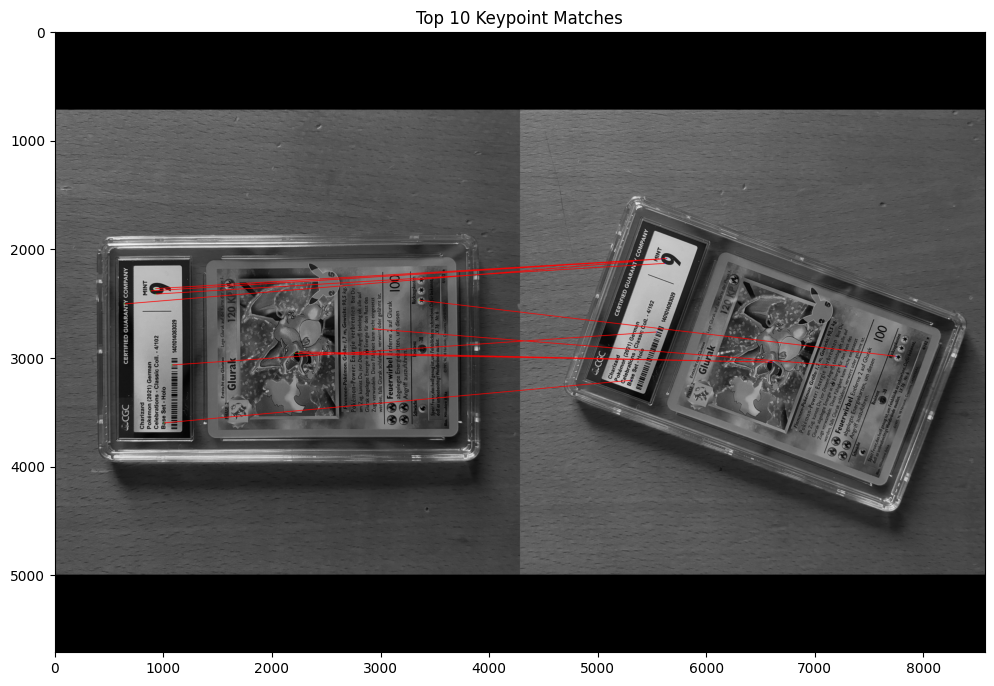

In [88]:
# Erstellen Sie ein leeres Ergebnisbild der entsprechenden Größe
height = max(glurak_90.shape[0], glurak_schief_90.shape[0])
width = glurak_90.shape[1] + glurak_schief_90.shape[1]
res = np.zeros((height, width, 3), dtype=np.uint8)

# Konvertiere Graustufenbilder zurück in BGR für die farbige Darstellung
glurak_color_90 = cv.cvtColor(glurak_90, cv.COLOR_GRAY2BGR)
glurak_schief_color_90 = cv.cvtColor(glurak_schief_90, cv.COLOR_GRAY2BGR)

# Setze die beiden Bilder nebeneinander im Ergebnisbild 'res'
res[:glurak_90.shape[0], :glurak_90.shape[1]] = glurak_color_90
res[:glurak_schief_90.shape[0], glurak_90.shape[1]:glurak_90.shape[1]+glurak_schief_90.shape[1]] = glurak_schief_color_90

# Zeichnen der Matches mit individueller Linienstärke
for m in top_matches:
    # Start- und Endpunkt für die Linie
    start_point = tuple(np.round(keypoints_glurak[m.queryIdx].pt).astype(int))
    end_point = tuple(np.round(keypoints_glurak_schief[m.trainIdx].pt + np.array([glurak.shape[1], 0])).astype(int))

    # Zeichne die Verbindungslinie
    cv.line(res, start_point, end_point, (255, 0, 0), thickness=5)  # Blaue Linie mit Dicke 5

    # Zeichne die Keypoints
    cv.circle(res, start_point, 4, (0, 255, 0), thickness=-1)  # Grüner Kreis
    cv.circle(res, end_point, 4, (0, 0, 255), thickness=-1)  # Roter Kreis

# Visualisierung des Ergebnisses
plt.figure(figsize=(12, 12))
plt.imshow(res)
plt.title('Top 10 Keypoint Matches')
plt.show()

# code Quelle ChatGPT

#### Erkenntnisse im Plot, nach der Transformation um 90grad

Die Keypoints können auch nach der Transformation von 90 grad nach Links immernoch sehr gut erkannt und gmatched werden. 

Auch hier ist wieder das Maul von Glurak sehr markannt, da gleich 2 Linien von Mund zu Mund verbunden sind. Auch die Zahl 9 (die Bewertung vom Grading) ist sehr Informationsreich.

### Experiment: Keypoints für verschiedene Beleuchtungen (GAMMA)

Als letztes Experiment habe ich für die beiden Glurak Bilder, jeweils eines Heller und eines Dunkler gemacht mittels Gammawertanpassung. Nun bin ich gespannt, ob der AKAZE Algroithmus auch damit umgehen kann. 

In [89]:
glurak = cv.imread('glurak.jpg')
glurak_schief = cv.imread('glurak_schief.jpg')

# gamma korrektur für glurak und glurak_schief
def gamma_correction(image, gamma=1.0):
    # build a lookup table mapping the pixel values [0, 255] to
    # their adjusted gamma values
    invGamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** invGamma) * 255
        for i in np.arange(0, 256)]).astype("uint8")
    # apply gamma correction using the lookup table
    return cv.LUT(image, table)

# gamma korrektur für glurak und glurak_schief
glurak_gamma = gamma_correction(glurak, gamma=0.5)
glurak_schief_gamma = gamma_correction(glurak_schief, gamma=1.5)

# in graustufen konvertieren
glurak_gamma = cv.cvtColor(glurak_gamma, cv.COLOR_RGB2GRAY)
glurak_schief_gamma = cv.cvtColor(glurak_schief_gamma, cv.COLOR_RGB2GRAY)

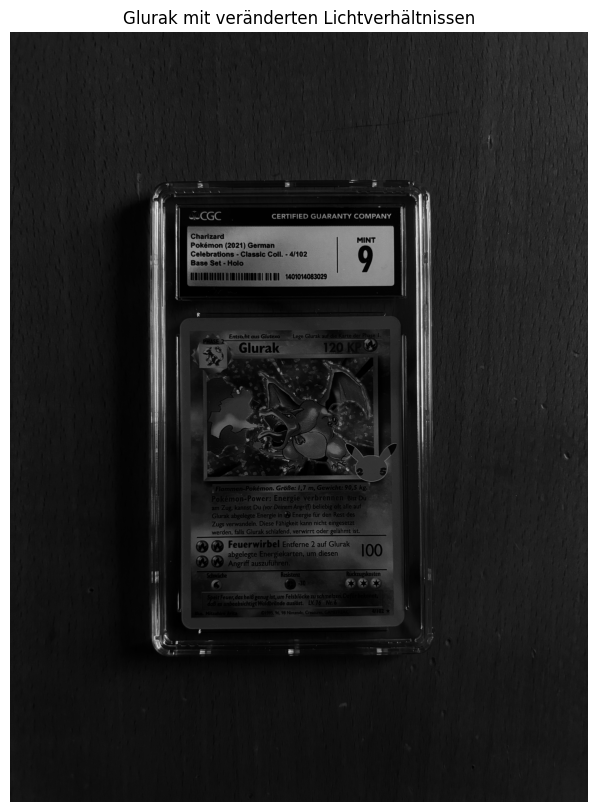

In [90]:
# bilder anzeigen
plt.figure(figsize=(10, 10))
plt.imshow(glurak_gamma, cmap='gray')
plt.title("Glurak mit veränderten Lichtverhältnissen")
plt.axis('off')
plt.show()

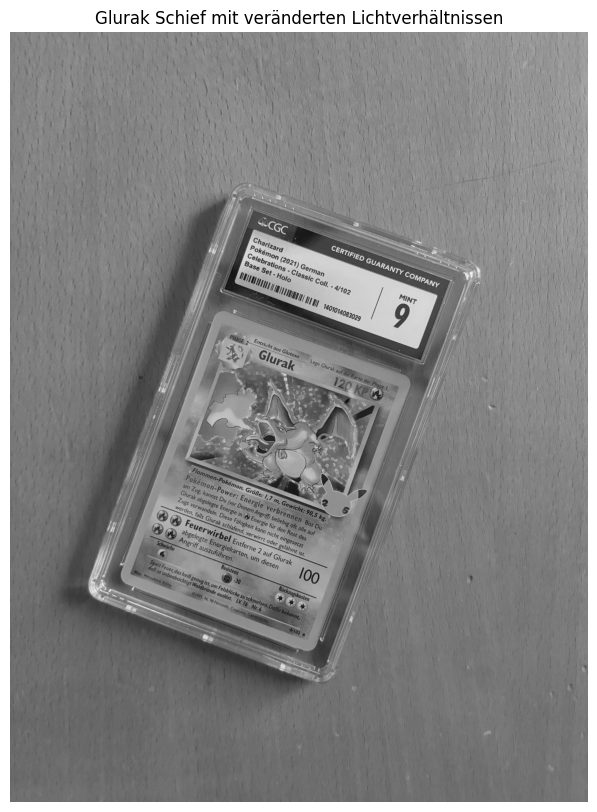

In [91]:
# plot glurak gamma schief
plt.figure(figsize=(10, 10))
plt.imshow(glurak_schief_gamma, cmap='gray')
plt.title("Glurak Schief mit veränderten Lichtverhältnissen")
plt.axis('off')
plt.show()

In [92]:
# use AKAZE to detect Keypoints
akaze = cv.AKAZE_create()
keypoints_glurak, descriptors_glurak = akaze.detectAndCompute(glurak_gamma, None)
keypoints_glurak_schief, descriptors_glurak_schief = akaze.detectAndCompute(glurak_schief_gamma, None)

In [93]:
# set the keypoints for Glurak gamma and glurak gamma schief
keypoints_img = cv.drawKeypoints(glurak_gamma, keypoints_glurak, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
keypoints_img_schief = cv.drawKeypoints(glurak_schief_gamma, keypoints_glurak_schief, None, flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)


In [94]:
matcher = cv.DescriptorMatcher_create(cv.DescriptorMatcher_BRUTEFORCE_HAMMING)
nn_matches = matcher.knnMatch(descriptors_glurak, descriptors_glurak_schief, 2)

In [95]:
matched1 = []
matched2 = []
nn_match_ratio = 0.7 # Nearest neighbor matching ratio
for m, n in nn_matches:
 if m.distance < nn_match_ratio * n.distance:
    matched1.append(keypoints_glurak[m.queryIdx])
    matched2.append(keypoints_glurak_schief[m.trainIdx])

In [96]:
# Homographie berechnen, Punkte umwandeln
if len(matched1) >= 4 and len(matched2) >= 4:
    pts1 = np.float32([kp.pt for kp in matched1])
    pts2 = np.float32([kp.pt for kp in matched2])
    homography, mask = cv.findHomography(pts1, pts2, cv.RANSAC)

inliers1 = []
inliers2 = []
good_matches = []
inlier_threshold = 2.5 # Distance threshold to identify inliers with homography check
for i, m in enumerate(matched1):
 col = np.ones((3,1), dtype=np.float64)
 col[0:2,0] = m.pt
 
 col = np.dot(homography, col)
 col /= col[2,0]
 dist = sqrt(pow(col[0,0] - matched2[i].pt[0], 2) +\
 pow(col[1,0] - matched2[i].pt[1], 2))
 
 if dist < inlier_threshold:
    good_matches.append(cv.DMatch(len(inliers1), len(inliers2), 0))
    inliers1.append(matched1[i])
    inliers2.append(matched2[i])


A-KAZE Matching Results
*******************************
# Keypoints 1: 	 11219
# Keypoints 2: 	 19490
# Matches: 	 2109
# Inliers: 	 1750
# Inliers Ratio: 	 0.8297771455666193


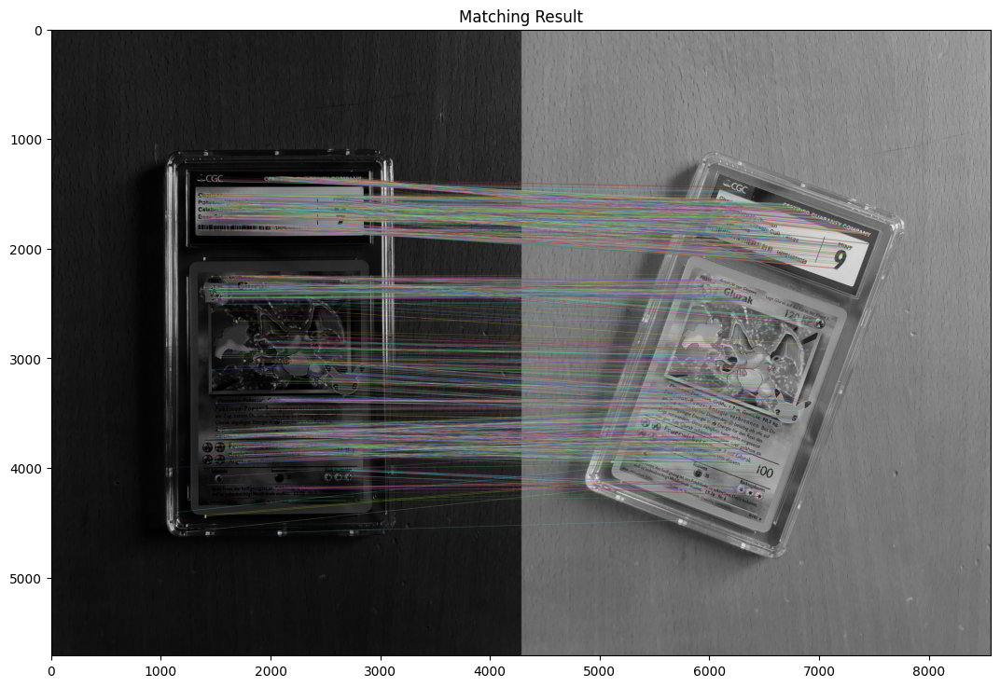

In [97]:
# Erstelle ein leeres Ergebnisbild der entsprechenden Größe
res = np.empty((max(glurak_gamma.shape[0], glurak_schief_gamma.shape[0]), glurak_gamma.shape[1] + glurak_schief_gamma.shape[1], 3), dtype=np.uint8)

# Zeichne die guten Matches auf das leere Bild 'res'
cv.drawMatches(glurak_gamma, inliers1, glurak_schief_gamma, inliers2, good_matches, res)

# Berechne das Verhältnis der Inlier-Matches zu den Gesamtmatches
inlier_ratio = len(inliers1) / float(len(matched1))

# Ausgabe der Ergebnisse
print('A-KAZE Matching Results')
print('*******************************')
print('# Keypoints 1: \t', len(keypoints_glurak))
print('# Keypoints 2: \t', len(keypoints_glurak_schief))
print('# Matches: \t', len(matched1))
print('# Inliers: \t', len(inliers1))
print('# Inliers Ratio: \t', inlier_ratio)

# Zeige das Bild im Notebook an
plt.figure(figsize=(13, 13))  # Größe des Bildes anpassen
plt.imshow(res)  # Keine Farbkonvertierung benötigt, da schon in RGB
plt.title('Matching Result')
plt.show()

# code Quelle ChatGPT



**Keypoints 1: 9006**
Dies ist die Anzahl der Schlüsselpunkte, die im ersten Bild identifiziert wurden. Schlüsselpunkte sind spezifische, erkennbare und verfolgbare Merkmale im Bild, wichtig für den Matching-Prozess.

**Keypoints 2: 19086**
Im zweiten Bild wurden deutlich mehr Schlüsselpunkte gefunden als im ersten, was auf eine höhere Detaildichte oder andere Bildbedingungen hinweisen könnte.

**Matches: 1717**
Diese Zahl zeigt, wie viele Schlüsselpunkte zwischen den beiden Bildern erfolgreich abgeglichen wurden. Weniger Matches als einzelne Keypoints zeigen, dass nicht alle Merkmale eine Entsprechung im jeweils anderen Bild haben.

**Inliers: 1404**
Von den abgeglichenen Punkten werden 1404 als Inliers betrachtet, was bedeutet, dass sie nach geometrischen Kriterien als korrekte Übereinstimmungen anerkannt wurden. Inliers sind also die Matches, die auch tatsächlich sinnvoll sind und die korrekte räumliche Beziehung beider Bilder widerspiegeln.

**Inliers Ratio: 0.8177**
Das Verhältnis von Inliers zu Gesamtmatches beträgt etwa 81.77%. Ein hoher Inliers-Ratio wie dieser deutet auf eine hohe Qualität der Matches hin, was bedeutet, dass ein großer Teil der gefundenen Übereinstimmungen zuverlässig ist.

Zusammengefasst zeigen diese Ergebnisse eine erfolgreiche, wenn auch nicht vollständige, Übereinstimmung der Merkmale zwischen den beiden Bildern mit einer relativ hohen Zuverlässigkeit der identifizierten Matches.

In [98]:
# Erstellen der nn_matches
nn_matches = matcher.knnMatch(descriptors_glurak, descriptors_glurak_schief, 2)
all_matches = []

# Filter für gute Matches basierend auf dem Nearest-Neighbor-Distance-Ratio-Test
for m, n in nn_matches:
    if m.distance < nn_match_ratio * n.distance:
        all_matches.append(m)

# Sortieren der Matches nach ihrer Distanz
all_matches = sorted(all_matches, key=lambda x: x.distance)

# Auswahl der besten 10 Matches
top_matches = all_matches[:10]  # Ändern Sie diese Zahl nach Bedarf

# code Quelle ChatGPT

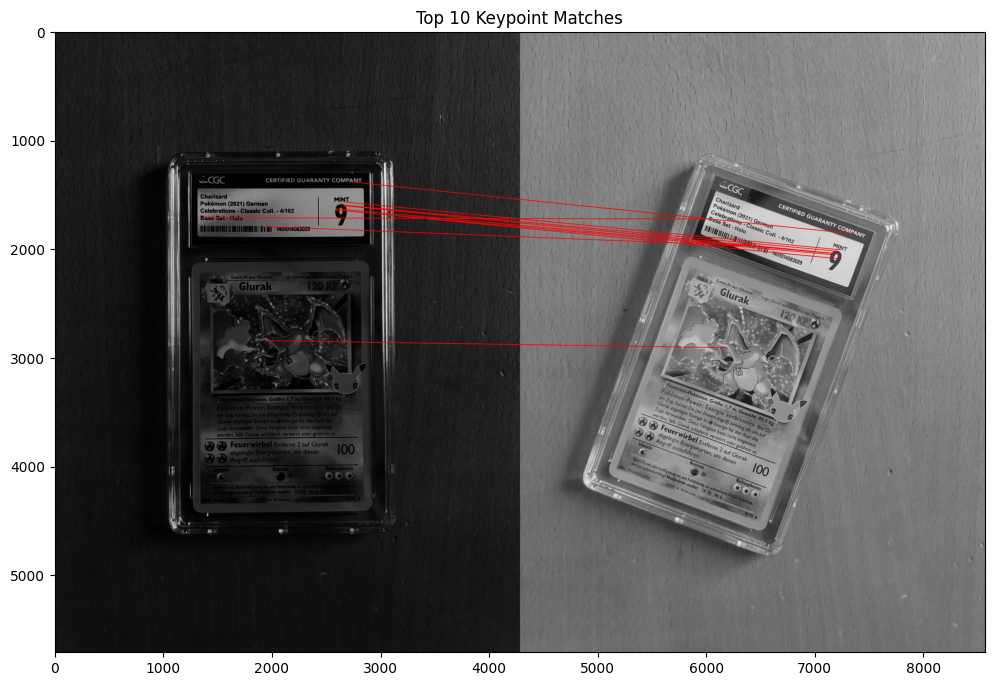

In [99]:
# Erstellen Sie ein leeres Ergebnisbild der entsprechenden Größe
height = max(glurak_gamma.shape[0], glurak_schief_gamma.shape[0])
width = glurak_gamma.shape[1] + glurak_schief_gamma.shape[1]
res = np.zeros((height, width, 3), dtype=np.uint8)

# Konvertiere Graustufenbilder zurück in BGR für die farbige Darstellung
glurak_color_gamma = cv.cvtColor(glurak_gamma, cv.COLOR_GRAY2BGR)
glurak_schief_color_gamma = cv.cvtColor(glurak_schief_gamma, cv.COLOR_GRAY2BGR)

# Setze die beiden Bilder nebeneinander im Ergebnisbild 'res'
res[:glurak_gamma.shape[0], :glurak_gamma.shape[1]] = glurak_color_gamma
res[:glurak_schief_gamma.shape[0], glurak_gamma.shape[1]:glurak_gamma.shape[1]+glurak_schief_gamma.shape[1]] = glurak_schief_color_gamma

# Zeichnen der Matches mit individueller Linienstärke
for m in top_matches:
    # Start- und Endpunkt für die Linie
    start_point = tuple(np.round(keypoints_glurak[m.queryIdx].pt).astype(int))
    end_point = tuple(np.round(keypoints_glurak_schief[m.trainIdx].pt + np.array([glurak.shape[1], 0])).astype(int))

    # Zeichne die Verbindungslinie
    cv.line(res, start_point, end_point, (255, 0, 0), thickness=5)  # Blaue Linie mit Dicke 5

    # Zeichne die Keypoints
    cv.circle(res, start_point, 4, (0, 255, 0), thickness=-1)  # Grüner Kreis
    cv.circle(res, end_point, 4, (0, 0, 255), thickness=-1)  # Roter Kreis

# Visualisierung des Ergebnisses
plt.figure(figsize=(12, 12))
plt.imshow(res)
plt.title('Top 10 Keypoint Matches')
plt.show()

# code Quelle ChatGPT

#### Erkenntnisse im Plot: 

INTERESSANT! Es ist spannend zu sehen, dass der Algorithmus nun vorallem die weissen Stellen oberhalb der Karte beim Grading verwendet um die Keypoints zu matchen. Nurnoch 1 Strich ist im Glurak selber, der der von Maul zu Maul geht. Alle anderen 9 der Top 10 Keypoints befinden sich im Grading bereich oben. Dies finde ich persönlich eine sehr clevere Methode, welche der Algorithmus AKAZE hier anwendet. 

### Robustheit: 

Der Akaze Algorithmus ist extrem Robust meiner Meinung nach. Er hat alle Transformationen handeln können. Rotation, verschiedene Lichtverhältnisse, verschiedene Gamma Werte und selbst Bilder mit verschiedenen Pokémonkarten drinn konnten äusserst akkurat gematched werden. 

## エキサイティングな日本旅行をありがとう、また会いましょう!

Vielen Dank für die spannende Reise durch Japan und bis bald!